<a href="https://colab.research.google.com/github/tiwausman/fastbook/blob/master/GASP_U_NET_efficientnetb4(SE)(4).ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import os
import numpy as np
from matplotlib import pyplot as plt
import tensorflow
from keras.optimizers import Adam
import tensorflow as tf
from datetime import datetime
import cv2
from PIL import Image
from keras import backend, optimizers


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
!pip install focal-loss

In [ ]:
"""
Attention U-net:
https://arxiv.org/pdf/1804.03999.pdf
Recurrent residual Unet (R2U-Net) paper
https://arxiv.org/ftp/arxiv/papers/1802/1802.06955.pdf
(Check fig 4.)
Note: Batch normalization should be performed over channels after a convolution,
In the following code axis is set to 3 as our inputs are of shape
[None, height, width, channel]. Channel is axis=3.
Original code from below link but heavily modified.
https://github.com/MoleImg/Attention_UNet/blob/master/AttResUNet.py
"""

import tensorflow as tf
from keras import models, layers, regularizers
from keras import backend as K



'''
A few useful metrics and losses
'''

def dice_coef(y_true, y_pred):
    y_true_f = K.flatten(y_true)
    y_pred_f = K.flatten(y_pred)
    intersection = K.sum(y_true_f * y_pred_f)
    return (2.0 * intersection + 1.0) / (K.sum(y_true_f) + K.sum(y_pred_f) + 1.0)


def jacard_coef(y_true, y_pred):
    y_true_f = K.flatten(y_true)
    y_pred_f = K.flatten(y_pred)
    intersection = K.sum(y_true_f * y_pred_f)
    return (intersection + 1.0) / (K.sum(y_true_f) + K.sum(y_pred_f) - intersection + 1.0)


def jacard_coef_loss(y_true, y_pred):
    return -jacard_coef(y_true, y_pred)


def dice_coef_loss(y_true, y_pred):
    return -dice_coef(y_true, y_pred)

In [ ]:
image_list = []
mask_directory = '/content/drive/MyDrive/A. Segmentation/2. All Segmentation Groundtruths/a. Training Set/4. Soft Exudates/'
masks = sorted(os.listdir(mask_directory))
for i, name in enumerate(masks):
    name = name[:8]+".jpg"
    image_list.append(name)

In [ ]:

import os
import numpy as np
from matplotlib import pyplot as plt
import tensorflow
from keras.optimizers import Adam
import tensorflow as tf
from datetime import datetime
import cv2
from PIL import Image
from keras import backend, optimizers


image_directory = '/content/drive/MyDrive/A. Segmentation/1. Original Images/a. Training Set/'
mask_directory = '/content/drive/MyDrive/A. Segmentation/2. All Segmentation Groundtruths/a. Training Set/4. Soft Exudates/'


SIZE = 512
image_dataset = []  #Many ways to handle data, you can use pandas. Here, we are using a list format.
mask_dataset = []  #Place holders to define add labels. We will add 0 to all parasitized images and 1 to uninfected.

images = sorted(os.listdir(image_directory))
for i, image_name in enumerate(images):    #Remember enumerate method adds a counter and returns the enumerate object
    if image_name in image_list:
        print(image_directory+image_name)
        image = cv2.imread(image_directory+image_name,1)
        # Set the crop region
        x_offset = 200  # set the offset in x direction
        y_offset = 0    # set the offset in y direction
        width = 3500    # set the width of the cropped image
        height = 2848   # set the height of the cropped image

        # Crop the image
        cropped_img = image[y_offset:y_offset+height, x_offset:x_offset+width]
                # Set the desired size for the padded image
        size = (3500, 3500,3)

        # Create a black image with the desired size
        padded_img = np.zeros(size, dtype=np.uint8)
        print(padded_img.shape)

        # Calculate the coordinates for pasting the cropped image into the padded image
        x_offset = int((size[0] - cropped_img.shape[1]) / 2)
        y_offset = int((size[1] - cropped_img.shape[0]) / 2)

        # Paste the cropped image into the padded image
        padded_img[y_offset:y_offset+cropped_img.shape[0], x_offset:x_offset+cropped_img.shape[1]] = cropped_img
        # Set the desired size for the resized image
        size = (SIZE, SIZE)

        # Extract the green channel
        green_channel = padded_img[:,:,1]

        # Apply histogram equalization
        equalized = cv2.equalizeHist(green_channel)

        # Apply CLAHE
        clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8,8))
        clahe_output = clahe.apply(green_channel)

        # Resize the image SIZES bicubic interpolation
        resized_img = cv2.resize(clahe_output, size, interpolation=cv2.INTER_CUBIC)

        image_dataset.append(np.array(resized_img))

#Iterate through all images in Uninfected folder, resize to 64 x 64
#Then save into the same numpy array 'dataset' but with label 1

masks = sorted(os.listdir(mask_directory))
for i, image_name in enumerate(masks):
    if (image_name.split('.')[1] == 'tif'):
        print(mask_directory+image_name)
        image = cv2.imread(mask_directory+image_name,0)
        # Set the crop region
        x_offset = 200  # set the offset in x direction
        y_offset = 0    # set the offset in y direction
        width = 3500    # set the width of the cropped image
        height = 2848   # set the height of the cropped image

        # Crop the image
        cropped_img = image[y_offset:y_offset+height, x_offset:x_offset+width]
                # Set the desired size for the padded image
        size = (3500, 3500)

        # Create a black image with the desired size
        padded_img = np.zeros(size, dtype=np.uint8)
        print(padded_img.shape)

        # Calculate the coordinates for pasting the cropped image into the padded image
        x_offset = int((size[0] - cropped_img.shape[1]) / 2)
        y_offset = int((size[1] - cropped_img.shape[0]) / 2)

        # Paste the cropped image into the padded image
        padded_img[y_offset:y_offset+cropped_img.shape[0], x_offset:x_offset+cropped_img.shape[1]] = cropped_img
        # Set the desired size for the resized image
        size = (SIZE, SIZE)

        # Resize the image SIZES bicubic interpolation
        resized_img = cv2.resize(padded_img, size, interpolation=cv2.INTER_CUBIC)
        mask_dataset.append(np.array(resized_img))


#Normalize images
image_dataset = np.stack((image_dataset,)*3, axis=-1)
image_dataset = np.array(image_dataset)/255.
print(1)
#D not normalize masks, just rescale to 0 to 1.
# Calculate the mean value of the image
mean_value = np.mean(image_dataset)
print(2)


print(3)
mask_dataset = np.expand_dims((np.array(mask_dataset)),3) /255.
mask_dataset = np.where(mask_dataset  >= 0.003, 1.0, 0.0)

print(image_dataset.shape)
print(mask_dataset.shape)
print("Pixel values in the mask are: ", np.unique(mask_dataset))

/content/drive/MyDrive/A. Segmentation/1. Original Images/a. Training Set/IDRiD_03.jpg
(3500, 3500, 3)
/content/drive/MyDrive/A. Segmentation/1. Original Images/a. Training Set/IDRiD_08.jpg
(3500, 3500, 3)
/content/drive/MyDrive/A. Segmentation/1. Original Images/a. Training Set/IDRiD_13.jpg
(3500, 3500, 3)
/content/drive/MyDrive/A. Segmentation/1. Original Images/a. Training Set/IDRiD_14.jpg
(3500, 3500, 3)
/content/drive/MyDrive/A. Segmentation/1. Original Images/a. Training Set/IDRiD_17.jpg
(3500, 3500, 3)
/content/drive/MyDrive/A. Segmentation/1. Original Images/a. Training Set/IDRiD_18.jpg
(3500, 3500, 3)
/content/drive/MyDrive/A. Segmentation/1. Original Images/a. Training Set/IDRiD_19.jpg
(3500, 3500, 3)
/content/drive/MyDrive/A. Segmentation/1. Original Images/a. Training Set/IDRiD_22.jpg
(3500, 3500, 3)
/content/drive/MyDrive/A. Segmentation/1. Original Images/a. Training Set/IDRiD_23.jpg
(3500, 3500, 3)
/content/drive/MyDrive/A. Segmentation/1. Original Images/a. Training Set

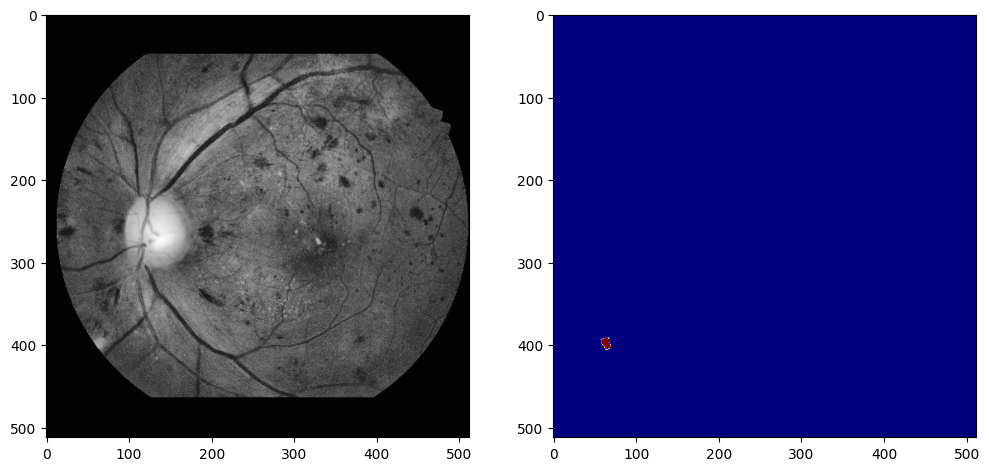

In [ ]:


from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(image_dataset, mask_dataset, test_size = 0.50, random_state = 0)

#Sanity check, view few mages
import random
import numpy as np
image_number = random.randint(0, len(X_train))
plt.figure(figsize=(12, 6))
plt.subplot(121)
plt.imshow(np.reshape(X_train[image_number], (SIZE, SIZE, 3)), cmap='gray')
plt.subplot(122)
plt.imshow(np.reshape(y_train[image_number], (SIZE, SIZE)), cmap='jet')
plt.show()

#######################################
#Parameters for model

IMG_HEIGHT = X_train.shape[1]
IMG_WIDTH  = X_train.shape[2]
IMG_CHANNELS = X_train.shape[3]
num_labels = 1  #Binary
input_shape = (IMG_HEIGHT,IMG_WIDTH,IMG_CHANNELS)
batch_size = 4

#FOCAL LOSS AND DICE METRIC
#Focal loss helps focus more on tough to segment classes.
from focal_loss import BinaryFocalLoss

In [ ]:

from tensorflow.keras.layers import Conv2D, BatchNormalization, Activation, MaxPool2D, Conv2DTranspose, Concatenate, Input, Lambda ,concatenate
from tensorflow.keras.models import Model
from tensorflow.keras.applications import EfficientNetB4

import tensorflow as tf
from keras import models, layers, regularizers
from keras import backend as K


def conv_block(input, num_filters):
    x = Conv2D(num_filters, 3, padding="same")(input)
    x = BatchNormalization()(x)
    x = Activation("relu")(x)

    x = Conv2D(num_filters, 3, padding="same")(x)
    x = BatchNormalization()(x)
    x = Activation("relu")(x)

    return x

def gating_signal(input, out_size, batch_norm=True):
    """
    resize the down layer feature map into the same dimension as the up layer feature map
    using 1x1 conv
    :return: the gating feature map with the same dimension of the up layer feature map
    """
    x = layers.Conv2D(out_size, (1, 1), padding='same')(input)
    if batch_norm:
        x = layers.BatchNormalization()(x)
    x = layers.Activation('relu')(x)
    return x

def attention_block(x, gating, inter_shape):
    shape_x = K.int_shape(x)
    shape_g = K.int_shape(gating)

# Getting the x signal to the same shape as the gating signal
    theta_x = layers.Conv2D(inter_shape, (2, 2), strides=(2, 2), padding='same')(x)  # 16
    shape_theta_x = K.int_shape(theta_x)

# Getting the gating signal to the same number of filters as the inter_shape
    phi_g = layers.Conv2D(inter_shape, (1, 1), padding='same')(gating)
    upsample_g = layers.Conv2DTranspose(inter_shape, (3, 3),
                                 strides=(shape_theta_x[1] // shape_g[1], shape_theta_x[2] // shape_g[2]),
                                 padding='same')(phi_g)  # 16

    concat_xg = layers.add([upsample_g, theta_x])
    act_xg = layers.Activation('relu')(concat_xg)
    psi = layers.Conv2D(1, (1, 1), padding='same')(act_xg)
    sigmoid_xg = layers.Activation('sigmoid')(psi)
    shape_sigmoid = K.int_shape(sigmoid_xg)
    upsample_psi = layers.UpSampling2D(size=(shape_x[1] // shape_sigmoid[1], shape_x[2] // shape_sigmoid[2]))(sigmoid_xg)  # 32

    upsample_psi = repeat_elem(upsample_psi, shape_x[3])

    y = layers.multiply([upsample_psi, x])

    result = layers.Conv2D(shape_x[3], (1, 1), padding='same')(y)
    result_bn = layers.BatchNormalization()(result)
    return result_bn
def repeat_elem(tensor, rep):
    # lambda function to repeat Repeats the elements of a tensor along an axis
    #by a factor of rep.
    # If tensor has shape (None, 256,256,3), lambda will return a tensor of shape
    #(None, 256,256,6), if specified axis=3 and rep=2.

     return layers.Lambda(lambda x, repnum: K.repeat_elements(x, repnum, axis=3),
                          arguments={'repnum': rep})(tensor)

def res_conv_block(x, filter_size, size, dropout=0.5, batch_norm=True):
    '''
    Residual convolutional layer.
    Two variants....
    Either put activation function before the addition with shortcut
    or after the addition (which would be as proposed in the original resNet).

    1. conv - BN - Activation - conv - BN - Activation
                                          - shortcut  - BN - shortcut+BN

    2. conv - BN - Activation - conv - BN
                                     - shortcut  - BN - shortcut+BN - Activation

    Check fig 4 in https://arxiv.org/ftp/arxiv/papers/1802/1802.06955.pdf
    '''

    conv = layers.Conv2D(size, (filter_size, filter_size), padding='same')(x)
    if batch_norm is True:
        conv = layers.BatchNormalization(axis=3)(conv)
    conv = layers.Activation('relu')(conv)

    conv = layers.Conv2D(size, (filter_size, filter_size), padding='same')(conv)
    if batch_norm is True:
        conv = layers.BatchNormalization(axis=3)(conv)
    #conv = layers.Activation('relu')(conv)    #Activation before addition with shortcut
    if dropout > 0:
        conv = layers.Dropout(dropout)(conv)

    shortcut = layers.Conv2D(size, kernel_size=(1, 1), padding='same')(x)
    if batch_norm is True:
        shortcut = layers.BatchNormalization(axis=3)(shortcut)

    res_path = layers.add([shortcut, conv])
    res_path = layers.Activation('relu')(res_path)    #Activation after addition with shortcut (Original residual block)
    return res_path
def decoder_block(input, skip_features, FILTER_NUM):
   # network structure

    FILTER_SIZE = 3 # size of the convolutional filter
    UP_SAMP_SIZE = 2 # size of upsampling filters
    gating = gating_signal(input, FILTER_NUM)
    att = attention_block(skip_features, gating, FILTER_NUM)
    up = layers.UpSampling2D(size=(UP_SAMP_SIZE, UP_SAMP_SIZE), data_format="channels_last")(input)
    print(up.shape, att.shape)
    up = layers.concatenate([up, att], axis=3)
    up_conv = conv_block(up,FILTER_NUM)
    return up_conv
def decoder2(input, skip_features, num_filters):
    x = Conv2DTranspose(num_filters, (2, 2), strides=2, padding="same")(input)
    x = Concatenate()([x, skip_features])
    x = conv_block(x, num_filters)
    return x
def SubpixelUpsampling(x, y):
    depth = tf.keras.backend.int_shape(x)[-1]
    def depth_to_space(x):
          return tf.nn.depth_to_space(x, 2)
    x = Conv2D(filters=depth*2, kernel_size=(1,1), strides=1, padding='same', )(x)
    x = Lambda(depth_to_space)(x)
    x = concatenate([x, y])
    return x

def build_effienet_unet(input_shape):
    """ Input """
    inputs = Input(input_shape)

    """ Pre-trained Encoder """
    encoder = EfficientNetB4(include_top=False, weights="imagenet", input_tensor=inputs)

    s1 = encoder.get_layer("input_1").output                      ## 256
    s2 = encoder.get_layer("block2a_expand_activation").output    ## 128
    s3 = encoder.get_layer("block3a_expand_activation").output    ## 64
    s4 = encoder.get_layer("block4a_expand_activation").output    ## 32

    """ Bottleneck """
    b1 = encoder.get_layer("block6a_expand_activation").output    ## 16

    """ Decoder """
    d1 = SubpixelUpsampling(b1, s4)
    d1 = decoder_block(b1, s4, 512)                     ## (64 x 64)
    d2 = SubpixelUpsampling(d1, s3,)
    d2 = decoder_block(d1, s3, 256)                    ## (128 x 128)
    d3 = SubpixelUpsampling(d2, s2,)
    d3 = decoder_block(d2, s2, 128)                     ## (256 x 256)
    d4 = SubpixelUpsampling(d3, s1, )
    d4 = decoder_block(d3, s1, 64)
    """ Output """
    outputs = Conv2D(1, 1, padding="same", activation="sigmoid")(d4)

    model = Model(inputs, outputs, name="EfficientNetB0_UNET")
    return model


In [ ]:
%env SM_FRAMEWORK=tf.keras

env: SM_FRAMEWORK=tf.keras


In [ ]:
!pip install segmentation_models

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 50.7/50.7 kB 2.6 MB/s eta 0:00:00


In [ ]:
import tensorflow as tf
import segmentation_models as sm
import glob
import cv2
import os
import numpy as np
from matplotlib import pyplot as plt
import keras

from keras.utils import normalize
from keras.metrics import MeanIoU

Segmentation Models: using `tf.keras` framework.


In [ ]:
BACKBONE2 = 'resnet50'
preprocess_input2 = sm.get_preprocessing(BACKBONE2)

# preprocess input
X_train2 = preprocess_input2(X_train)
X_test2 = preprocess_input2(X_test)

In [ ]:


X_train2.shape

(20, 512, 512, 3)

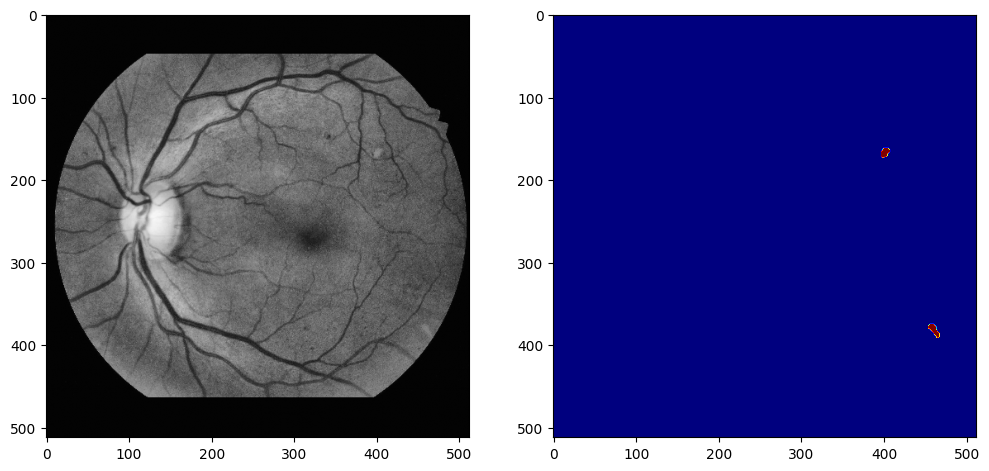

In [ ]:
#Sanity check, view few mages
import random
import numpy as np
image_number = random.randint(0, len(X_train2))
plt.figure(figsize=(12, 6))
plt.subplot(121)
plt.imshow(np.reshape(X_train2[image_number], (SIZE, SIZE, 3)), cmap='gray')
plt.subplot(122)
plt.imshow(np.reshape(y_train[image_number], (SIZE, SIZE)), cmap='jet')
plt.show()

In [ ]:

#New generator with rotation and shear where interpolation that comes with rotation and shear are thresholded in masks.
#This gives a binary mask rather than a mask with interpolated values.
seed=24
from keras.preprocessing.image import ImageDataGenerator
img_data_gen_args = dict(
    rotation_range=10,
    zoom_range=(1.0, 1.1),
    vertical_flip=True,
    horizontal_flip=True,)

mask_data_gen_args = dict(
    rotation_range=10,
    zoom_range=(1.0, 1.1),
    vertical_flip=True,
    horizontal_flip=True,
    preprocessing_function=lambda x: np.where(x > 0, 1, 0).astype(x.dtype))

In [ ]:
image_data_generator = ImageDataGenerator(**img_data_gen_args)
image_data_generator.fit(X_train, augment=True, seed=seed)

image_generator = image_data_generator.flow(X_train, seed=seed)
valid_img_generator = image_data_generator.flow(X_test2, seed=seed)

mask_data_generator = ImageDataGenerator(**mask_data_gen_args)
mask_data_generator.fit(y_train, augment=True, seed=seed)
mask_generator = mask_data_generator.flow(y_train, seed=seed)
valid_mask_generator = mask_data_generator.flow(y_test, seed=seed)

def my_image_mask_generator(image_generator, mask_generator):
    train_generator = zip(image_generator, mask_generator)
    for (img, mask) in train_generator:
        yield (img, mask)

my_generator = my_image_mask_generator(image_generator, mask_generator)

validation_datagen = my_image_mask_generator(valid_img_generator, valid_mask_generator)

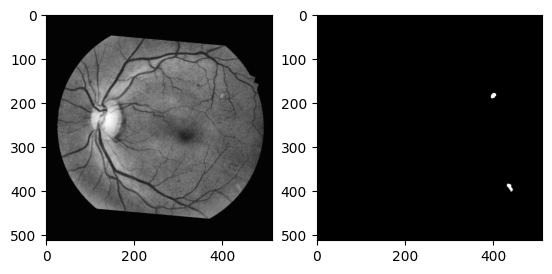

In [ ]:
x = image_generator.next()
y = mask_generator.next()
for i in range(0,1):
    image = x[i]
    mask = y[i]
    plt.subplot(1,2,1)
    plt.imshow(image[:,:,0], cmap='gray')
    plt.subplot(1,2,2)
    plt.imshow(mask[:,:,0],cmap='gray')
    plt.show()

In [ ]:
import tensorflow.keras.backend as K

def weighted_binary_crossentropy(y_true, y_pred):
    # Define the class weights
    class_weights = K.variable([0.01, 0.99])  # assuming the background class is more prevalent

    # Calculate the weighted binary cross-entropy loss
    b_ce = K.binary_crossentropy(y_true, y_pred)
    w_b_ce = K.mean(class_weights * b_ce)

    return w_b_ce


from focal_loss import BinaryFocalLoss

In [ ]:
total_loss = sm.losses.binary_focal_dice_loss # or sm.losses.categorical_focal_dice_loss

metrics = [sm.metrics.IOUScore(threshold=0.5), sm.metrics.FScore(threshold=0.5)]

In [ ]:
build_resnet50_unet_model = build_effienet_unet(input_shape)
build_resnet50_unet_model.compile(optimizer=Adam(lr = 1e-4), loss=total_loss,
              metrics=metrics)


print(build_resnet50_unet_model.summary())


71686520/71686520 [==============================] - 0s 0us/step
(None, 64, 64, 960) (None, 64, 64, 336)
(None, 128, 128, 512) (None, 128, 128, 192)
(None, 256, 256, 256) (None, 256, 256, 144)
(None, 512, 512, 128) (None, 512, 512, 3)
Model: "EfficientNetB0_UNET"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 512, 512, 3  0           []                               
                                )]                                                                
                                                                                                  
 rescaling (Rescaling)          (None, 512, 512, 3)  0           ['input_1[0][0]']                
                                                                                                  
 normalization (Normalization)  (None, 512,

/usr/local/lib/python3.10/dist-packages/keras/optimizers/legacy/adam.py:117: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super().__init__(name, **kwargs)


 block2c_se_reduce (Conv2D)     (None, 1, 1, 8)      1544        ['block2c_se_reshape[0][0]']     
                                                                                                  
 block2c_se_expand (Conv2D)     (None, 1, 1, 192)    1728        ['block2c_se_reduce[0][0]']      
                                                                                                  
 block2c_se_excite (Multiply)   (None, 128, 128, 19  0           ['block2c_activation[0][0]',     
                                2)                                'block2c_se_expand[0][0]']      
                                                                                                  
 block2c_project_conv (Conv2D)  (None, 128, 128, 32  6144        ['block2c_se_excite[0][0]']      
                                )                                                                 
                                                                                                  
 block2c_p

In [ ]:
print(tf. __version__)

2.12.0


In [ ]:
from tensorflow.keras.callbacks import EarlyStopping, ReduceLROnPlateau
earlystopping = EarlyStopping(
  monitor='val_loss',
  min_delta=0,
  patience=10,
  verbose=1,
  restore_best_weights=True)

reducelr = ReduceLROnPlateau(
  monitor='val_loss',
  factor=0.1,
  patience=3,
  verbose=1,
  min_delta=0.0001 )

callbacks = [earlystopping, reducelr]
steps_per_epoch = 3*(len(X_train))//batch_size

In [ ]:
start1 = datetime.now()
build_resnet50_unet_history = build_resnet50_unet_model.fit(X_train2, y_train , validation_data=(X_test2, y_test),batch_size = 4,verbose=1,
                    shuffle=False,
                    epochs=200,callbacks = callbacks)


stop1 = datetime.now()
#Execution time of the model
execution_time_Unet = stop1-start1
print("UNet execution time is: ", execution_time_Unet)


# convert the history.history dict to a pandas DataFrame and save as csv for
# future plotting
import pandas as pd
build_resnet50_unet_history_df = pd.DataFrame(build_resnet50_unet_history.history)
with open('resnet50_unet_history_df4.csv', mode='w') as f:
    build_resnet50_unet_history_df.to_csv(f)

Epoch 1/200
5/5 [==============================] - 70s 3s/step - loss: 1.2479 - iou_score: 0.0037 - f1-score: 0.0073 - val_loss: 1.1347 - val_iou_score: 0.0046 - val_f1-score: 0.0091 - lr: 1.0000e-04
Epoch 2/200
5/5 [==============================] - 10s 2s/step - loss: 1.0813 - iou_score: 0.0082 - f1-score: 0.0162 - val_loss: 1.1258 - val_iou_score: 0.0048 - val_f1-score: 0.0096 - lr: 1.0000e-04
Epoch 3/200
5/5 [==============================] - 9s 2s/step - loss: 1.0299 - iou_score: 0.0101 - f1-score: 0.0199 - val_loss: 1.1147 - val_iou_score: 4.2415e-04 - val_f1-score: 8.4650e-04 - lr: 1.0000e-04
Epoch 4/200
5/5 [==============================] - 10s 2s/step - loss: 1.0109 - iou_score: 0.0593 - f1-score: 0.1087 - val_loss: 1.1087 - val_iou_score: 3.9140e-10 - val_f1-score: 3.9140e-10 - lr: 1.0000e-04
Epoch 5/200
5/5 [==============================] - 10s 2s/step - loss: 1.0004 - iou_score: 0.2314 - f1-score: 0.3671 - val_loss: 1.1044 - val_iou_score: 5.4540e-10 - val_f1-score: 5.454

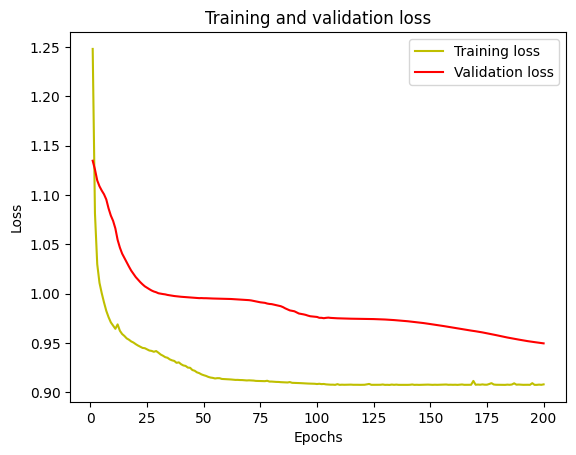

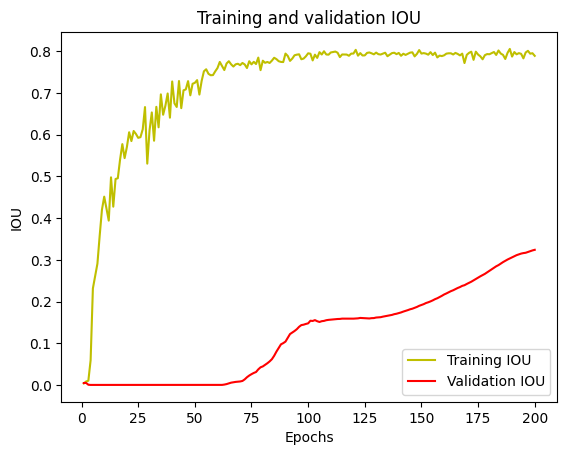

In [ ]:

###
#plot the training and validation accuracy and loss at each epoch

history = build_resnet50_unet_history
loss = history.history['loss']
val_loss = history.history['val_loss']
epochs = range(1, len(loss) + 1)
plt.plot(epochs, loss, 'y', label='Training loss')
plt.plot(epochs, val_loss, 'r', label='Validation loss')
plt.title('Training and validation loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.show()

acc = history.history['iou_score']
val_acc = history.history['val_iou_score']

plt.plot(epochs, acc, 'y', label='Training IOU')
plt.plot(epochs, val_acc, 'r', label='Validation IOU')
plt.title('Training and validation IOU')
plt.xlabel('Epochs')
plt.ylabel('IOU')
plt.legend()
plt.show()

# **RESULTS FOR EFFICENTNETB4 WITH IMAGES**




1/1 [==============================] - 7s 7s/step


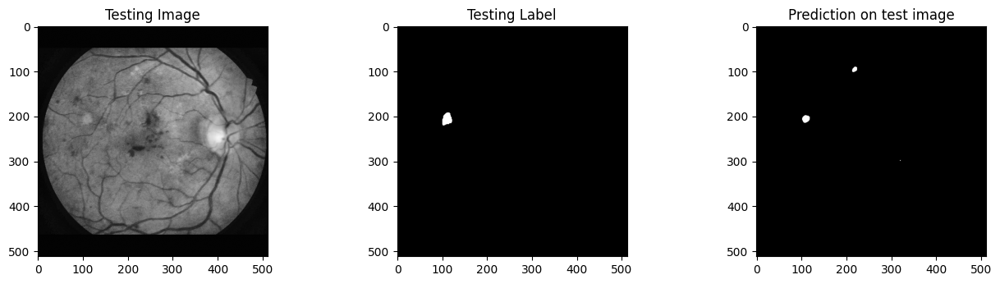

Mean IoU = 0.69236964
1/1 [==============================] - 0s 34ms/step


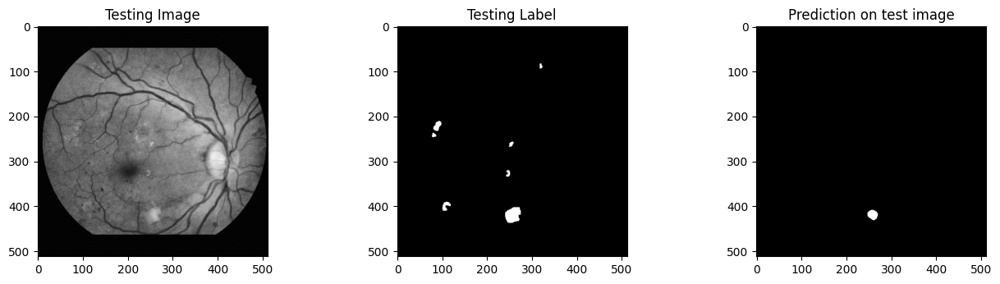

0.61227655
1/1 [==============================] - 0s 35ms/step


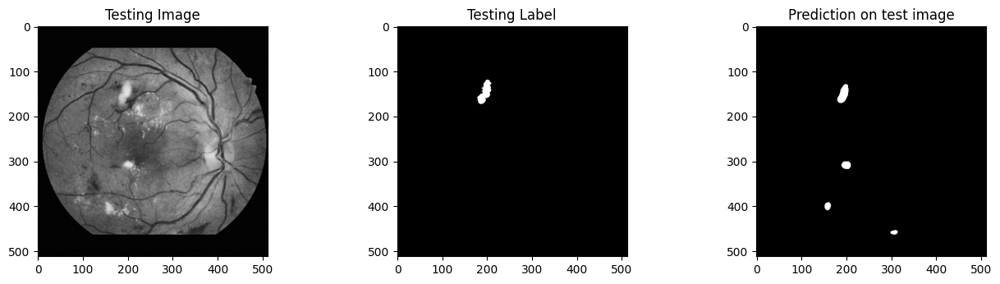

0.6982368
1/1 [==============================] - 0s 33ms/step


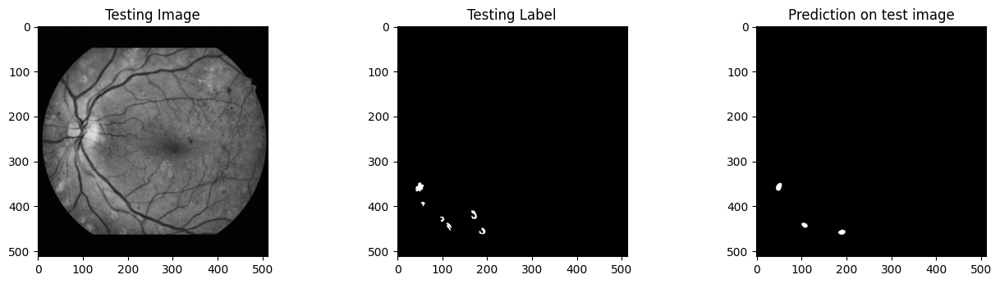

0.65181476
1/1 [==============================] - 0s 35ms/step


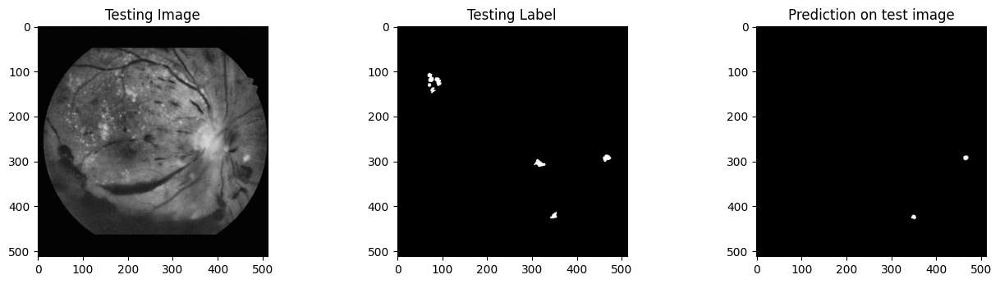

0.5722198
1/1 [==============================] - 0s 35ms/step


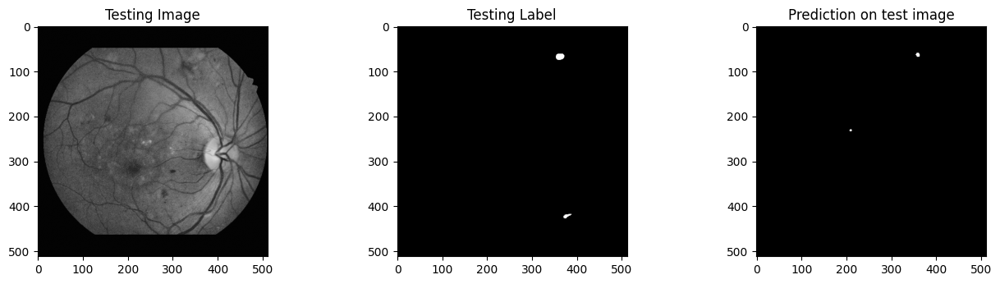

0.56784624
1/1 [==============================] - 0s 33ms/step


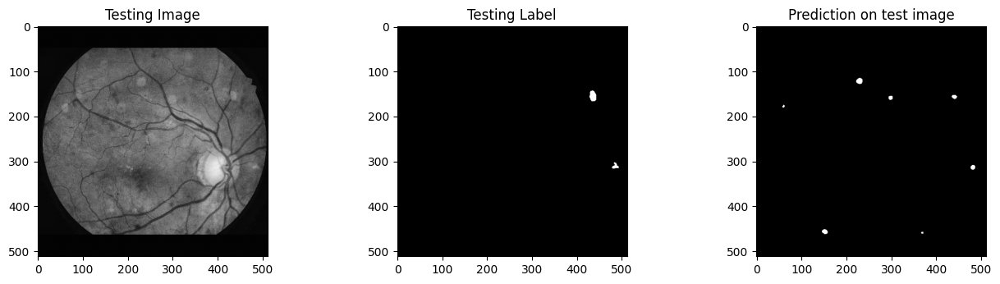

0.56601673
1/1 [==============================] - 0s 35ms/step


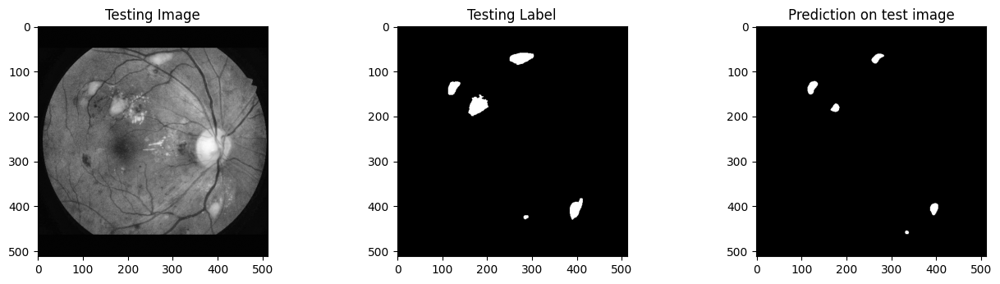

0.6781905
1/1 [==============================] - 0s 34ms/step


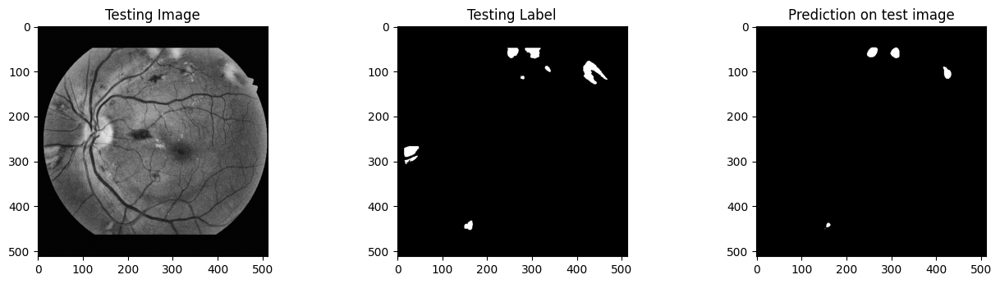

0.6523454
1/1 [==============================] - 0s 43ms/step


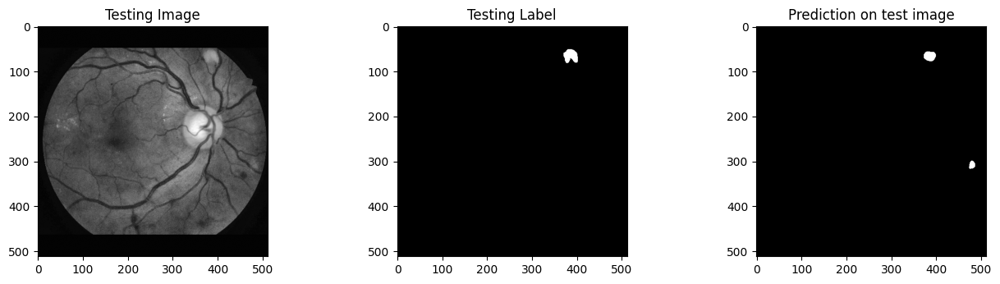

0.7303381
1/1 [==============================] - 0s 46ms/step


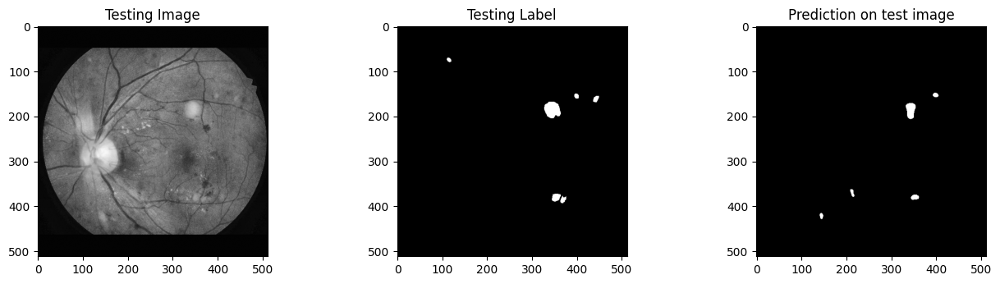

0.6990466
1/1 [==============================] - 0s 50ms/step


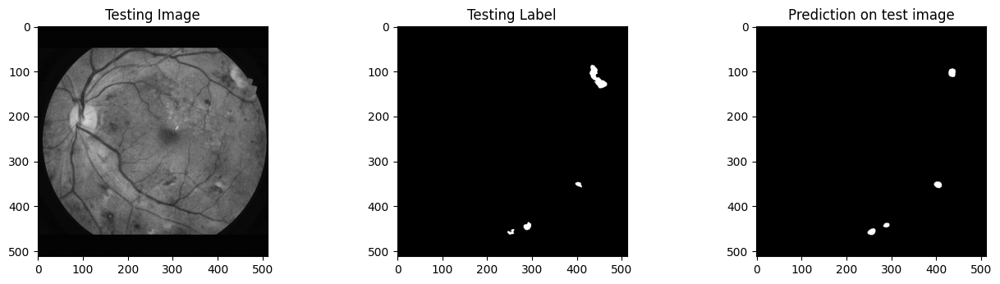

0.67497987
1/1 [==============================] - 0s 59ms/step


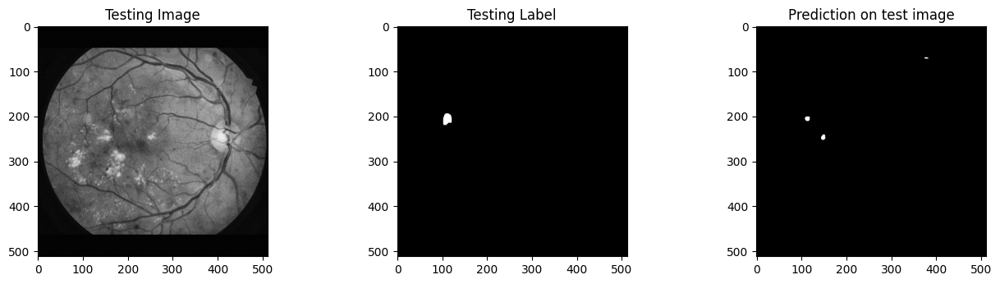

0.5911092
1/1 [==============================] - 0s 35ms/step


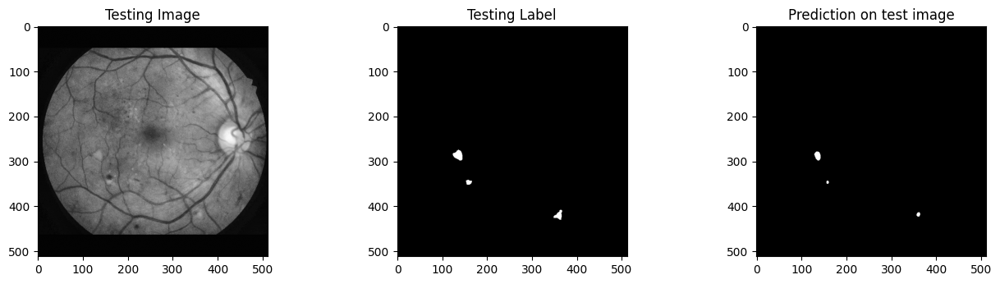

0.71425295
1/1 [==============================] - 0s 36ms/step


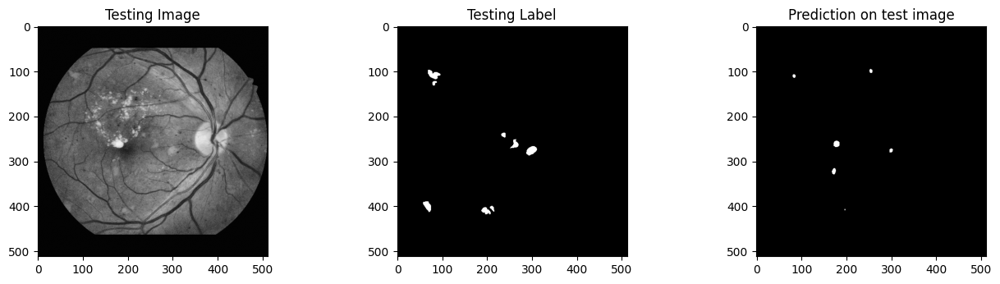

0.5247071
1/1 [==============================] - 0s 38ms/step


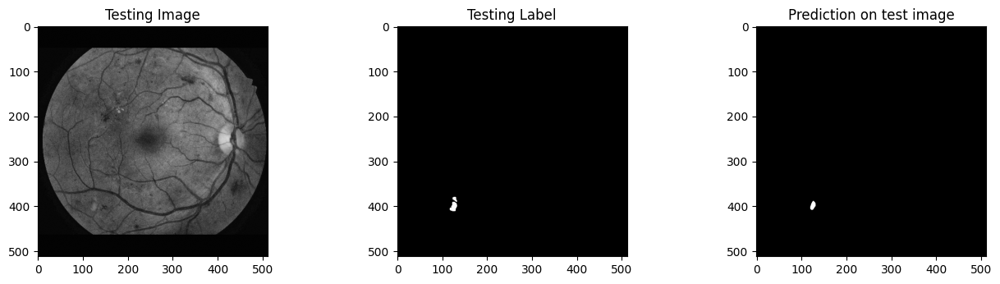

0.74413717
1/1 [==============================] - 0s 38ms/step


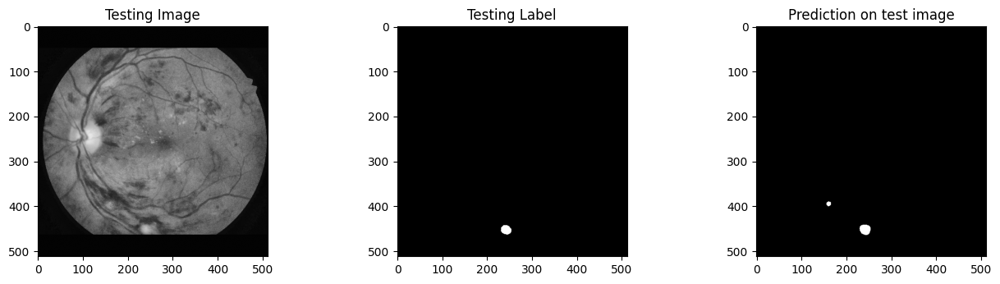

0.84959656
1/1 [==============================] - 0s 48ms/step


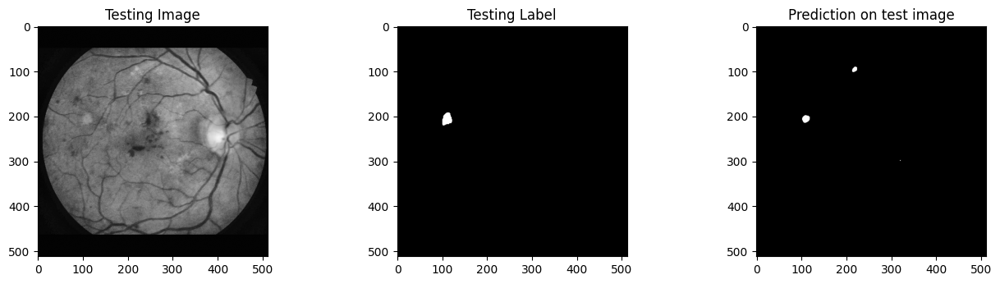

0.69236964
1/1 [==============================] - 0s 34ms/step


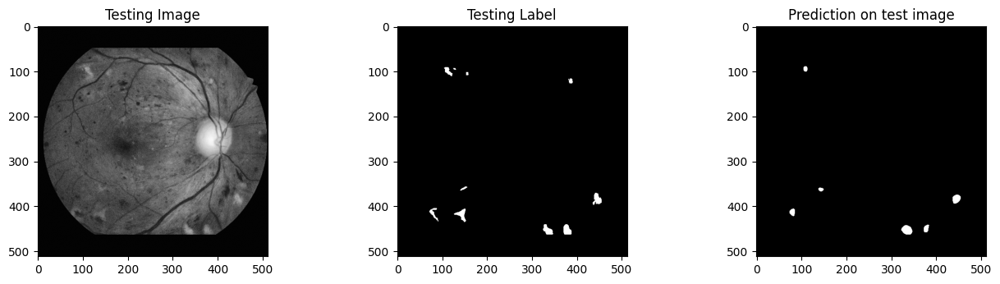

0.69370186
1/1 [==============================] - 0s 41ms/step


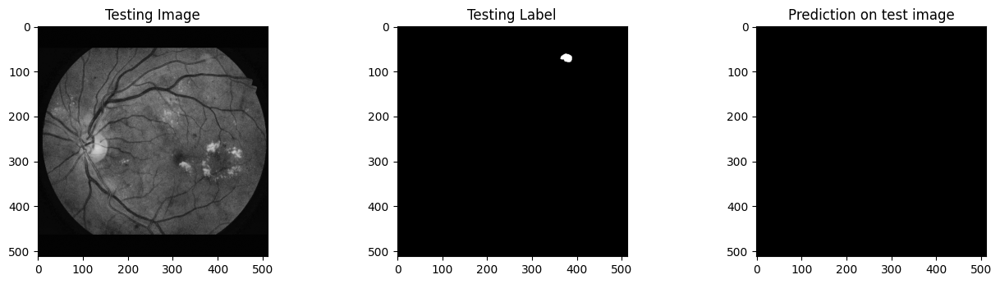

0.49932098
1/1 [==============================] - 0s 33ms/step


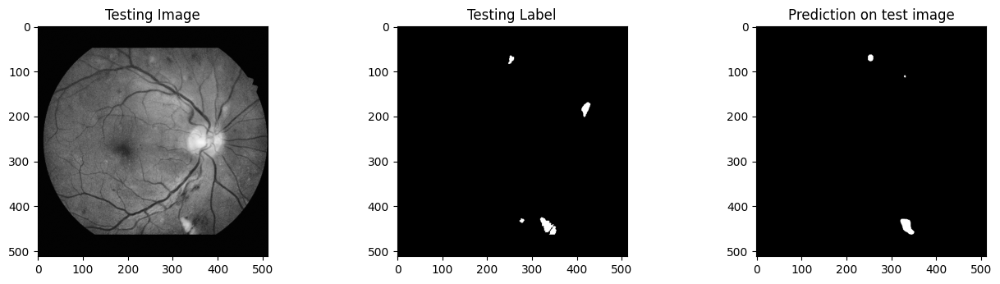

0.7234322
Mean IoU1: 0.6650852
Mean Accuracy: 0.9964412889982525
Mean Precision: [0.00464329 0.70605276 1.        ]
Mean Sensitivity: 0.4053057782858667
Mean Recall: [1.         0.40530578 0.        ]
Mean F1 Score: 0.45313666090207094
Mean Specificity: 0.9993420561766296
Mean AUC: 0.7023239172312481
Mean AUPR: 0.5571310609278443


In [ ]:
import random
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import pandas as pd
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, precision_recall_curve, auc
from sklearn import metrics


"""

"""
#Load one model at a time for testing.
model =build_resnet50_unet_model


import random
test_img_number = random.randint(0, X_test.shape[0]-1)
test_img = X_test[test_img_number]
ground_truth=y_test[test_img_number]

test_img_input=np.expand_dims(test_img, 0)
prediction = (model.predict(test_img_input)[0,:,:,0] > 0.5).astype(np.uint8)

plt.figure(figsize=(16, 8))
plt.subplot(231)
plt.title('Testing Image')
plt.imshow(test_img, cmap='gray')
plt.subplot(232)
plt.title('Testing Label')
plt.imshow(ground_truth[:,:,0], cmap='gray')
plt.subplot(233)
plt.title('Prediction on test image')
plt.imshow(prediction, cmap='gray')

plt.show()


#IoU for a single image
from keras.metrics import MeanIoU
n_classes = 2
IOU_keras = MeanIoU(num_classes=n_classes)
IOU_keras.update_state(ground_truth[:,:,0], prediction)
print("Mean IoU =", IOU_keras.result().numpy())


#Calculate IoU for all test images and average

import pandas as pd

IoU_values = []
accuracy_values = []
precision_values = []
sensitivity_values = []
sensitivity_values = []
f1_score_values = []
specificity_values = []
recall_values = []
auc_values = []
aupr_values = []

for img in range(0, X_test.shape[0]):
    temp_img = X_test[img]
    ground_truth=y_test[img]
    temp_img_input=np.expand_dims(temp_img, 0)
    prediction = (model.predict(temp_img_input)[0,:,:,0] > 0.5).astype(np.uint8)
    plt.figure(figsize=(16, 8))
    plt.subplot(231)
    plt.title('Testing Image')
    plt.imshow(temp_img, cmap='gray')
    plt.subplot(232)
    plt.title('Testing Label')
    plt.imshow(ground_truth[:,:,0], cmap='gray')
    plt.subplot(233)
    plt.title('Prediction on test image')
    plt.imshow(prediction, cmap='gray')

    plt.show()
    IoU = MeanIoU(num_classes=n_classes)
    IoU.update_state(ground_truth[:,:,0], prediction)
    IoU = IoU.result().numpy()
    print(IoU)
    if IoU >= 0.5:
      # Calculate metrics
      accuracy = accuracy_score(ground_truth[:,:,0].flatten(), prediction.flatten())
      precision = precision_score(ground_truth[:,:,0].flatten(), prediction.flatten())
      sensitivity = recall_score(ground_truth[:,:,0].flatten(), prediction.flatten())
      recall = recall_score(ground_truth[:,:,0], prediction, average='weighted', zero_division=1)
      f1 = f1_score(ground_truth[:,:,0], prediction, average='weighted', zero_division=1)
      true_negatives = np.sum((ground_truth[:,:,0] == 0) & (prediction == 0))
      false_positives = np.sum((ground_truth[:,:,0] == 0) & (prediction == 1))
      specificity = true_negatives / (true_negatives + false_positives)

      ground_truth_flat = ground_truth[:,:,0].flatten()
      prediction_flat = prediction.flatten()

      precision, recall, thresholds = precision_recall_curve(ground_truth_flat, prediction_flat)
      aupr = auc(recall, precision)
      aupr_values.append(aupr)
      # Calculate the false positive rate (fpr) and true positive rate (tpr)
      fpr, tpr, thresholds = metrics.roc_curve(ground_truth_flat, prediction_flat)

      # Calculate the Area Under the Curve (AUC)
      auc_ = metrics.auc(fpr, tpr)

      IoU_values.append(IoU)

      accuracy_values.append(accuracy)
      precision_values.append(precision)
      sensitivity_values.append(sensitivity)
      f1_score_values.append(f1)
      specificity_values.append(specificity)
      recall_values.append(recall)
      auc_values.append(auc_)

df = pd.DataFrame({
    "IoU1": IoU_values,
    "Accuracy": accuracy_values,
    "Precision": precision_values,
    "Sensitivity": sensitivity_values,
    "Recall": recall_values,
    "F1 Score": f1_score_values,
    "Specificity": specificity_values,
    "AUC": auc_values,
    "AUPR": aupr_values
})

mean_IoU1 = df["IoU1"].mean()
mean_accuracy = df["Accuracy"].mean()
mean_precision = df["Precision"].mean()
mean_sensitivity = df["Sensitivity"].mean()
mean_recall = df["Recall"].mean()
mean_f1_score = df["F1 Score"].mean()
mean_specificity = df["Specificity"].mean()
mean_auc = df["AUC"].mean()
mean_aupr = df["AUPR"].mean()

print("Mean IoU1:", mean_IoU1)
print("Mean Accuracy:", mean_accuracy)
print("Mean Precision:", mean_precision)
print("Mean Sensitivity:", mean_sensitivity)
print("Mean Recall:", mean_recall)
print("Mean F1 Score:", mean_f1_score)
print("Mean Specificity:", mean_specificity)
print("Mean AUC:", mean_auc)
print("Mean AUPR:", mean_aupr)

# **RESULTS FOR DENSENT121 WITH IMAGE**

1/1 [==============================] - 6s 6s/step


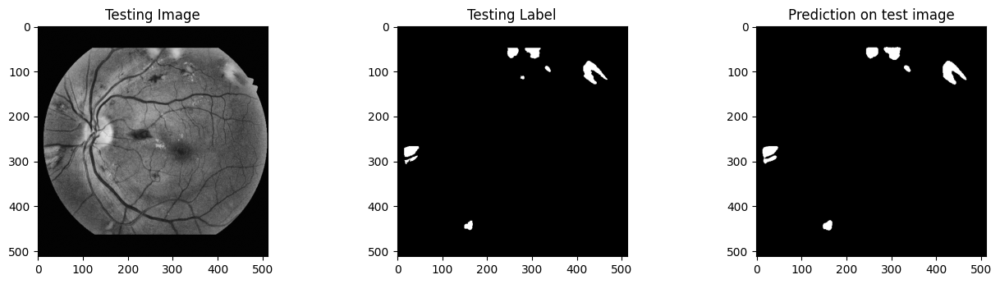

Mean IoU = 0.90664613
1/1 [==============================] - 0s 32ms/step


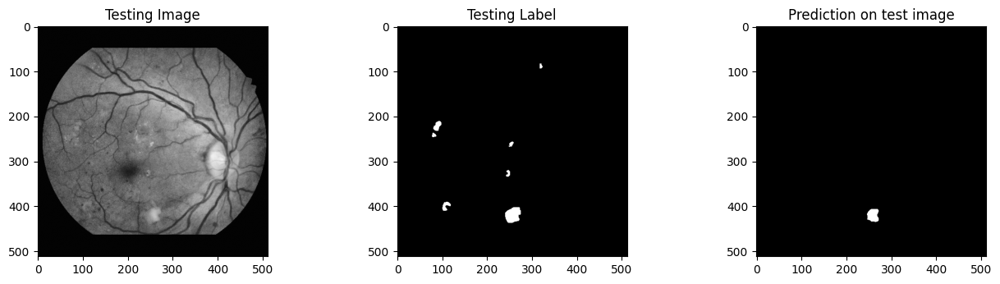

0.6732022
1/1 [==============================] - 0s 32ms/step


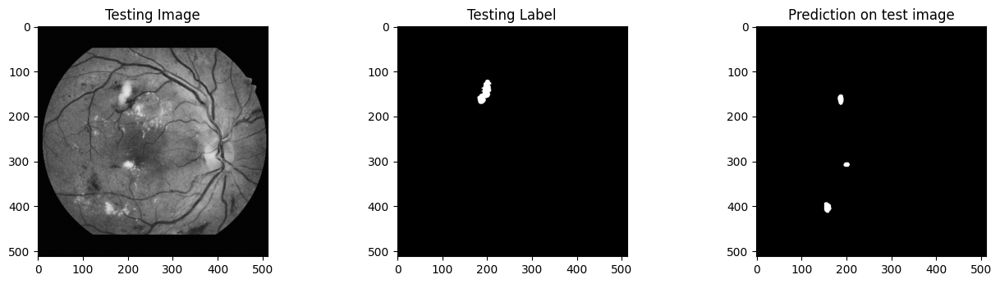

0.58249635
1/1 [==============================] - 0s 32ms/step


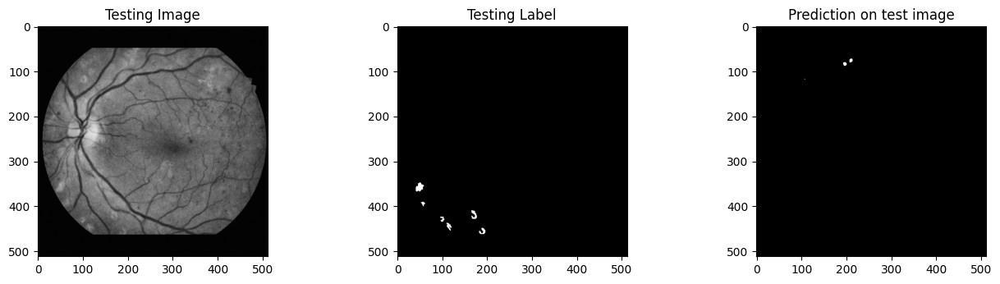

0.49847984
1/1 [==============================] - 0s 31ms/step


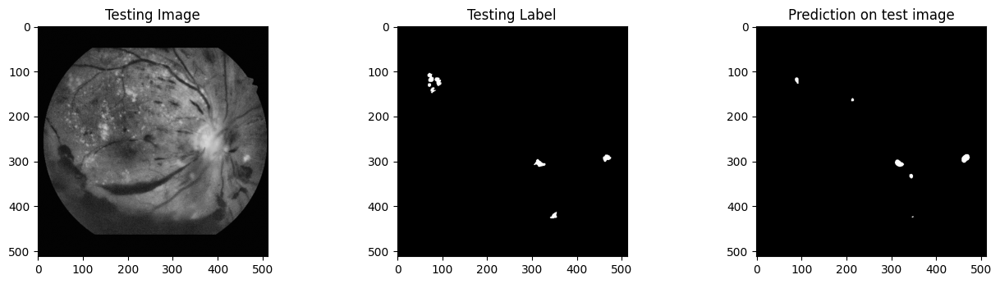

0.68469906
1/1 [==============================] - 0s 31ms/step


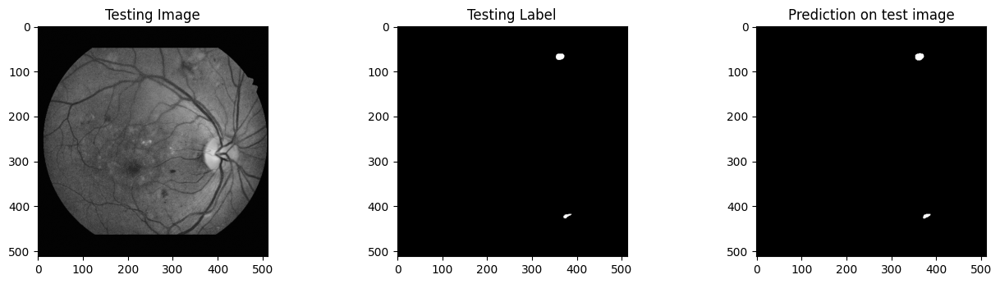

0.9331489
1/1 [==============================] - 0s 30ms/step


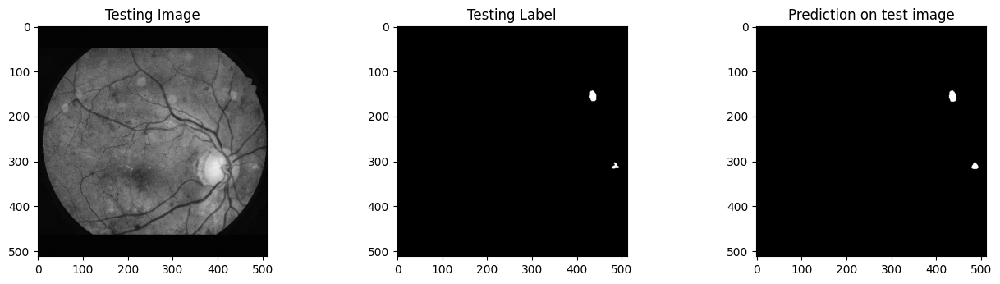

0.91208065
1/1 [==============================] - 0s 30ms/step


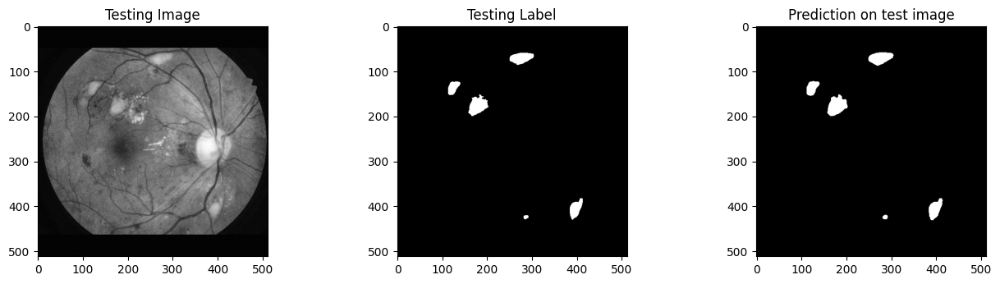

0.94503784
1/1 [==============================] - 0s 50ms/step


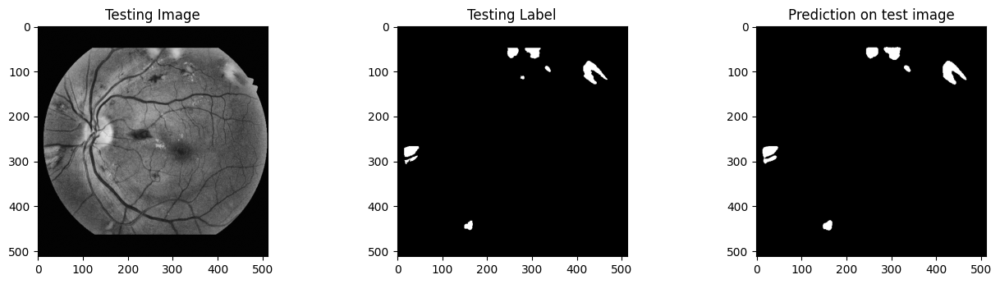

0.90664613
1/1 [==============================] - 0s 44ms/step


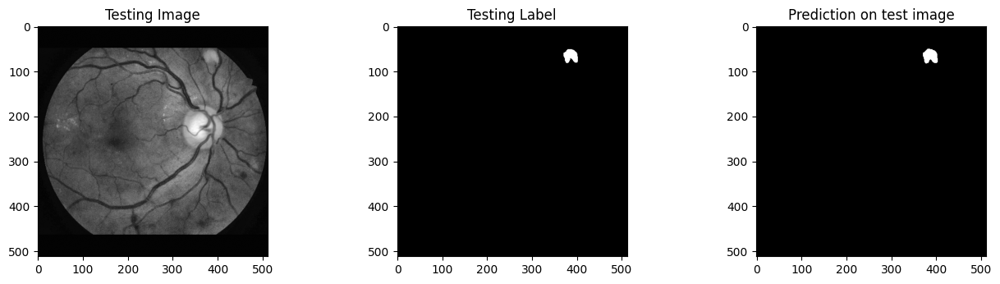

0.9487444
1/1 [==============================] - 0s 37ms/step


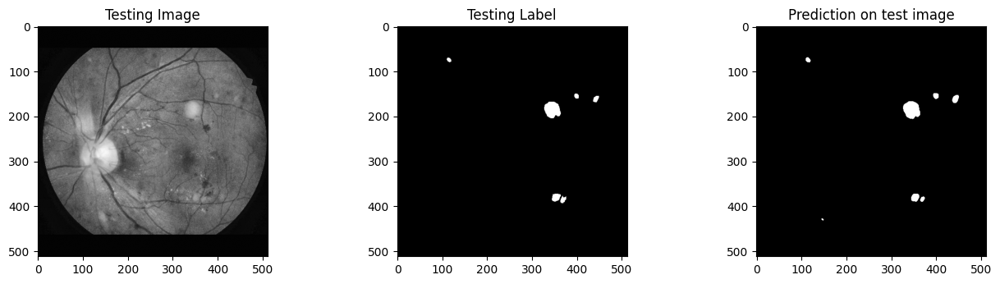

0.9132297
1/1 [==============================] - 0s 37ms/step


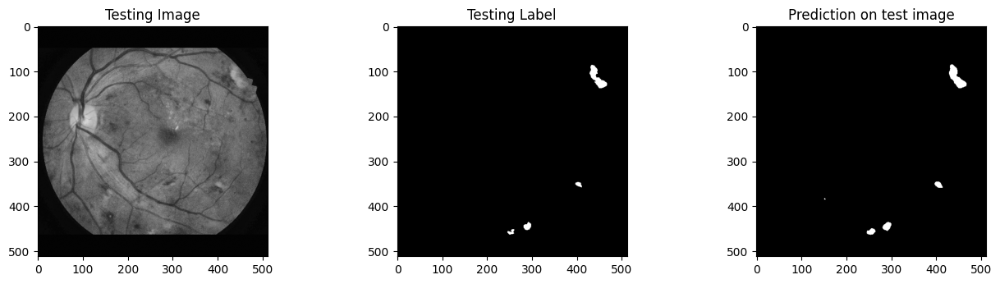

0.8926597
1/1 [==============================] - 0s 33ms/step


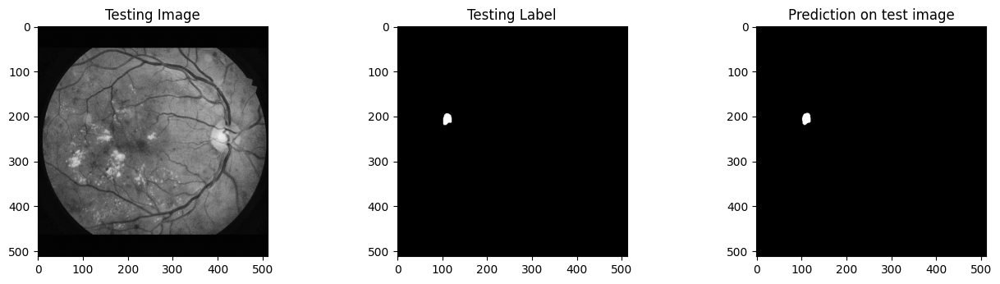

0.951962
1/1 [==============================] - 0s 33ms/step


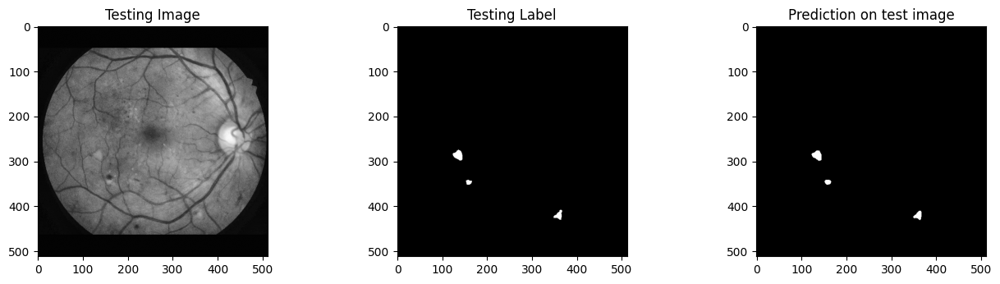

0.9406123
1/1 [==============================] - 0s 31ms/step


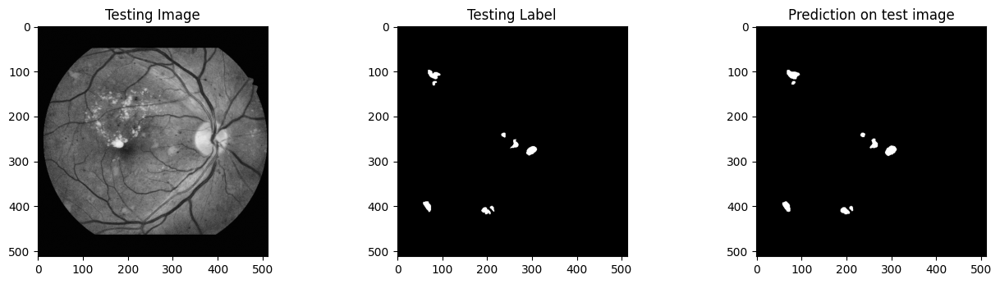

0.9148886
1/1 [==============================] - 0s 30ms/step


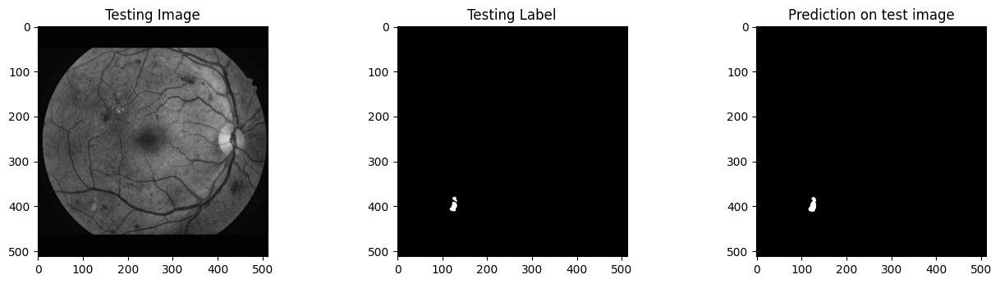

0.8982506
1/1 [==============================] - 0s 37ms/step


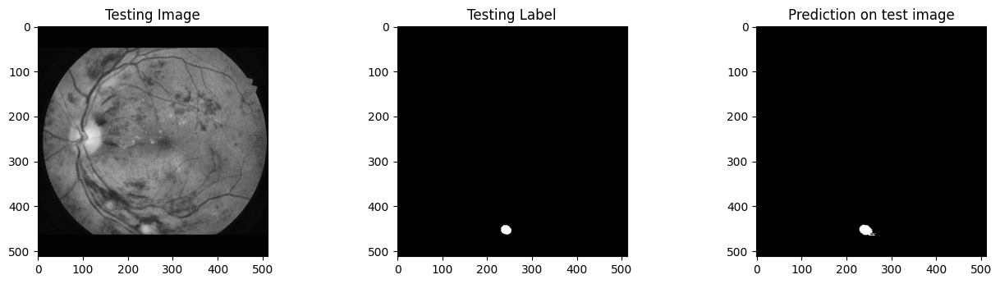

0.8622446
1/1 [==============================] - 0s 31ms/step


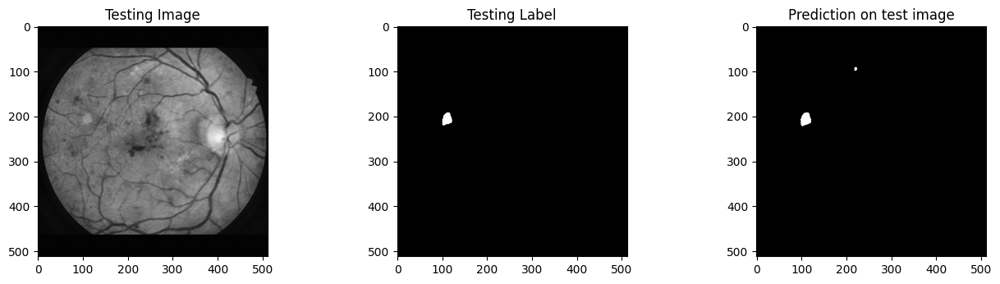

0.9058262
1/1 [==============================] - 0s 42ms/step


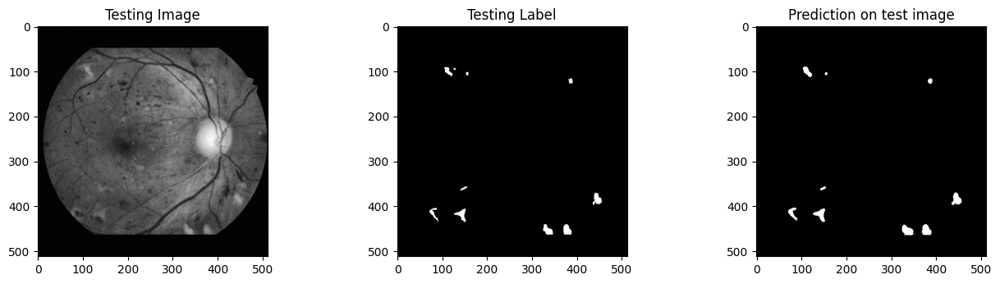

0.8844681
1/1 [==============================] - 0s 48ms/step


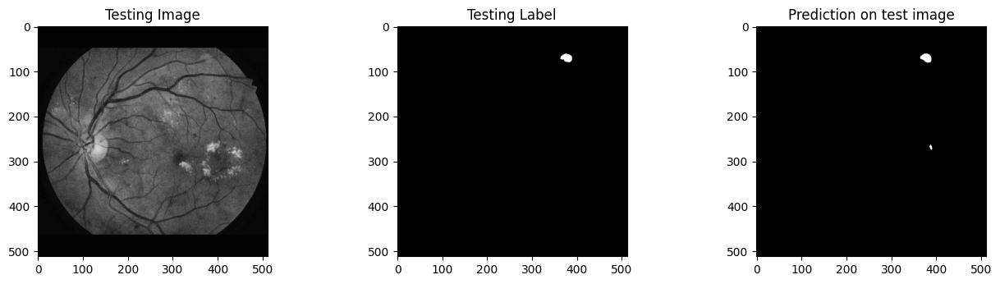

0.9081863
1/1 [==============================] - 0s 44ms/step


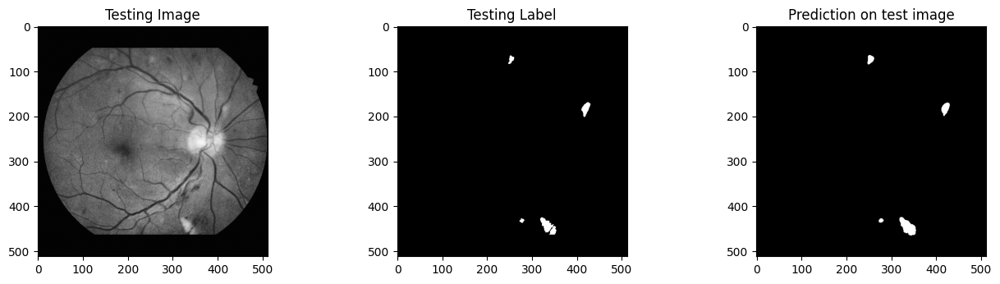

0.9049244
Mean IoU1: 0.871753
Mean Accuracy: 0.9986257051166735
Mean Precision: [0.00457583 0.81834799 1.        ]
Mean Sensitivity: 0.8795564246042378
Mean Recall: [1.         0.87955642 0.        ]
Mean F1 Score: 0.8377303660649805
Mean Specificity: 0.9991779827984408
Mean AUC: 0.9393672037013393
Mean AUPR: 0.8492312838331458


In [ ]:

import random
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
from sklearn.metrics import accuracy_score, precision_score, recall_score

from keras.models import load_model

#Load one model at a time for testing.
model = load_model('/content/drive/MyDrive/important retinafiles(SE)/DenseNet121.hdf5', compile=False)


import random
test_img_number = random.randint(0, X_test.shape[0]-1)
test_img = X_test[test_img_number]
ground_truth=y_test[test_img_number]

test_img_input=np.expand_dims(test_img, 0)
prediction = (model.predict(test_img_input)[0,:,:,0] > 0.5).astype(np.uint8)

plt.figure(figsize=(16, 8))
plt.subplot(231)
plt.title('Testing Image')
plt.imshow(test_img, cmap='gray')
plt.subplot(232)
plt.title('Testing Label')
plt.imshow(ground_truth[:,:,0], cmap='gray')
plt.subplot(233)
plt.title('Prediction on test image')
plt.imshow(prediction, cmap='gray')

plt.show()


#IoU for a single image
from keras.metrics import MeanIoU
n_classes = 2
IOU_keras = MeanIoU(num_classes=n_classes)
IOU_keras.update_state(ground_truth[:,:,0], prediction)
print("Mean IoU =", IOU_keras.result().numpy())


#Calculate IoU for all test images and average

import pandas as pd

IoU_values = []
accuracy_values = []
precision_values = []
sensitivity_values = []
sensitivity_values = []
f1_score_values = []
specificity_values = []
recall_values = []
auc_values = []
aupr_values = []

for img in range(0, X_test.shape[0]):
    temp_img = X_test[img]
    ground_truth=y_test[img]
    temp_img_input=np.expand_dims(temp_img, 0)
    prediction = (model.predict(temp_img_input)[0,:,:,0] > 0.5).astype(np.uint8)
    plt.figure(figsize=(16, 8))
    plt.subplot(231)
    plt.title('Testing Image')
    plt.imshow(temp_img, cmap='gray')
    plt.subplot(232)
    plt.title('Testing Label')
    plt.imshow(ground_truth[:,:,0], cmap='gray')
    plt.subplot(233)
    plt.title('Prediction on test image')
    plt.imshow(prediction, cmap='gray')

    plt.show()
    IoU = MeanIoU(num_classes=n_classes)
    IoU.update_state(ground_truth[:,:,0], prediction)
    IoU = IoU.result().numpy()
    print(IoU)
    if IoU >= 0.5:
      # Calculate metrics
      accuracy = accuracy_score(ground_truth[:,:,0].flatten(), prediction.flatten())
      precision = precision_score(ground_truth[:,:,0].flatten(), prediction.flatten())
      sensitivity = recall_score(ground_truth[:,:,0].flatten(), prediction.flatten())
      recall = recall_score(ground_truth[:,:,0], prediction, average='weighted', zero_division=1)
      f1 = f1_score(ground_truth[:,:,0], prediction, average='weighted', zero_division=1)
      true_negatives = np.sum((ground_truth[:,:,0] == 0) & (prediction == 0))
      false_positives = np.sum((ground_truth[:,:,0] == 0) & (prediction == 1))
      specificity = true_negatives / (true_negatives + false_positives)

      ground_truth_flat = ground_truth[:,:,0].flatten()
      prediction_flat = prediction.flatten()

      precision, recall, thresholds = precision_recall_curve(ground_truth_flat, prediction_flat)
      aupr = auc(recall, precision)
      aupr_values.append(aupr)
      # Calculate the false positive rate (fpr) and true positive rate (tpr)
      fpr, tpr, thresholds = metrics.roc_curve(ground_truth_flat, prediction_flat)

      # Calculate the Area Under the Curve (AUC)
      auc_ = metrics.auc(fpr, tpr)

      IoU_values.append(IoU)

      accuracy_values.append(accuracy)
      precision_values.append(precision)
      sensitivity_values.append(sensitivity)
      f1_score_values.append(f1)
      specificity_values.append(specificity)
      recall_values.append(recall)
      auc_values.append(auc_)

df = pd.DataFrame({
    "IoU1": IoU_values,
    "Accuracy": accuracy_values,
    "Precision": precision_values,
    "Sensitivity": sensitivity_values,
    "Recall": recall_values,
    "F1 Score": f1_score_values,
    "Specificity": specificity_values,
    "AUC": auc_values,
    "AUPR": aupr_values
})

mean_IoU1 = df["IoU1"].mean()
mean_accuracy = df["Accuracy"].mean()
mean_precision = df["Precision"].mean()
mean_sensitivity = df["Sensitivity"].mean()
mean_recall = df["Recall"].mean()
mean_f1_score = df["F1 Score"].mean()
mean_specificity = df["Specificity"].mean()
mean_auc = df["AUC"].mean()
mean_aupr = df["AUPR"].mean()

print("Mean IoU1:", mean_IoU1)
print("Mean Accuracy:", mean_accuracy)
print("Mean Precision:", mean_precision)
print("Mean Sensitivity:", mean_sensitivity)
print("Mean Recall:", mean_recall)
print("Mean F1 Score:", mean_f1_score)
print("Mean Specificity:", mean_specificity)
print("Mean AUC:", mean_auc)
print("Mean AUPR:", mean_aupr)

# **RESULTS FOR RESNET50 WITH IMAGES**

1/1 [==============================] - 2s 2s/step


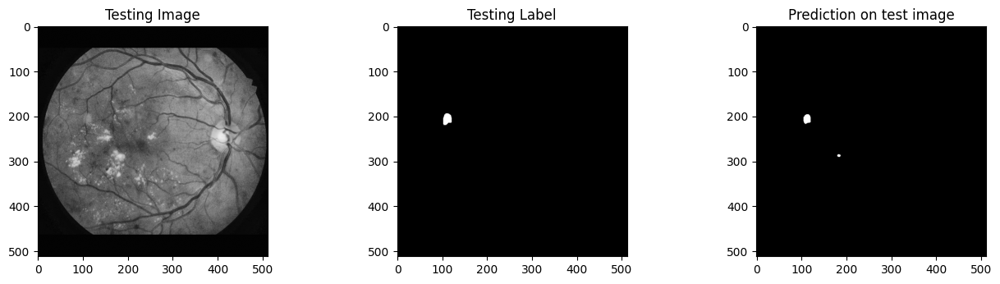

Mean IoU = 0.8233757
1/1 [==============================] - 0s 34ms/step


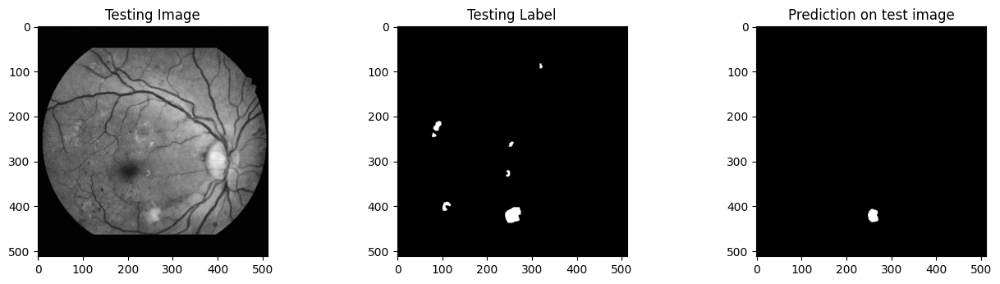

0.65141153
1/1 [==============================] - 0s 28ms/step


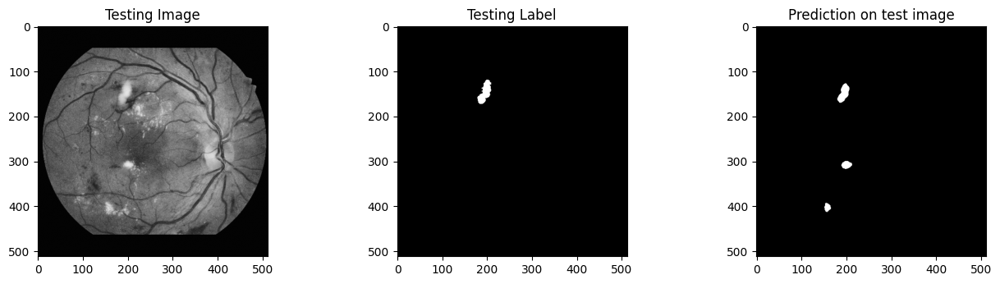

0.7237167
1/1 [==============================] - 0s 30ms/step


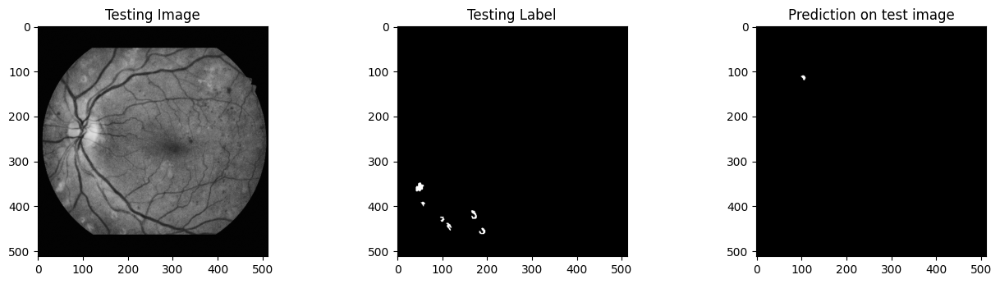

0.49855232
1/1 [==============================] - 0s 30ms/step


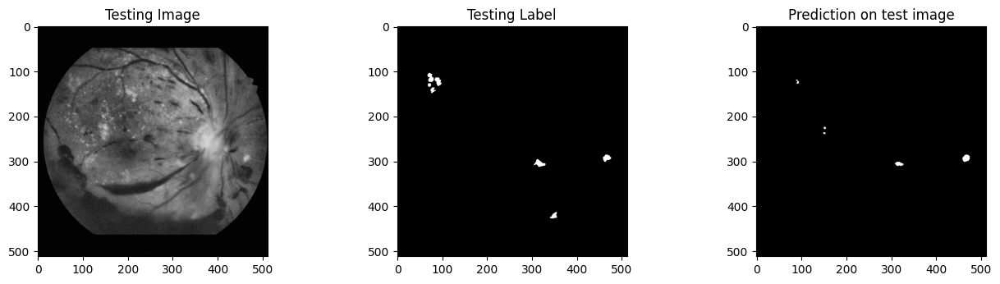

0.64604926
1/1 [==============================] - 0s 28ms/step


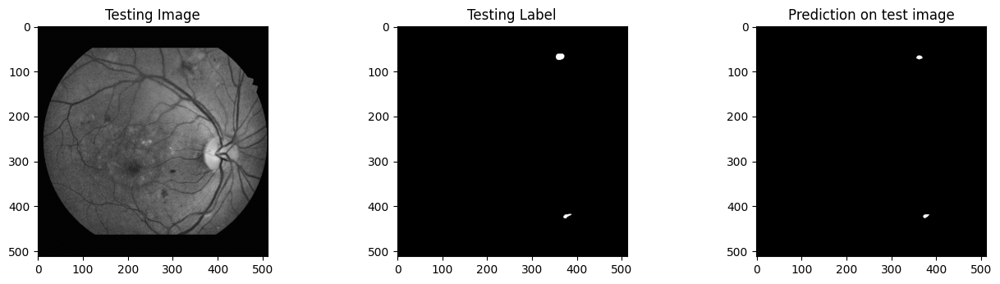

0.7550812
1/1 [==============================] - 0s 27ms/step


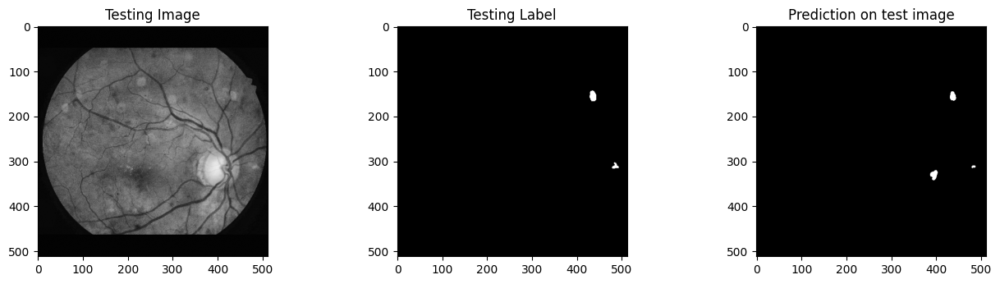

0.6914094
1/1 [==============================] - 0s 29ms/step


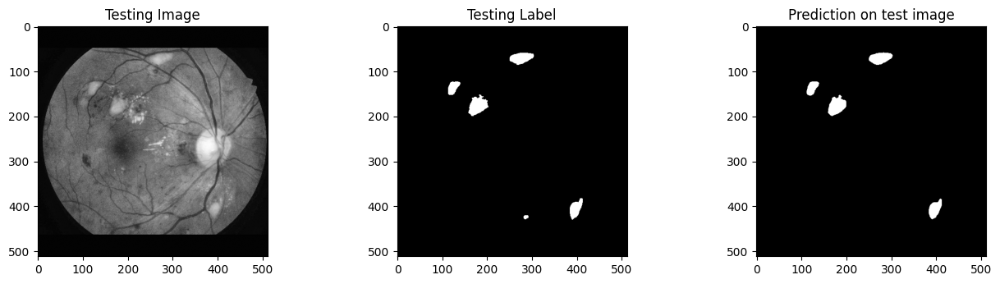

0.9511341
1/1 [==============================] - 0s 27ms/step


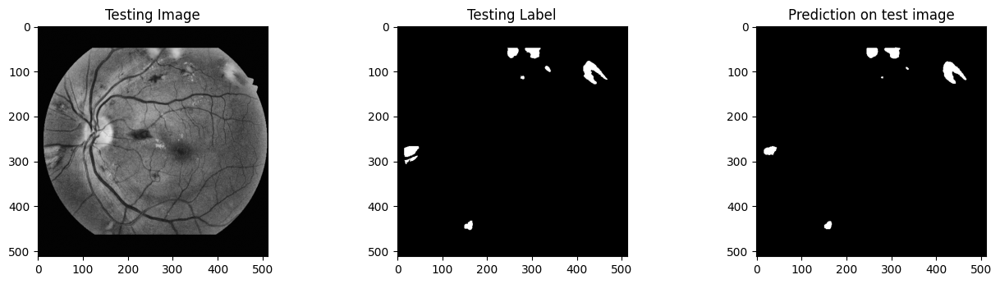

0.8880831
1/1 [==============================] - 0s 39ms/step


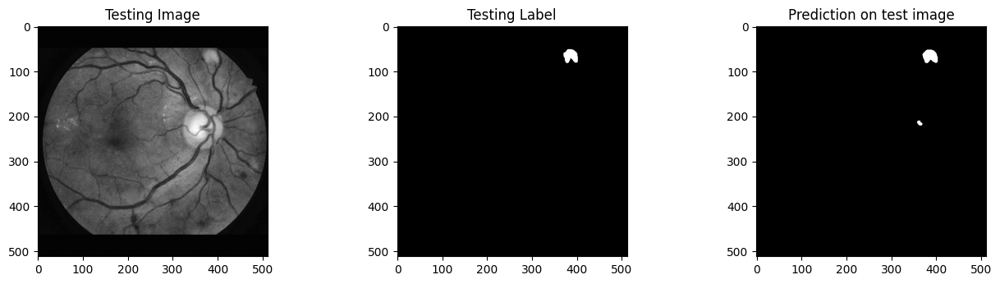

0.9055431
1/1 [==============================] - 0s 38ms/step


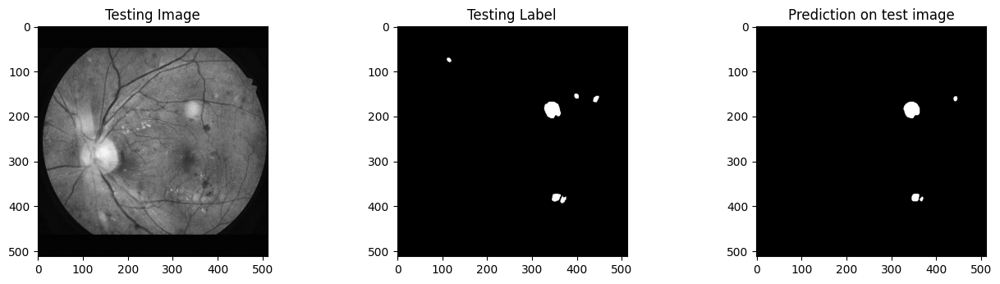

0.880353
1/1 [==============================] - 0s 49ms/step


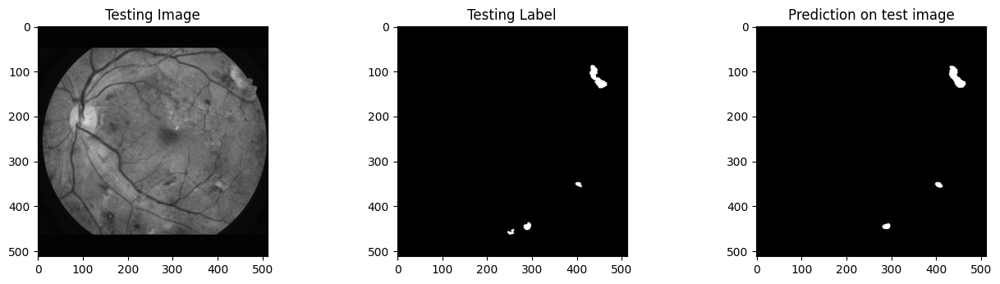

0.8744887
1/1 [==============================] - 0s 36ms/step


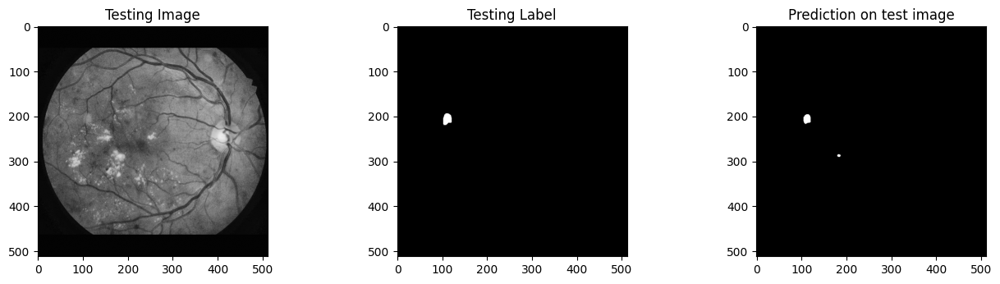

0.8233757
1/1 [==============================] - 0s 45ms/step


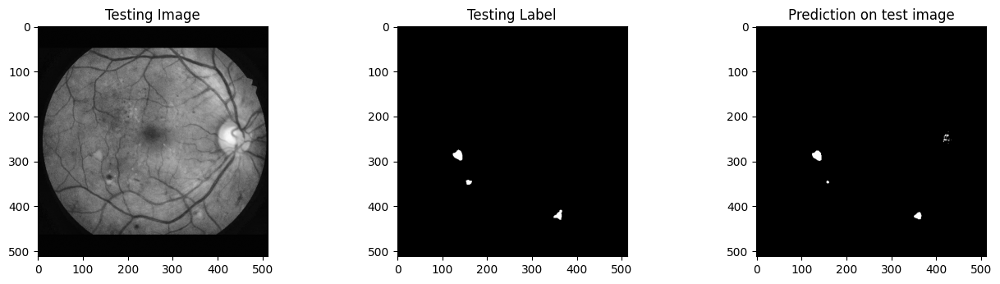

0.83941674
1/1 [==============================] - 0s 37ms/step


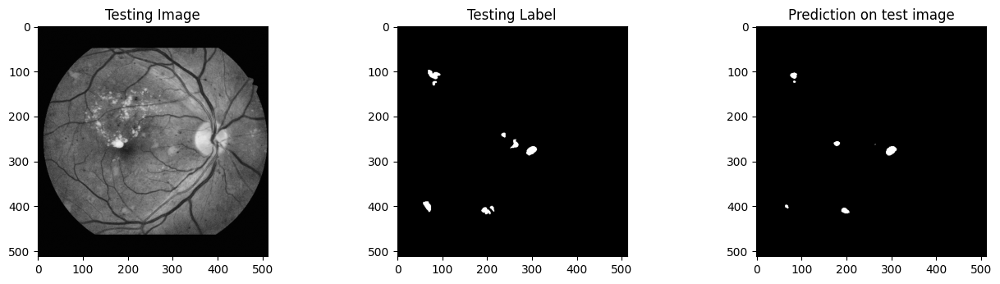

0.7083207
1/1 [==============================] - 0s 39ms/step


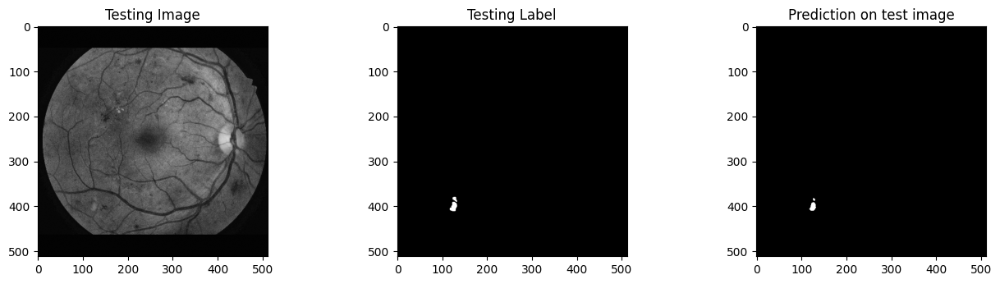

0.8417484
1/1 [==============================] - 0s 27ms/step


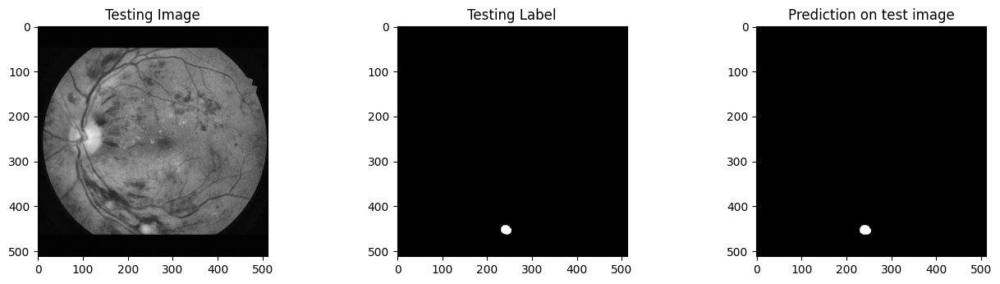

0.94758844
1/1 [==============================] - 0s 30ms/step


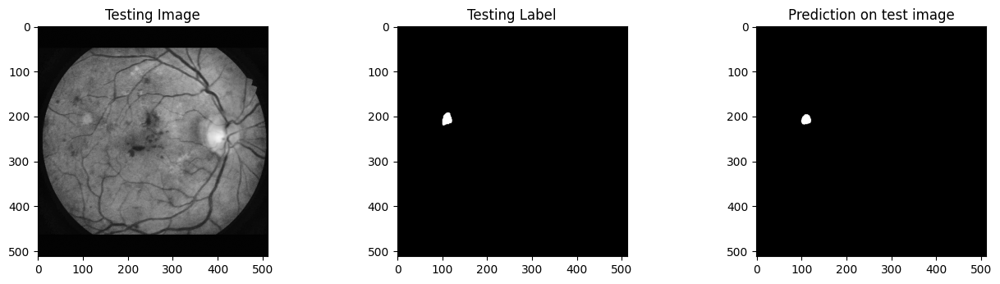

0.9101752
1/1 [==============================] - 0s 33ms/step


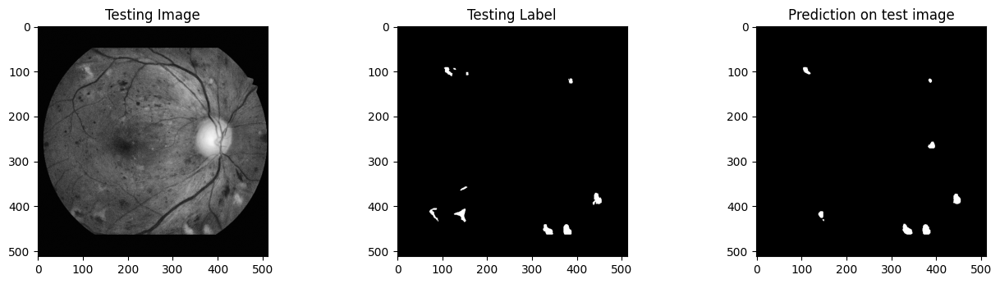

0.78763986
1/1 [==============================] - 0s 30ms/step


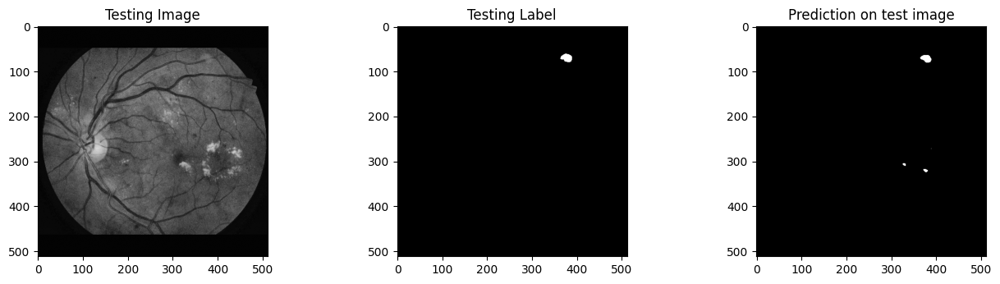

0.81546867
1/1 [==============================] - 0s 32ms/step


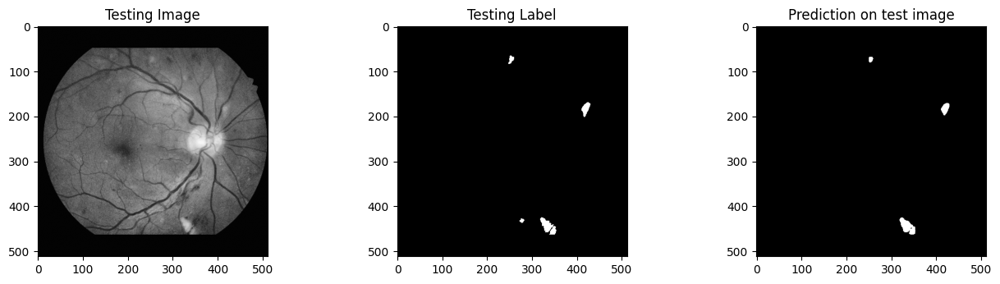

0.9005524
Mean IoU1: 0.81797665
Mean Accuracy: 0.9982984442459909
Mean Precision: [0.00457583 0.86012112 1.        ]
Mean Sensitivity: 0.7174666405435387
Mean Recall: [1.         0.71746664 0.        ]
Mean F1 Score: 0.7462574983607535
Mean Specificity: 0.9995254487379552
Mean AUC: 0.8584960446407471
Mean AUPR: 0.7894086496094926


In [ ]:
import random
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
from sklearn.metrics import accuracy_score, precision_score, recall_score

from keras.models import load_model

#Load one model at a time for testing.
model = load_model('/content/drive/MyDrive/important retinafiles(SE)/resnet50.hdf5', compile=False)


import random
test_img_number = random.randint(0, X_test.shape[0]-1)
test_img = X_test[test_img_number]
ground_truth=y_test[test_img_number]

test_img_input=np.expand_dims(test_img, 0)
prediction = (model.predict(test_img_input)[0,:,:,0] > 0.5).astype(np.uint8)

plt.figure(figsize=(16, 8))
plt.subplot(231)
plt.title('Testing Image')
plt.imshow(test_img, cmap='gray')
plt.subplot(232)
plt.title('Testing Label')
plt.imshow(ground_truth[:,:,0], cmap='gray')
plt.subplot(233)
plt.title('Prediction on test image')
plt.imshow(prediction, cmap='gray')

plt.show()


#IoU for a single image
from keras.metrics import MeanIoU
n_classes = 2
IOU_keras = MeanIoU(num_classes=n_classes)
IOU_keras.update_state(ground_truth[:,:,0], prediction)
print("Mean IoU =", IOU_keras.result().numpy())


#Calculate IoU for all test images and average

import pandas as pd

IoU_values = []
accuracy_values = []
precision_values = []
sensitivity_values = []
sensitivity_values = []
f1_score_values = []
specificity_values = []
recall_values = []
auc_values = []
aupr_values = []

for img in range(0, X_test.shape[0]):
    temp_img = X_test[img]
    ground_truth=y_test[img]
    temp_img_input=np.expand_dims(temp_img, 0)
    prediction = (model.predict(temp_img_input)[0,:,:,0] > 0.5).astype(np.uint8)
    plt.figure(figsize=(16, 8))
    plt.subplot(231)
    plt.title('Testing Image')
    plt.imshow(temp_img, cmap='gray')
    plt.subplot(232)
    plt.title('Testing Label')
    plt.imshow(ground_truth[:,:,0], cmap='gray')
    plt.subplot(233)
    plt.title('Prediction on test image')
    plt.imshow(prediction, cmap='gray')

    plt.show()
    IoU = MeanIoU(num_classes=n_classes)
    IoU.update_state(ground_truth[:,:,0], prediction)
    IoU = IoU.result().numpy()
    print(IoU)
    if IoU >= 0.5:
      # Calculate metrics
      accuracy = accuracy_score(ground_truth[:,:,0].flatten(), prediction.flatten())
      precision = precision_score(ground_truth[:,:,0].flatten(), prediction.flatten())
      sensitivity = recall_score(ground_truth[:,:,0].flatten(), prediction.flatten())
      recall = recall_score(ground_truth[:,:,0], prediction, average='weighted', zero_division=1)
      f1 = f1_score(ground_truth[:,:,0], prediction, average='weighted', zero_division=1)
      true_negatives = np.sum((ground_truth[:,:,0] == 0) & (prediction == 0))
      false_positives = np.sum((ground_truth[:,:,0] == 0) & (prediction == 1))
      specificity = true_negatives / (true_negatives + false_positives)

      ground_truth_flat = ground_truth[:,:,0].flatten()
      prediction_flat = prediction.flatten()

      precision, recall, thresholds = precision_recall_curve(ground_truth_flat, prediction_flat)
      aupr = auc(recall, precision)
      aupr_values.append(aupr)
      # Calculate the false positive rate (fpr) and true positive rate (tpr)
      fpr, tpr, thresholds = metrics.roc_curve(ground_truth_flat, prediction_flat)

      # Calculate the Area Under the Curve (AUC)
      auc_ = metrics.auc(fpr, tpr)

      IoU_values.append(IoU)

      accuracy_values.append(accuracy)
      precision_values.append(precision)
      sensitivity_values.append(sensitivity)
      f1_score_values.append(f1)
      specificity_values.append(specificity)
      recall_values.append(recall)
      auc_values.append(auc_)

df = pd.DataFrame({
    "IoU1": IoU_values,
    "Accuracy": accuracy_values,
    "Precision": precision_values,
    "Sensitivity": sensitivity_values,
    "Recall": recall_values,
    "F1 Score": f1_score_values,
    "Specificity": specificity_values,
    "AUC": auc_values,
    "AUPR": aupr_values
})

mean_IoU1 = df["IoU1"].mean()
mean_accuracy = df["Accuracy"].mean()
mean_precision = df["Precision"].mean()
mean_sensitivity = df["Sensitivity"].mean()
mean_recall = df["Recall"].mean()
mean_f1_score = df["F1 Score"].mean()
mean_specificity = df["Specificity"].mean()
mean_auc = df["AUC"].mean()
mean_aupr = df["AUPR"].mean()

print("Mean IoU1:", mean_IoU1)
print("Mean Accuracy:", mean_accuracy)
print("Mean Precision:", mean_precision)
print("Mean Sensitivity:", mean_sensitivity)
print("Mean Recall:", mean_recall)
print("Mean F1 Score:", mean_f1_score)
print("Mean Specificity:", mean_specificity)
print("Mean AUC:", mean_auc)
print("Mean AUPR:", mean_aupr)

# **RESULTS FOR VGG16 AND IMAGES**

1/1 [==============================] - 4s 4s/step


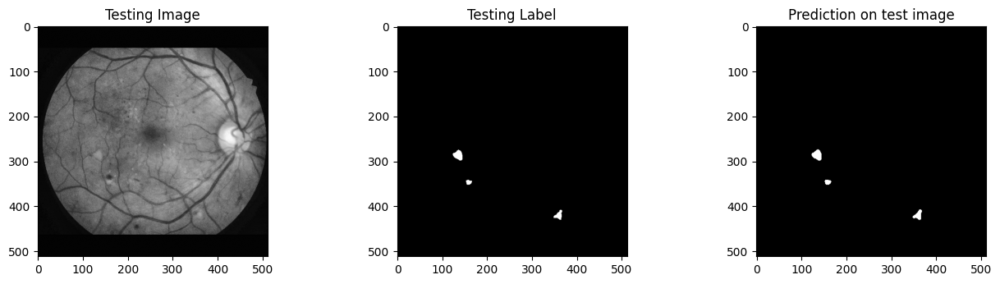

Mean IoU = 0.9431307
1/1 [==============================] - 0s 27ms/step


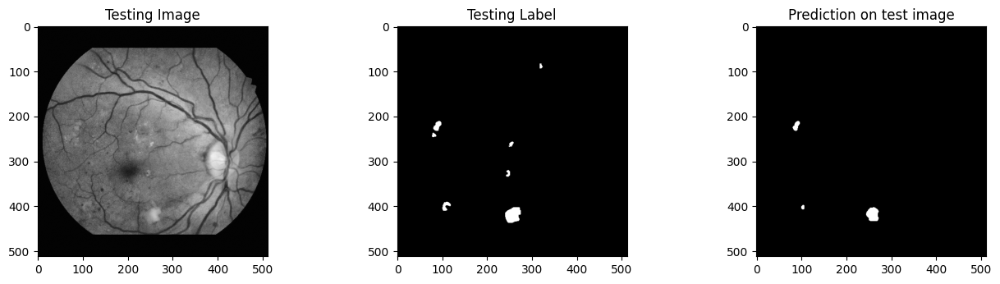

0.76855147
1/1 [==============================] - 0s 30ms/step


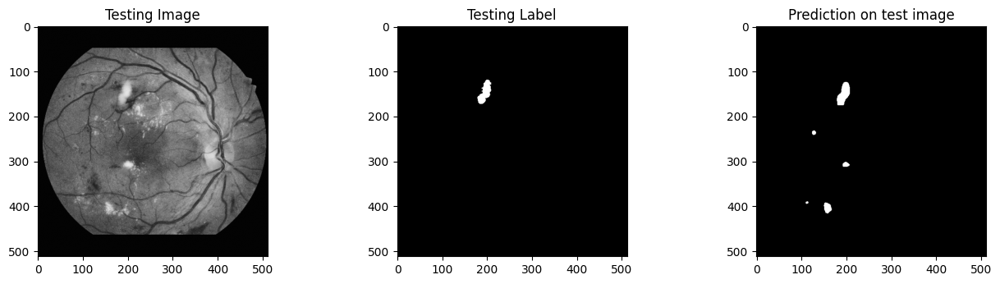

0.76088727
1/1 [==============================] - 0s 34ms/step


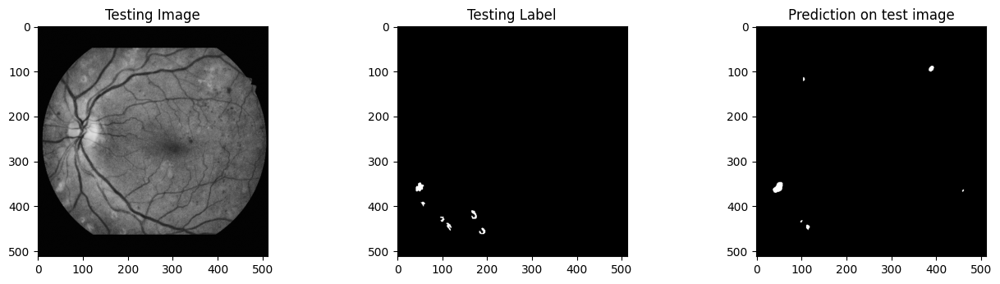

0.65097624
1/1 [==============================] - 0s 44ms/step


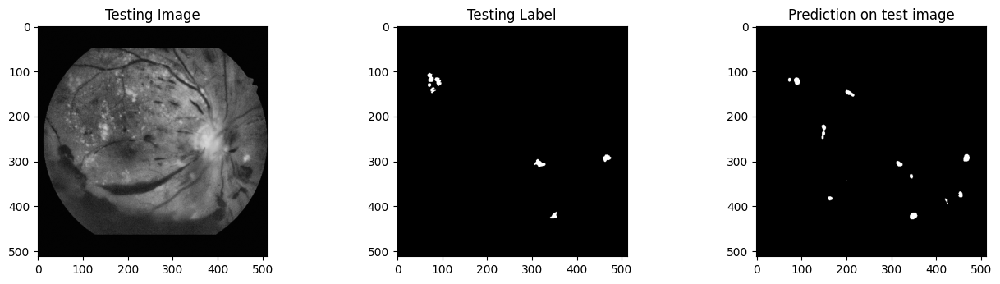

0.66667515
1/1 [==============================] - 0s 37ms/step


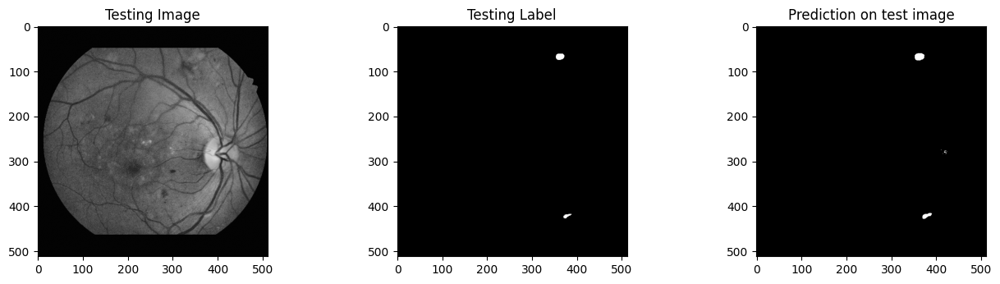

0.84554946
1/1 [==============================] - 0s 37ms/step


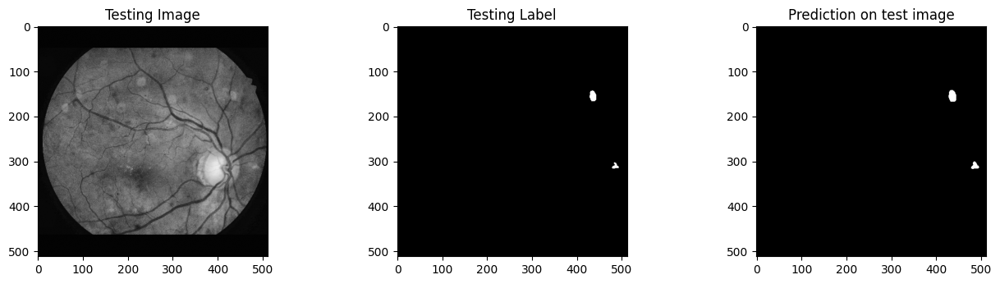

0.8690534
1/1 [==============================] - 0s 28ms/step


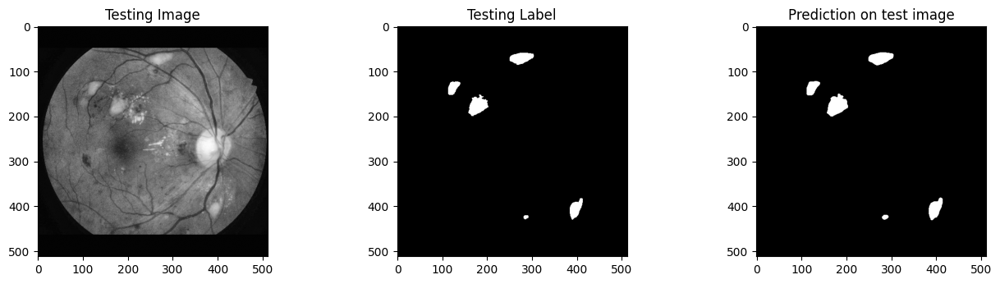

0.92767215
1/1 [==============================] - 0s 33ms/step


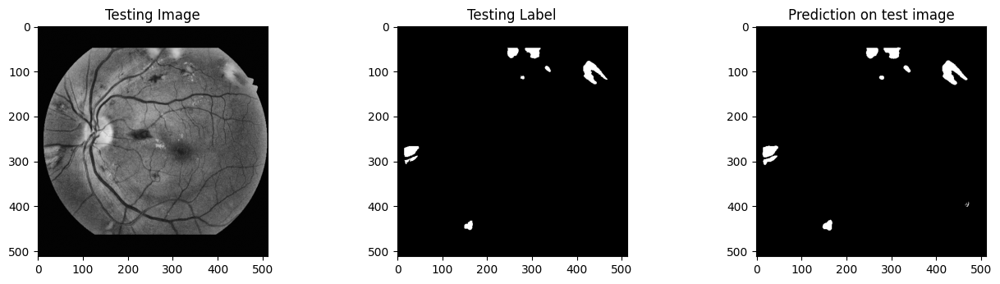

0.9123905
1/1 [==============================] - 0s 25ms/step


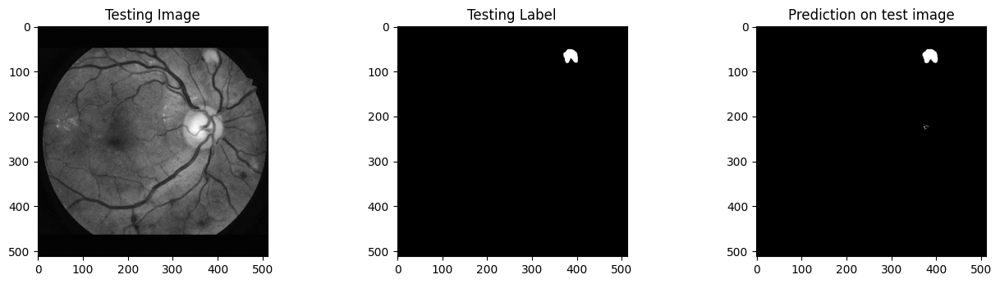

0.94494057
1/1 [==============================] - 0s 24ms/step


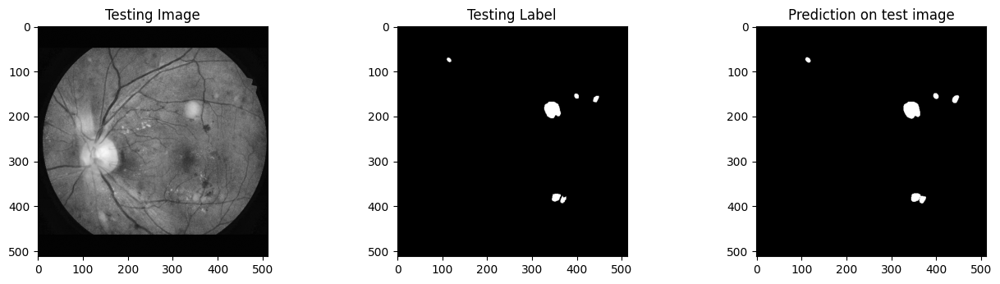

0.9298976
1/1 [==============================] - 0s 27ms/step


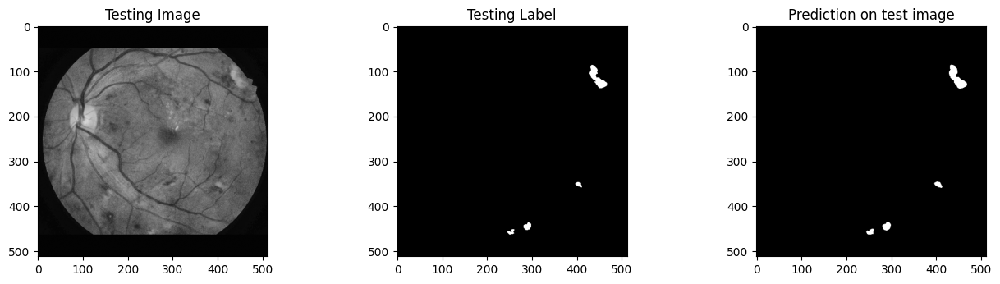

0.9193746
1/1 [==============================] - 0s 27ms/step


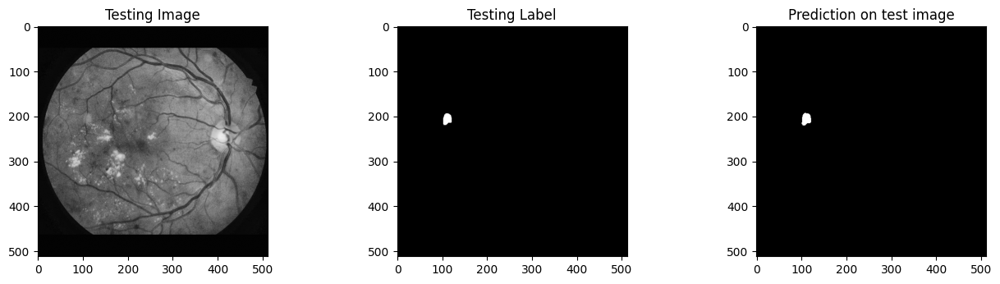

0.93558764
1/1 [==============================] - 0s 27ms/step


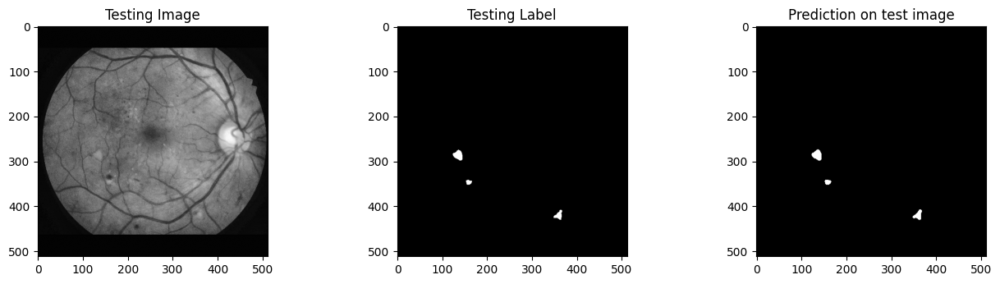

0.9431307
1/1 [==============================] - 0s 28ms/step


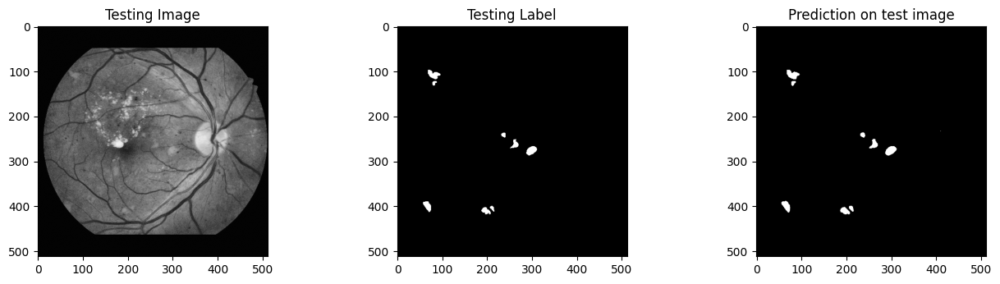

0.9412067
1/1 [==============================] - 0s 24ms/step


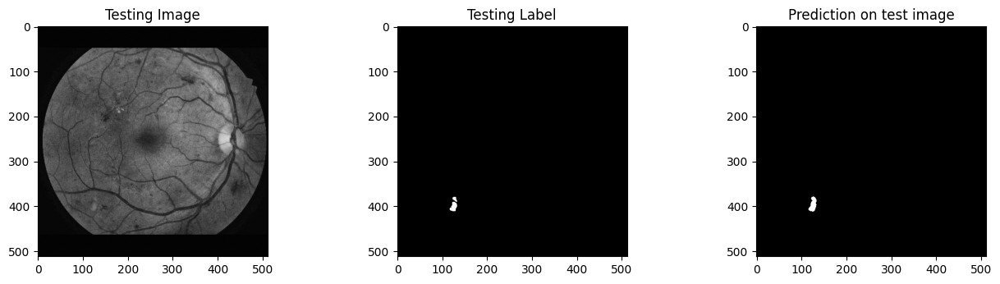

0.8988031
1/1 [==============================] - 0s 40ms/step


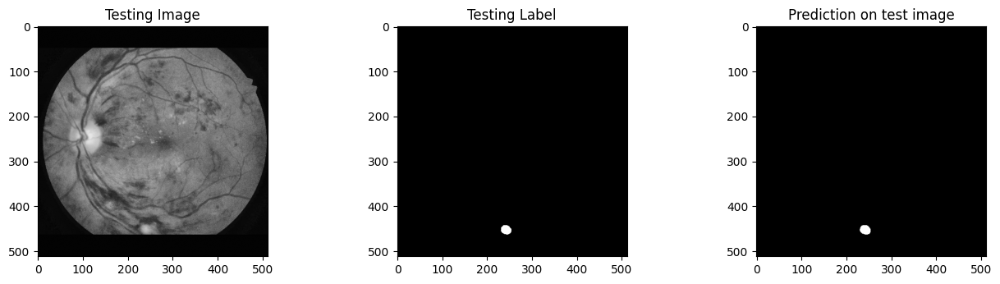

0.97527045
1/1 [==============================] - 0s 40ms/step


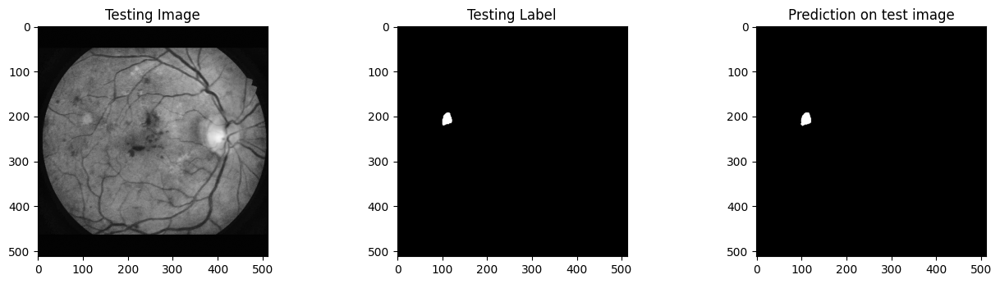

0.961765
1/1 [==============================] - 0s 25ms/step


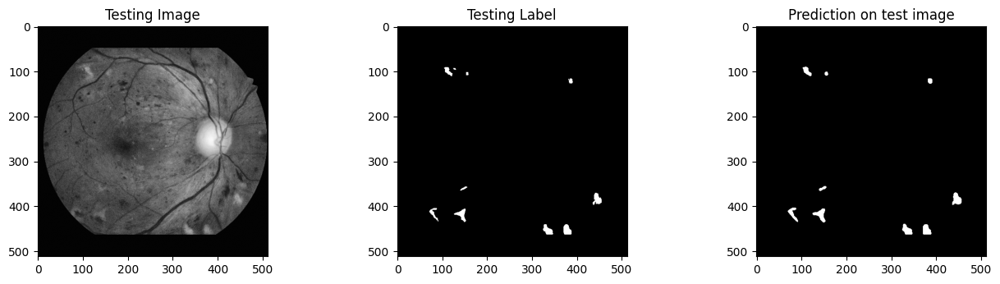

0.90413195
1/1 [==============================] - 0s 26ms/step


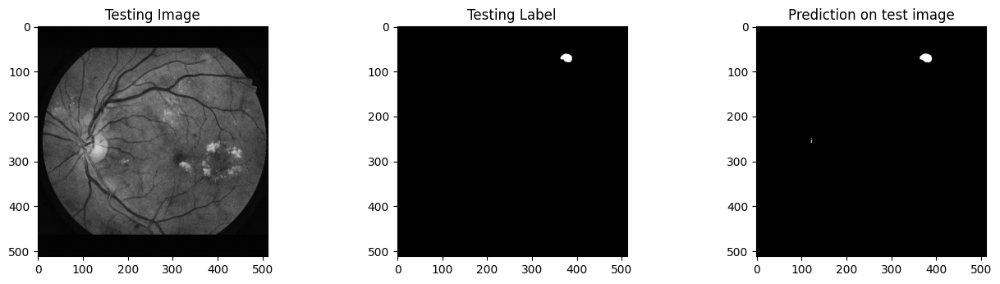

0.93193185
1/1 [==============================] - 0s 27ms/step


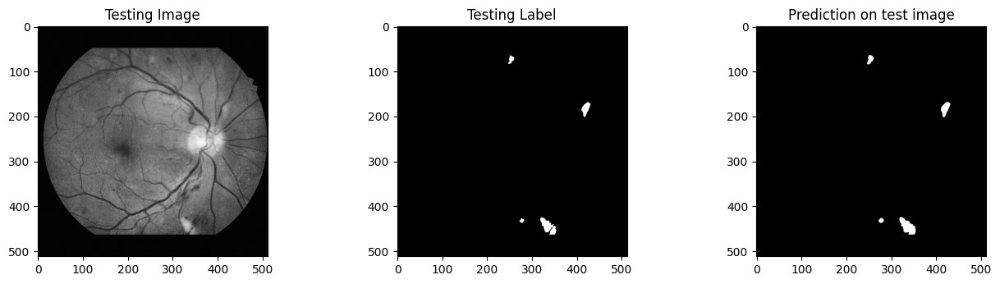

0.93159115
Mean IoU1: 0.88096935
Mean Accuracy: 0.9986896514892578
Mean Precision: [0.00447903 0.80329314 1.        ]
Mean Sensitivity: 0.9218234045078102
Mean Recall: [1.        0.9218234 0.       ]
Mean F1 Score: 0.8693194311197765
Mean Specificity: 0.999016260612397
Mean AUC: 0.9604198325601037
Mean AUPR: 0.8627248774792395


In [ ]:
import random
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
from sklearn.metrics import accuracy_score, precision_score, recall_score

from keras.models import load_model

#Load one model at a time for testing.
model = load_model('/content/drive/MyDrive/important retinafiles(SE)/VGG16.hdf5', compile=False)


import random
test_img_number = random.randint(0, X_test.shape[0]-1)
test_img = X_test[test_img_number]
ground_truth=y_test[test_img_number]

test_img_input=np.expand_dims(test_img, 0)
prediction = (model.predict(test_img_input)[0,:,:,0] > 0.5).astype(np.uint8)

plt.figure(figsize=(16, 8))
plt.subplot(231)
plt.title('Testing Image')
plt.imshow(test_img, cmap='gray')
plt.subplot(232)
plt.title('Testing Label')
plt.imshow(ground_truth[:,:,0], cmap='gray')
plt.subplot(233)
plt.title('Prediction on test image')
plt.imshow(prediction, cmap='gray')

plt.show()


#IoU for a single image
from keras.metrics import MeanIoU
n_classes = 2
IOU_keras = MeanIoU(num_classes=n_classes)
IOU_keras.update_state(ground_truth[:,:,0], prediction)
print("Mean IoU =", IOU_keras.result().numpy())


#Calculate IoU for all test images and average

import pandas as pd

IoU_values = []
accuracy_values = []
precision_values = []
sensitivity_values = []
sensitivity_values = []
f1_score_values = []
specificity_values = []
recall_values = []
auc_values = []
aupr_values = []

for img in range(0, X_test.shape[0]):
    temp_img = X_test[img]
    ground_truth=y_test[img]
    temp_img_input=np.expand_dims(temp_img, 0)
    prediction = (model.predict(temp_img_input)[0,:,:,0] > 0.5).astype(np.uint8)
    plt.figure(figsize=(16, 8))
    plt.subplot(231)
    plt.title('Testing Image')
    plt.imshow(temp_img, cmap='gray')
    plt.subplot(232)
    plt.title('Testing Label')
    plt.imshow(ground_truth[:,:,0], cmap='gray')
    plt.subplot(233)
    plt.title('Prediction on test image')
    plt.imshow(prediction, cmap='gray')

    plt.show()
    IoU = MeanIoU(num_classes=n_classes)
    IoU.update_state(ground_truth[:,:,0], prediction)
    IoU = IoU.result().numpy()
    print(IoU)
    if IoU >= 0.5:
      # Calculate metrics
      accuracy = accuracy_score(ground_truth[:,:,0].flatten(), prediction.flatten())
      precision = precision_score(ground_truth[:,:,0].flatten(), prediction.flatten())
      sensitivity = recall_score(ground_truth[:,:,0].flatten(), prediction.flatten())
      recall = recall_score(ground_truth[:,:,0], prediction, average='weighted', zero_division=1)
      f1 = f1_score(ground_truth[:,:,0], prediction, average='weighted', zero_division=1)
      true_negatives = np.sum((ground_truth[:,:,0] == 0) & (prediction == 0))
      false_positives = np.sum((ground_truth[:,:,0] == 0) & (prediction == 1))
      specificity = true_negatives / (true_negatives + false_positives)

      ground_truth_flat = ground_truth[:,:,0].flatten()
      prediction_flat = prediction.flatten()

      precision, recall, thresholds = precision_recall_curve(ground_truth_flat, prediction_flat)
      aupr = auc(recall, precision)
      aupr_values.append(aupr)
      # Calculate the false positive rate (fpr) and true positive rate (tpr)
      fpr, tpr, thresholds = metrics.roc_curve(ground_truth_flat, prediction_flat)

      # Calculate the Area Under the Curve (AUC)
      auc_ = metrics.auc(fpr, tpr)

      IoU_values.append(IoU)

      accuracy_values.append(accuracy)
      precision_values.append(precision)
      sensitivity_values.append(sensitivity)
      f1_score_values.append(f1)
      specificity_values.append(specificity)
      recall_values.append(recall)
      auc_values.append(auc_)

df = pd.DataFrame({
    "IoU1": IoU_values,
    "Accuracy": accuracy_values,
    "Precision": precision_values,
    "Sensitivity": sensitivity_values,
    "Recall": recall_values,
    "F1 Score": f1_score_values,
    "Specificity": specificity_values,
    "AUC": auc_values,
    "AUPR": aupr_values
})

mean_IoU1 = df["IoU1"].mean()
mean_accuracy = df["Accuracy"].mean()
mean_precision = df["Precision"].mean()
mean_sensitivity = df["Sensitivity"].mean()
mean_recall = df["Recall"].mean()
mean_f1_score = df["F1 Score"].mean()
mean_specificity = df["Specificity"].mean()
mean_auc = df["AUC"].mean()
mean_aupr = df["AUPR"].mean()

print("Mean IoU1:", mean_IoU1)
print("Mean Accuracy:", mean_accuracy)
print("Mean Precision:", mean_precision)
print("Mean Sensitivity:", mean_sensitivity)
print("Mean Recall:", mean_recall)
print("Mean F1 Score:", mean_f1_score)
print("Mean Specificity:", mean_specificity)
print("Mean AUC:", mean_auc)
print("Mean AUPR:", mean_aupr)

# **RESULTS FOR INCEPTIONRESNETV2 AND IMAGES**

1/1 [==============================] - 5s 5s/step


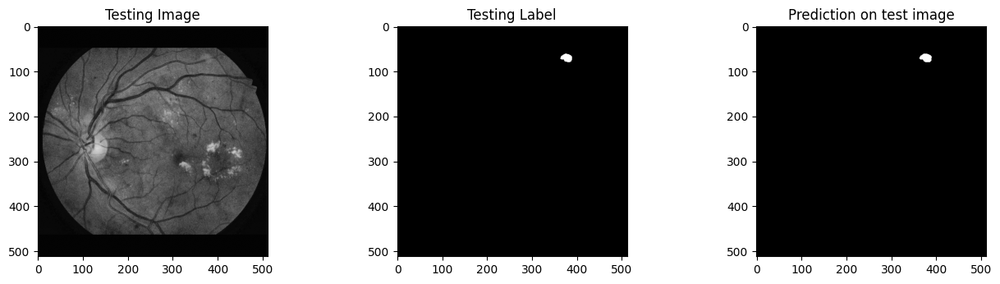

Mean IoU = 0.9598891
1/1 [==============================] - 0s 40ms/step


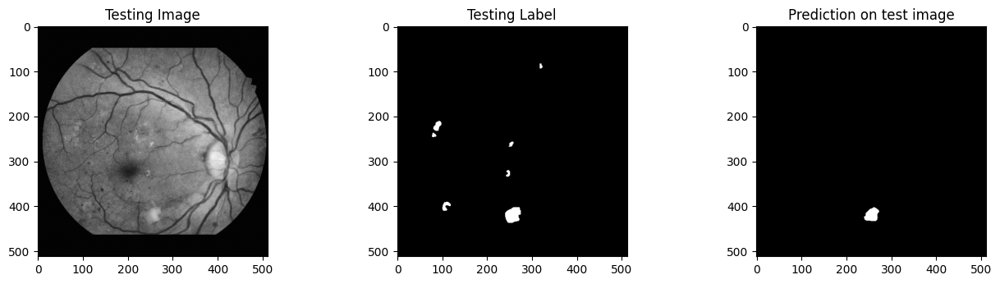

0.7054843
1/1 [==============================] - 0s 43ms/step


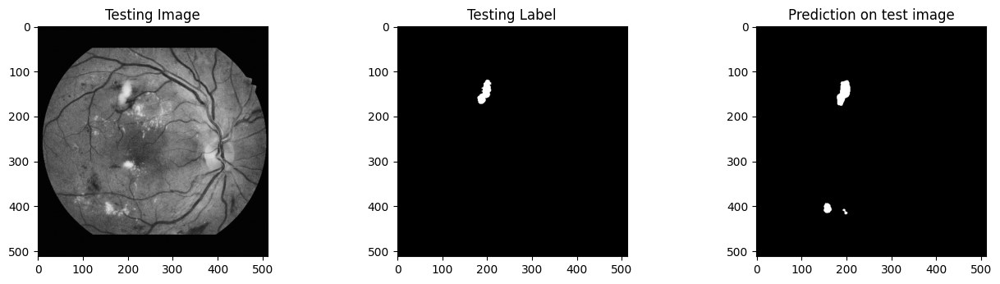

0.7981844
1/1 [==============================] - 0s 42ms/step


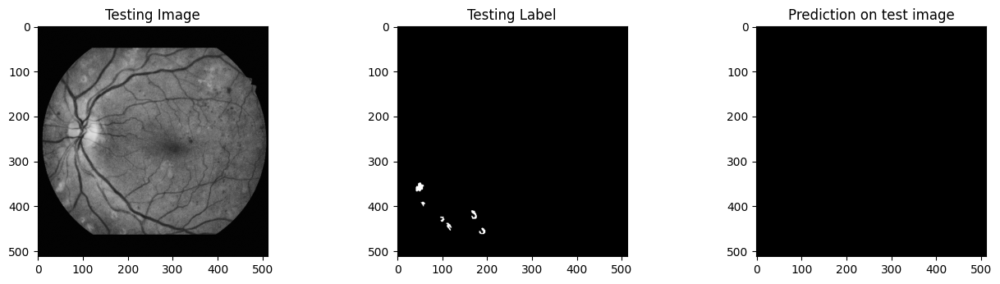

0.4986801
1/1 [==============================] - 0s 39ms/step


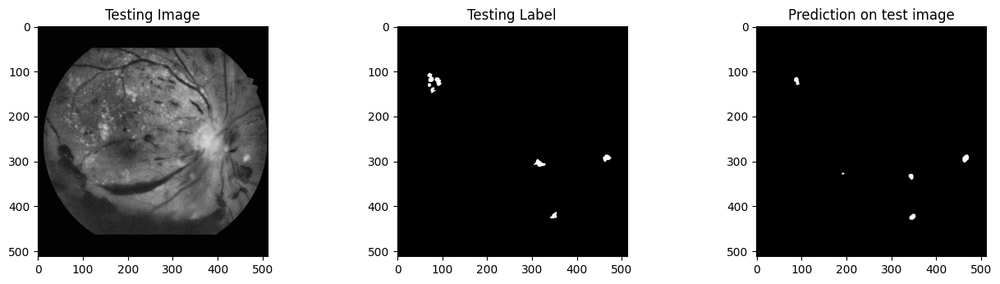

0.65377223
1/1 [==============================] - 0s 40ms/step


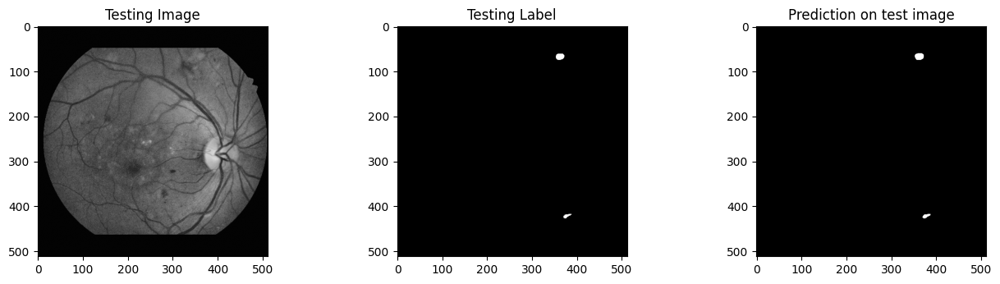

0.93605155
1/1 [==============================] - 0s 74ms/step


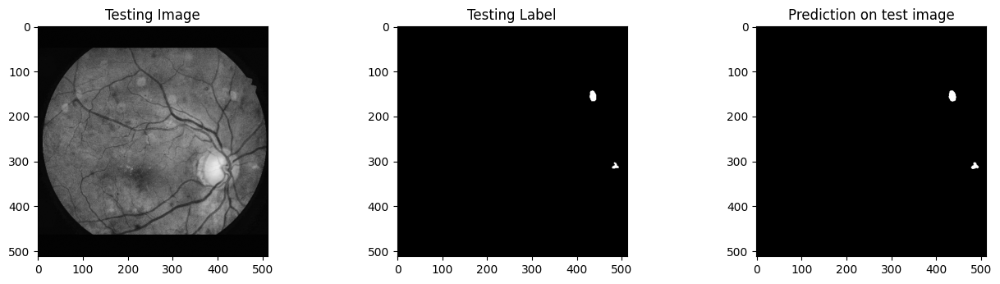

0.9319372
1/1 [==============================] - 0s 57ms/step


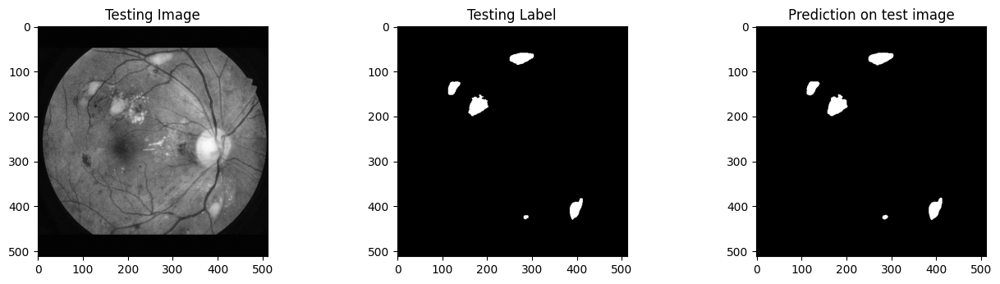

0.9629934
1/1 [==============================] - 0s 39ms/step


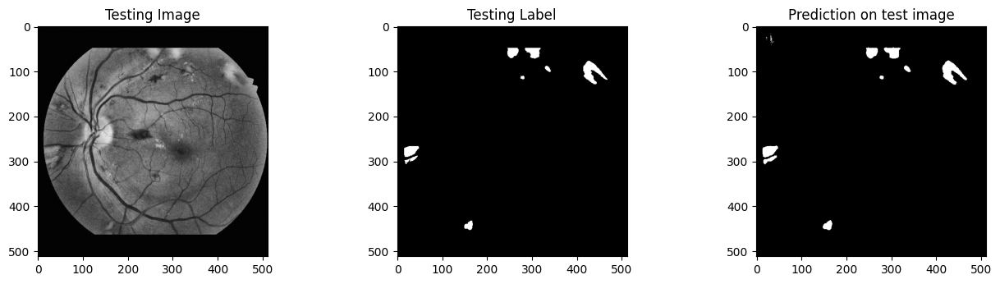

0.9387361
1/1 [==============================] - 0s 49ms/step


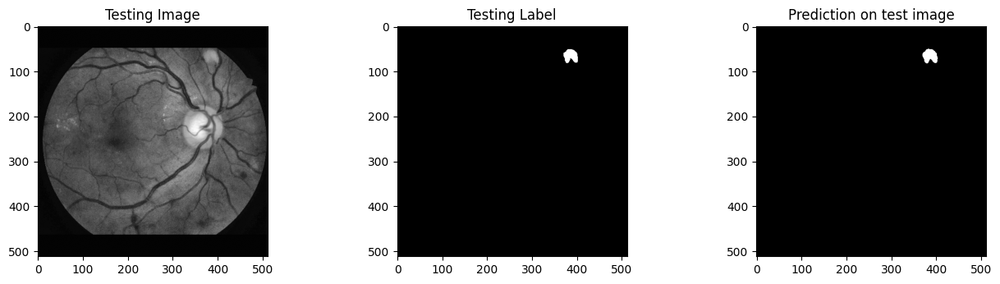

0.96224403
1/1 [==============================] - 0s 41ms/step


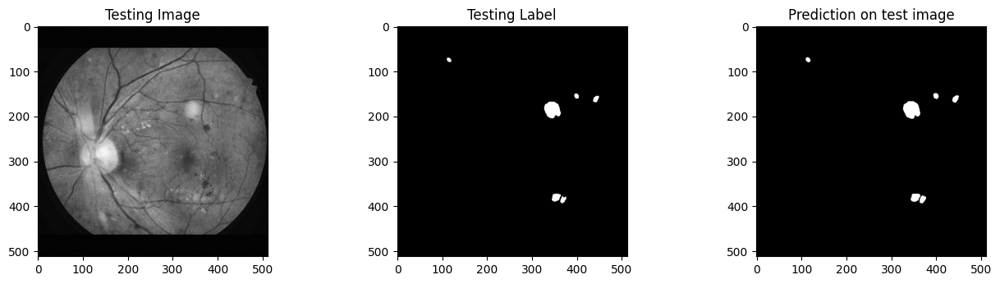

0.9417822
1/1 [==============================] - 0s 48ms/step


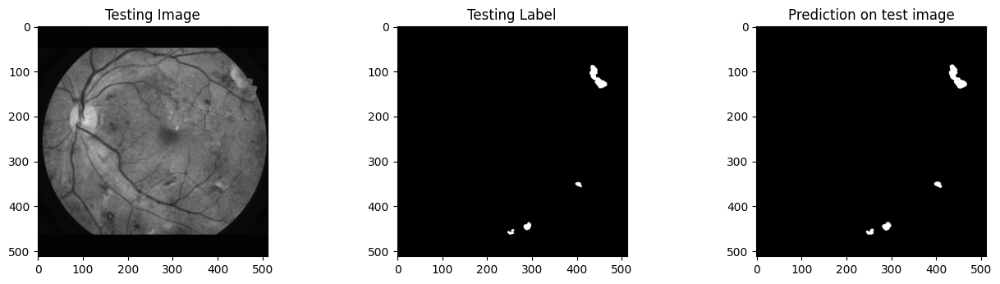

0.9196526
1/1 [==============================] - 0s 45ms/step


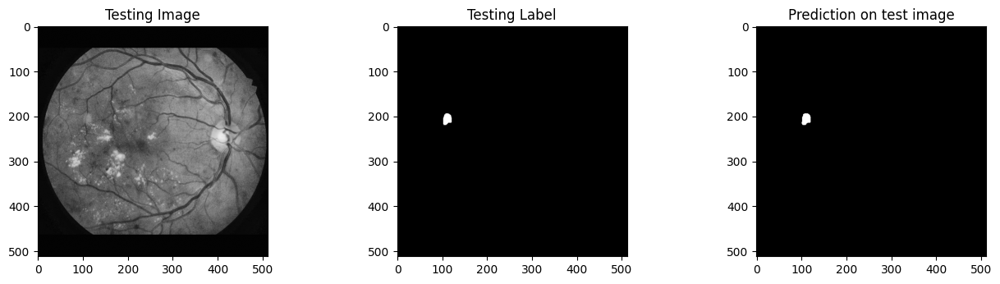

0.9745976
1/1 [==============================] - 0s 42ms/step


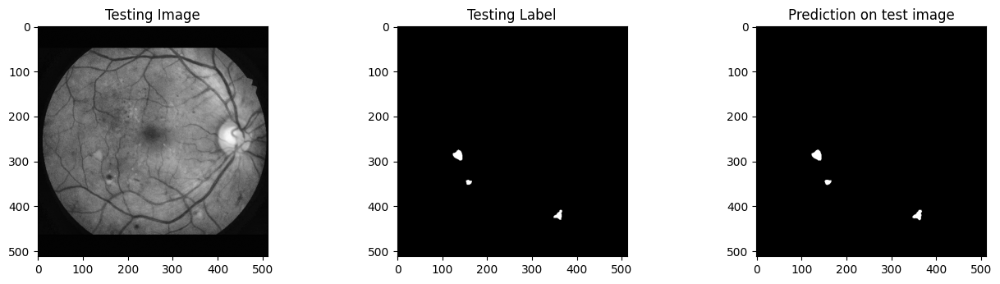

0.9419873
1/1 [==============================] - 0s 49ms/step


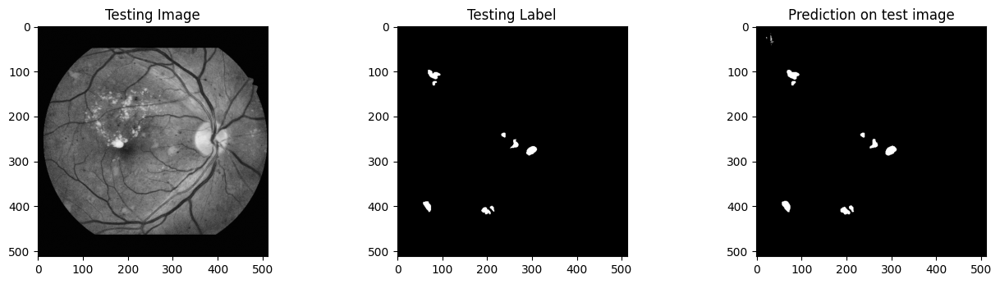

0.925251
1/1 [==============================] - 0s 42ms/step


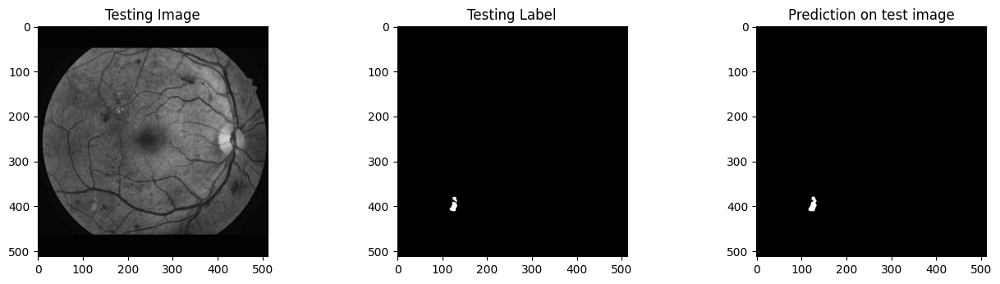

0.9244779
1/1 [==============================] - 0s 46ms/step


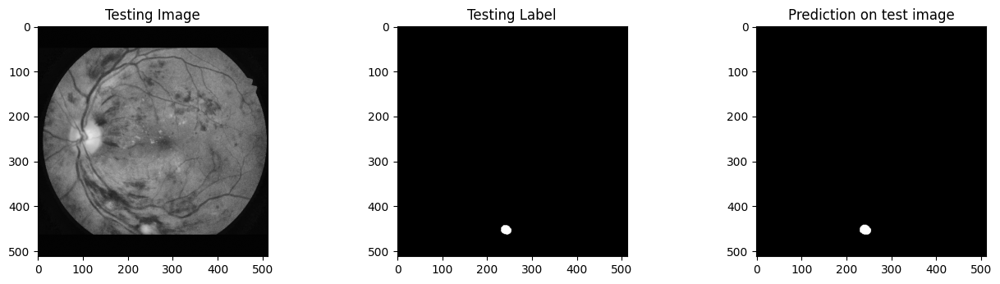

0.9383935
1/1 [==============================] - 0s 60ms/step


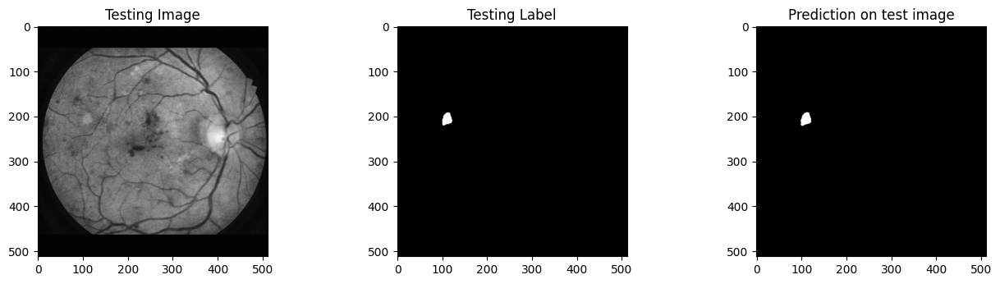

0.9608611
1/1 [==============================] - 0s 62ms/step


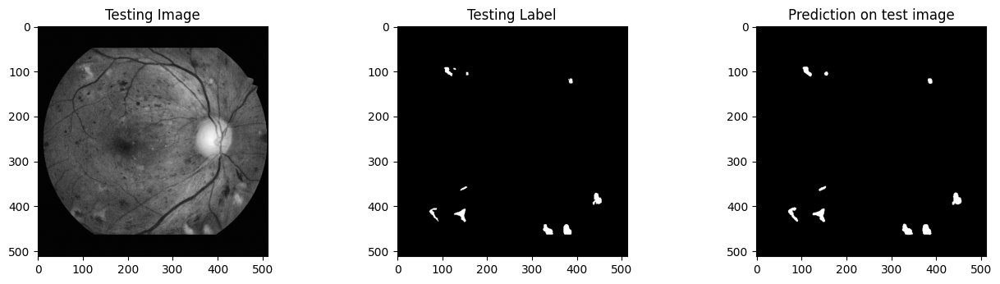

0.9058834
1/1 [==============================] - 0s 41ms/step


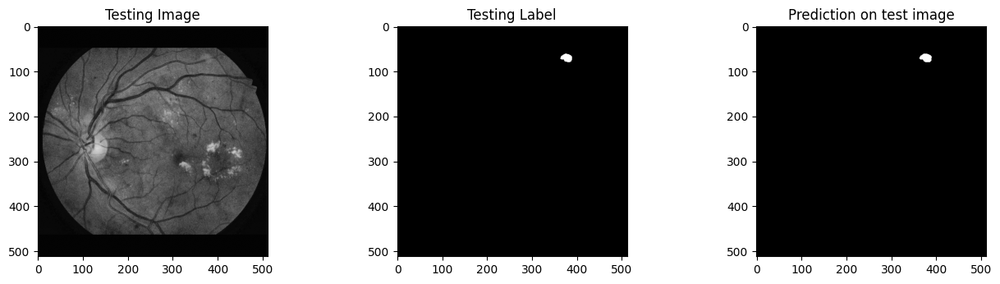

0.9598891
1/1 [==============================] - 0s 44ms/step


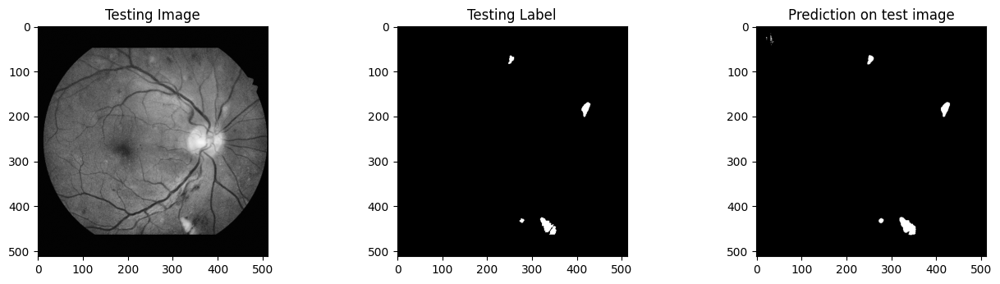

0.9138701
Mean IoU1: 0.9050552
Mean Accuracy: 0.9989666185880962
Mean Precision: [0.00457583 0.86195877 1.        ]
Mean Sensitivity: 0.932859488417974
Mean Recall: [1.         0.93285949 0.        ]
Mean F1 Score: 0.8884718418130091
Mean Specificity: 0.9993121658034654
Mean AUC: 0.9660858271107196
Mean AUPR: 0.8975842034277871


In [ ]:
import random
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
from sklearn.metrics import accuracy_score, precision_score, recall_score

from keras.models import load_model

#Load one model at a time for testing.
model = load_model('//content/drive/MyDrive/important retinafiles(SE)/InceptionResNetV2.hdf5', compile=False)


import random
test_img_number = random.randint(0, X_test.shape[0]-1)
test_img = X_test[test_img_number]
ground_truth=y_test[test_img_number]

test_img_input=np.expand_dims(test_img, 0)
prediction = (model.predict(test_img_input)[0,:,:,0] > 0.5).astype(np.uint8)

plt.figure(figsize=(16, 8))
plt.subplot(231)
plt.title('Testing Image')
plt.imshow(test_img, cmap='gray')
plt.subplot(232)
plt.title('Testing Label')
plt.imshow(ground_truth[:,:,0], cmap='gray')
plt.subplot(233)
plt.title('Prediction on test image')
plt.imshow(prediction, cmap='gray')

plt.show()


#IoU for a single image
from keras.metrics import MeanIoU
n_classes = 2
IOU_keras = MeanIoU(num_classes=n_classes)
IOU_keras.update_state(ground_truth[:,:,0], prediction)
print("Mean IoU =", IOU_keras.result().numpy())


#Calculate IoU for all test images and average

import pandas as pd

IoU_values = []
accuracy_values = []
precision_values = []
sensitivity_values = []
sensitivity_values = []
f1_score_values = []
specificity_values = []
recall_values = []
auc_values = []
aupr_values = []

for img in range(0, X_test.shape[0]):
    temp_img = X_test[img]
    ground_truth=y_test[img]
    temp_img_input=np.expand_dims(temp_img, 0)
    prediction = (model.predict(temp_img_input)[0,:,:,0] > 0.5).astype(np.uint8)
    plt.figure(figsize=(16, 8))
    plt.subplot(231)
    plt.title('Testing Image')
    plt.imshow(temp_img, cmap='gray')
    plt.subplot(232)
    plt.title('Testing Label')
    plt.imshow(ground_truth[:,:,0], cmap='gray')
    plt.subplot(233)
    plt.title('Prediction on test image')
    plt.imshow(prediction, cmap='gray')

    plt.show()
    IoU = MeanIoU(num_classes=n_classes)
    IoU.update_state(ground_truth[:,:,0], prediction)
    IoU = IoU.result().numpy()
    print(IoU)
    if IoU >= 0.5:
      # Calculate metrics
      accuracy = accuracy_score(ground_truth[:,:,0].flatten(), prediction.flatten())
      precision = precision_score(ground_truth[:,:,0].flatten(), prediction.flatten())
      sensitivity = recall_score(ground_truth[:,:,0].flatten(), prediction.flatten())
      recall = recall_score(ground_truth[:,:,0], prediction, average='weighted', zero_division=1)
      f1 = f1_score(ground_truth[:,:,0], prediction, average='weighted', zero_division=1)
      true_negatives = np.sum((ground_truth[:,:,0] == 0) & (prediction == 0))
      false_positives = np.sum((ground_truth[:,:,0] == 0) & (prediction == 1))
      specificity = true_negatives / (true_negatives + false_positives)

      ground_truth_flat = ground_truth[:,:,0].flatten()
      prediction_flat = prediction.flatten()

      precision, recall, thresholds = precision_recall_curve(ground_truth_flat, prediction_flat)
      aupr = auc(recall, precision)
      aupr_values.append(aupr)
      # Calculate the false positive rate (fpr) and true positive rate (tpr)
      fpr, tpr, thresholds = metrics.roc_curve(ground_truth_flat, prediction_flat)

      # Calculate the Area Under the Curve (AUC)
      auc_ = metrics.auc(fpr, tpr)

      IoU_values.append(IoU)

      accuracy_values.append(accuracy)
      precision_values.append(precision)
      sensitivity_values.append(sensitivity)
      f1_score_values.append(f1)
      specificity_values.append(specificity)
      recall_values.append(recall)
      auc_values.append(auc_)

df = pd.DataFrame({
    "IoU1": IoU_values,
    "Accuracy": accuracy_values,
    "Precision": precision_values,
    "Sensitivity": sensitivity_values,
    "Recall": recall_values,
    "F1 Score": f1_score_values,
    "Specificity": specificity_values,
    "AUC": auc_values,
    "AUPR": aupr_values
})

mean_IoU1 = df["IoU1"].mean()
mean_accuracy = df["Accuracy"].mean()
mean_precision = df["Precision"].mean()
mean_sensitivity = df["Sensitivity"].mean()
mean_recall = df["Recall"].mean()
mean_f1_score = df["F1 Score"].mean()
mean_specificity = df["Specificity"].mean()
mean_auc = df["AUC"].mean()
mean_aupr = df["AUPR"].mean()

print("Mean IoU1:", mean_IoU1)
print("Mean Accuracy:", mean_accuracy)
print("Mean Precision:", mean_precision)
print("Mean Sensitivity:", mean_sensitivity)
print("Mean Recall:", mean_recall)
print("Mean F1 Score:", mean_f1_score)
print("Mean Specificity:", mean_specificity)
print("Mean AUC:", mean_auc)
print("Mean AUPR:", mean_aupr)

1/1 [==============================] - 3s 3s/step
(4, 512, 512)


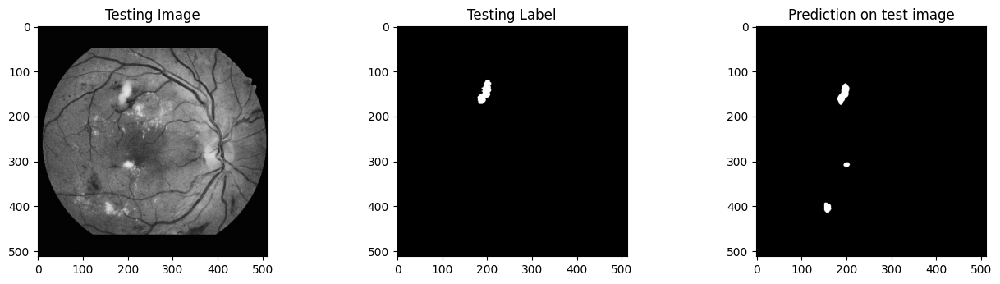

Mean IoU2= 0.58249635
Mean IoU3 = 0.7237167
Mean IoU4 = 0.76088727
Mean IoU5 = 0.7981844
Mean IoUW = 0.7544743


In [ ]:
from keras.models import load_model
import numpy as np
from tensorflow.keras.metrics import MeanIoU
from tensorflow.keras.layers import Conv2D, BatchNormalization, Activation, MaxPool2D, Conv2DTranspose, Concatenate, Input, Lambda ,concatenate
from tensorflow.keras.models import Model
from tensorflow.keras.applications import EfficientNetB4

import tensorflow as tf
from keras import models, layers, regularizers
from keras import backend as K

test_img_number = 1
model2 = load_model('/content/drive/MyDrive/important retinafiles(SE)/DenseNet121.hdf5', compile=False)
model3 = load_model('/content/drive/MyDrive/important retinafiles(SE)/resnet50.hdf5', compile=False)
model4 = load_model('/content/drive/MyDrive/important retinafiles(SE)/VGG16.hdf5', compile=False)
model5 = load_model('/content/drive/MyDrive/important retinafiles(SE)/InceptionResNetV2.hdf5', compile=False)
#Weighted average ensemble

#Weighted average ensemble
models = [ model2, model3, model4, model5]
prediction2 = (model2.predict(test_img_input)[0,:,:,0] > 0.5).astype(np.uint8)
prediction3 = (model3.predict(test_img_input)[0,:,:,0] > 0.5).astype(np.uint8)
prediction4 = (model4.predict(test_img_input)[0,:,:,0] > 0.5).astype(np.uint8)
prediction5 = (model5.predict(test_img_input)[0,:,:,0] > 0.5).astype(np.uint8)

preds=np.array([ prediction2, prediction3, prediction4, prediction5])
print(preds.shape)
#preds=np.array(preds)
weights = [0.4, 0.2, 0.2,0.2,]
threshold = 0.5
weighted_preds = np.tensordot(preds, weights, axes=((0),(0)))
weighted_ensemble_prediction = (weighted_preds > threshold).astype(int)
plt.figure(figsize=(16, 8))
plt.subplot(231)
plt.title('Testing Image')
plt.imshow(test_img, cmap='gray')
plt.subplot(232)
plt.title('Testing Label')
plt.imshow(ground_truth[:,:,0], cmap='gray')
plt.subplot(233)
plt.title('Prediction on test image')
plt.imshow(weighted_ensemble_prediction, cmap='gray')

plt.show()
n_classes = 2
IOU_keras2 = MeanIoU(num_classes=n_classes)
IOU_keras2.update_state(ground_truth[:,:,0], prediction2)
print("Mean IoU2=", IOU_keras2.result().numpy())
IOU_keras3 = MeanIoU(num_classes=n_classes)
IOU_keras3.update_state(ground_truth[:,:,0], prediction3)
print("Mean IoU3 =", IOU_keras3.result().numpy())
IOU_keras4 = MeanIoU(num_classes=n_classes)
IOU_keras4.update_state(ground_truth[:,:,0], prediction4)
print("Mean IoU4 =", IOU_keras4.result().numpy())
IOU_keras5 = MeanIoU(num_classes=n_classes)
IOU_keras5.update_state(ground_truth[:,:,0], prediction5)
print("Mean IoU5 =", IOU_keras5.result().numpy())
IOU_kerasW = MeanIoU(num_classes=n_classes)
IOU_kerasW.update_state(ground_truth[:,:,0], weighted_ensemble_prediction)
print("Mean IoUW =", IOU_kerasW.result().numpy())

In [ ]:

import pandas as pd
df = pd.DataFrame([])
for w1 in range(0,4):
  for w2 in range(0, 4):
    for w3 in range(0,4):
        for w4 in range(0,4):
            wts = [w1/10.,w2/10.,w3/10.,w4/10.,]

            IOU_wted = MeanIoU(num_classes=n_classes)
            wted_preds = np.tensordot(preds, wts, axes=((0),(0)))
            print(preds.shape)
            wted_ensemble_pred = (wted_preds > threshold).astype(np.uint8)
            IOU_wted.update_state(ground_truth[:,:,0], wted_ensemble_pred)
            print("Now predciting for weights :", w1/10., w2/10., w3/10., " : IOU = ", IOU_wted.result().numpy())
            df = df.append(pd.DataFrame({'wt1':wts[0],'wt2':wts[1],
                                          'wt3':wts[2],'wt4':wts[3], 'IOU': IOU_wted.result().numpy()}, index=[0]), ignore_index=True)

max_iou_row = df.iloc[df['IOU'].idxmax()]
print("Max IOU of ", max_iou_row[3], " obained with w1=", max_iou_row[0],
      " w2=", max_iou_row[1], " and w3=", max_iou_row[2], " and w4=", max_iou_row[3])


In [ ]:
max_iou_row = df.loc[df['IOU'].idxmax()]
max_iou_row

wt1    0.000000
wt2    0.000000
wt3    0.300000
wt4    0.300000
IOU    0.818239
Name: 15, dtype: float64

# **ENSEMBLE EXPERIMENT**

1/1 [==============================] - 1s 725ms/step


1/1 [==============================] - 4s 4s/step
(5, 512, 512)


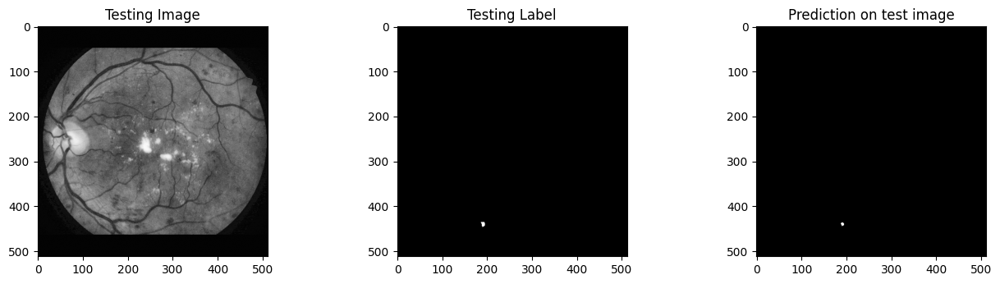

IoU1= 0.9011304
IoU2= 0.5832189
IoU3 = 0.71798396
IoU4 = 0.9499847
IoU5 = 0.9285505
IoUW = 0.7846631
Accuracy: 0.98046875
Precision: 1.0
Sensitivity: 0.5694444444444444
Recall: 0.5694444444444444
F1 Score: 0.6911436236287888
Specificity: 1.0
AUC: 0.7847222222222222
0.7846631
1/1 [==============================] - 0s 42ms/step
(5, 512, 512)


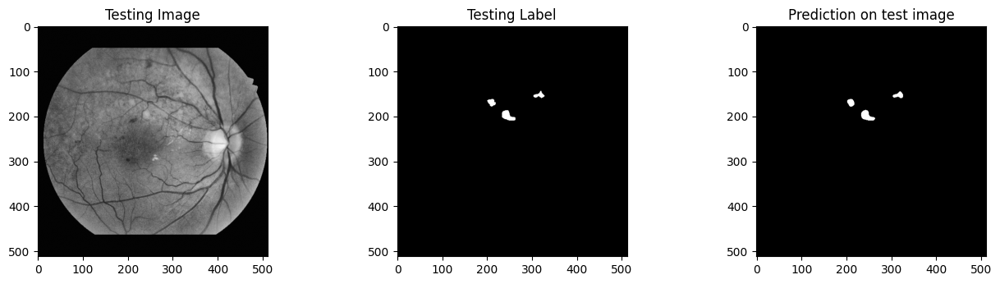

IoU1= 0.9250021
IoU2= 0.92648757
IoU3 = 0.8392916
IoU4 = 0.8821566
IoU5 = 0.92400354
IoUW = 0.94999766
Accuracy: 0.912109375
Precision: 0.9463036894295992
Sensitivity: 0.9594272076372315
Recall: 0.9594272076372315
F1 Score: 0.9395299860774878
Specificity: 0.9997895188017114
AUC: 0.9796083632194715
0.94999766
1/1 [==============================] - 0s 42ms/step
(5, 512, 512)


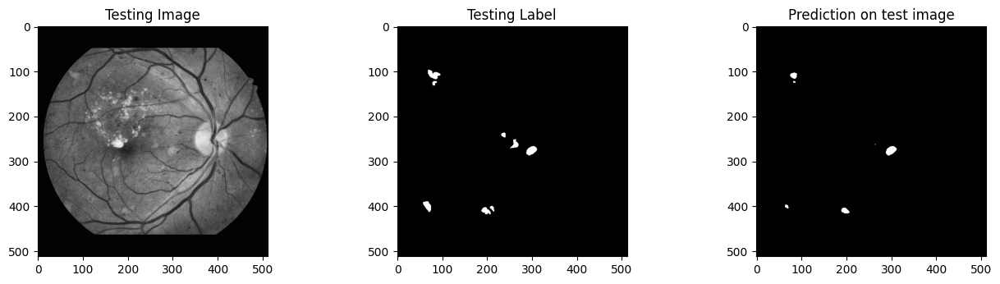

IoU1= 0.5247071
IoU2= 0.9148886
IoU3 = 0.7083207
IoU4 = 0.9412067
IoU5 = 0.925251
IoUW = 0.72575325
Accuracy: 0.794921875
Precision: 0.9888539213191235
Sensitivity: 0.46090273363000633
Recall: 0.46090273363000633
F1 Score: 0.5099288149827543
Specificity: 0.9999194077621838
AUC: 0.7304110706960951
0.72575325
1/1 [==============================] - 0s 42ms/step
(5, 512, 512)


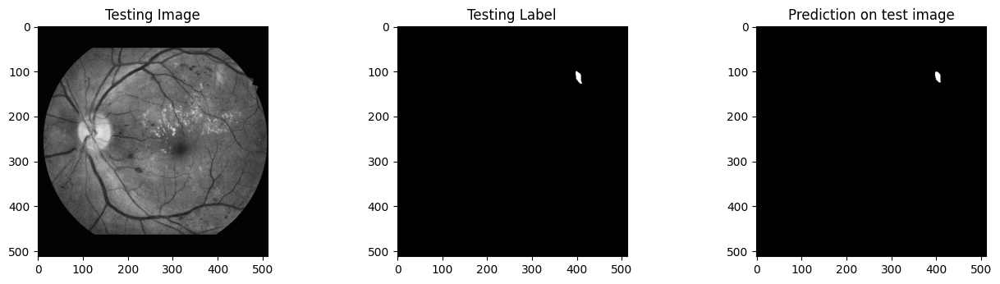

IoU1= 0.9300745
IoU2= 0.93489826
IoU3 = 0.78654337
IoU4 = 0.9563955
IoU5 = 0.8856299
IoUW = 0.9369327
Accuracy: 0.97265625
Precision: 0.9794605809128631
Sensitivity: 0.8921161825726142
Recall: 0.8921161825726142
F1 Score: 0.9233962879686071
Specificity: 0.9999809089624785
AUC: 0.9460485457675463
0.9369327
1/1 [==============================] - 0s 39ms/step
(5, 512, 512)


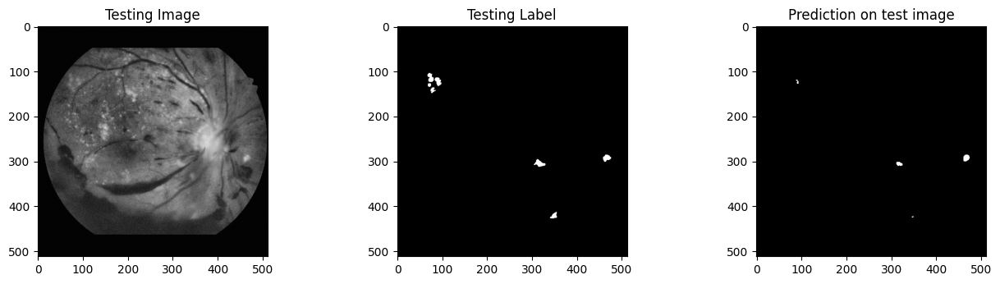

IoU1= 0.5722198
IoU2= 0.68469906
IoU3 = 0.64604926
IoU4 = 0.66667515
IoU5 = 0.65377223
IoUW = 0.63481885
Accuracy: 0.8359375
Precision: 0.9920036431230461
Sensitivity: 0.2751865671641791
Recall: 0.2751865671641791
F1 Score: 0.3157681340566127
Specificity: 0.9999616963902678
AUC: 0.6375741317772234
0.63481885
1/1 [==============================] - 0s 39ms/step
(5, 512, 512)


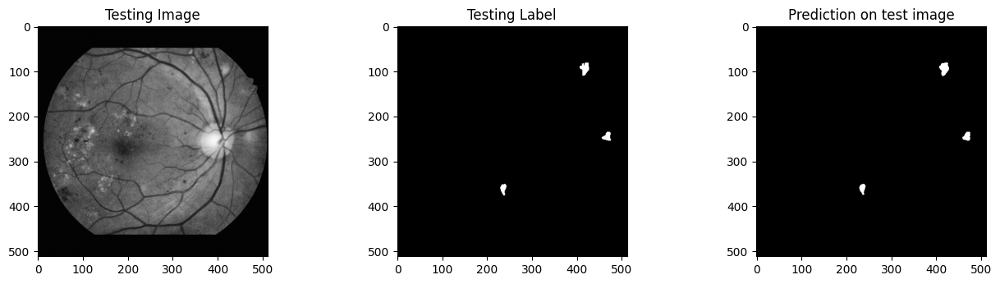

IoU1= 0.92794085
IoU2= 0.92275214
IoU3 = 0.8482299
IoU4 = 0.9205335
IoU5 = 0.9215164
IoUW = 0.94000864
Accuracy: 0.873046875
Precision: 0.9384812186586852
Sensitivity: 0.9538288288288288
Recall: 0.9538288288288288
F1 Score: 0.9352753902563767
Specificity: 0.9997167529166794
AUC: 0.976772790872754
0.94000864
1/1 [==============================] - 0s 44ms/step
(5, 512, 512)


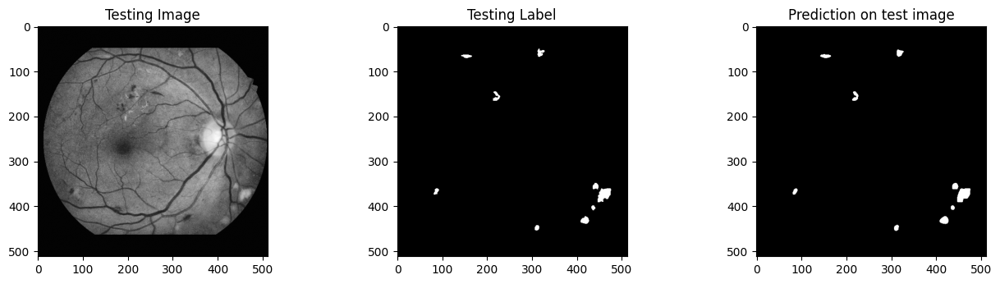

IoU1= 0.91073346
IoU2= 0.91756326
IoU3 = 0.74981064
IoU4 = 0.89648783
IoU5 = 0.9149618
IoUW = 0.9372866
Accuracy: 0.80078125
Precision: 0.9179102573698701
Sensitivity: 0.9613445378151261
Recall: 0.9613445378151261
F1 Score: 0.9316365167187032
Specificity: 0.9993278511593607
AUC: 0.9803361944872435
0.9372866
1/1 [==============================] - 0s 40ms/step
(5, 512, 512)


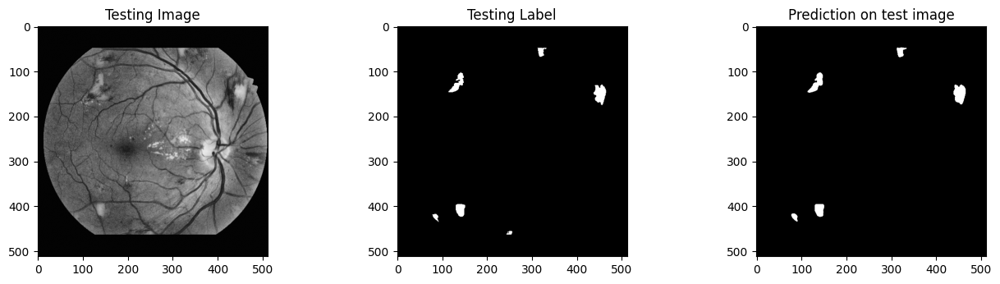

IoU1= 0.90956664
IoU2= 0.91077095
IoU3 = 0.8864154
IoU4 = 0.9024473
IoU5 = 0.9239228
IoUW = 0.93036026
Accuracy: 0.7578125
Precision: 0.9133259007864664
Sensitivity: 0.9595278246205734
Recall: 0.9595278246205734
F1 Score: 0.9153163234996298
Specificity: 0.9989683260705542
AUC: 0.9792480753455638
0.93036026
1/1 [==============================] - 0s 64ms/step
(5, 512, 512)


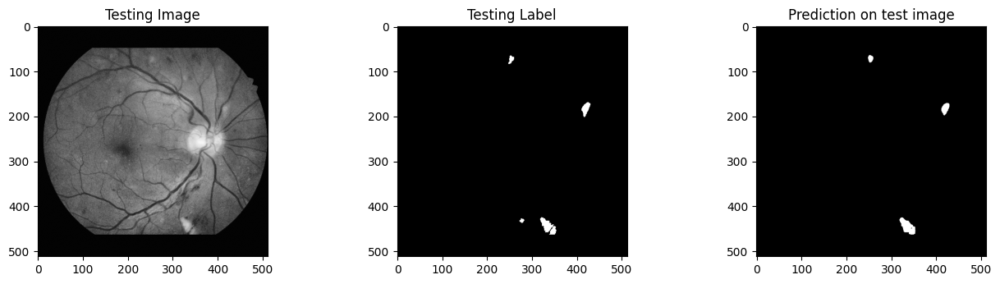

IoU1= 0.7234322
IoU2= 0.9049244
IoU3 = 0.9005524
IoU4 = 0.93159115
IoU5 = 0.9138701
IoUW = 0.9044707
Accuracy: 0.84765625
Precision: 0.9289145415214899
Sensitivity: 0.8740399385560675
Recall: 0.8740399385560675
F1 Score: 0.8655240804405593
Specificity: 0.9996051249415355
AUC: 0.9368225317488016
0.9044707
1/1 [==============================] - 0s 59ms/step
(5, 512, 512)


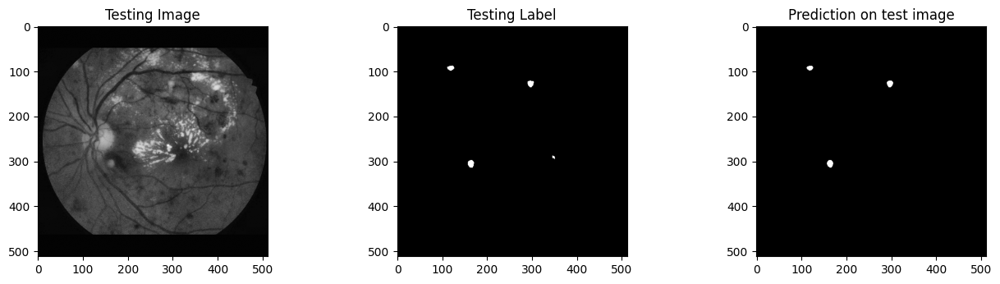

IoU1= 0.8963771
IoU2= 0.9345273
IoU3 = 0.8138808
IoU4 = 0.9317986
IoU5 = 0.94369674
IoUW = 0.93281645
Accuracy: 0.9296875
Precision: 0.9799791711556417
Sensitivity: 0.8862745098039215
Recall: 0.8862745098039215
F1 Score: 0.8948103607496469
Specificity: 0.9999541344014922
AUC: 0.9431143221027068
0.93281645
1/1 [==============================] - 0s 43ms/step
(5, 512, 512)


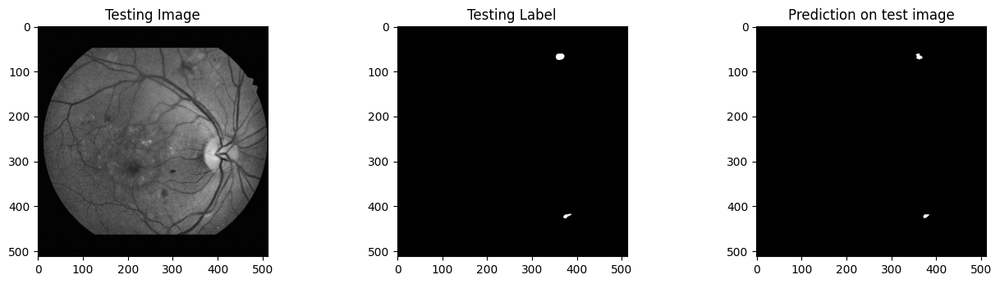

IoU1= 0.56784624
IoU2= 0.9331489
IoU3 = 0.7550812
IoU4 = 0.84554946
IoU5 = 0.93605155
IoUW = 0.8059133
Accuracy: 0.951171875
Precision: 0.9943240454076366
Sensitivity: 0.6160990712074303
Recall: 0.6160990712074303
F1 Score: 0.6959114540701635
Specificity: 0.9999923611933343
AUC: 0.8080457162003823
0.8059133
1/1 [==============================] - 0s 40ms/step
(5, 512, 512)


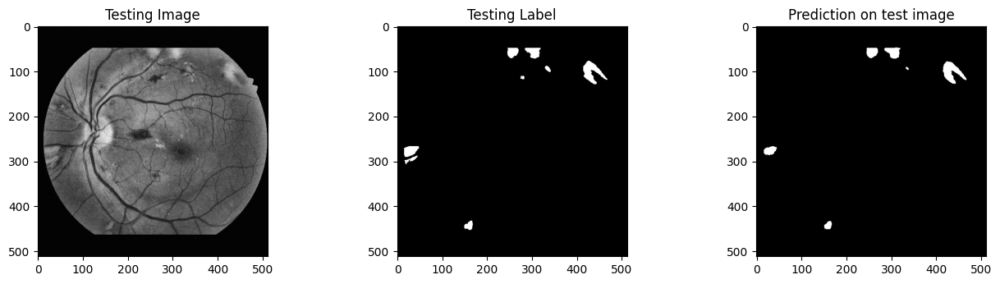

IoU1= 0.6523454
IoU2= 0.90664613
IoU3 = 0.8880831
IoU4 = 0.9123905
IoU5 = 0.9387361
IoUW = 0.8912811
Accuracy: 0.73828125
Precision: 0.9615415167252332
Sensitivity: 0.8230836490819003
Recall: 0.8230836490819003
F1 Score: 0.8497430207447555
Specificity: 0.9993660929292305
AUC: 0.9112248710055654
0.8912811
1/1 [==============================] - 0s 47ms/step
(5, 512, 512)


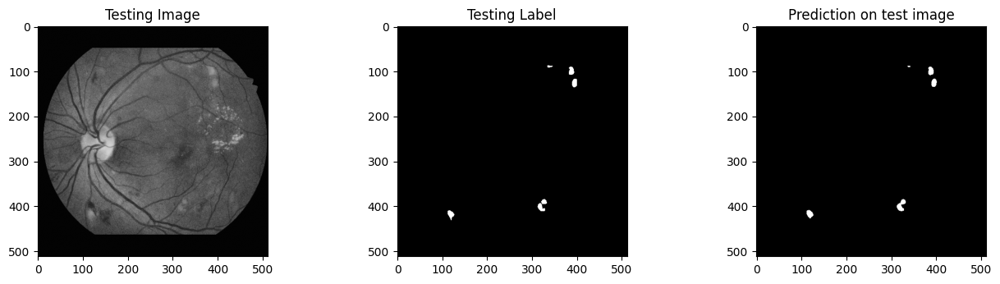

IoU1= 0.91083705
IoU2= 0.9009303
IoU3 = 0.78590673
IoU4 = 0.91633177
IoU5 = 0.9367589
IoUW = 0.9276295
Accuracy: 0.876953125
Precision: 0.9403239232937957
Sensitivity: 0.9170454545454545
Recall: 0.9170454545454545
F1 Score: 0.9112029569714629
Specificity: 0.9997588645967297
AUC: 0.9584021595710921
0.9276295
1/1 [==============================] - 0s 41ms/step
(5, 512, 512)


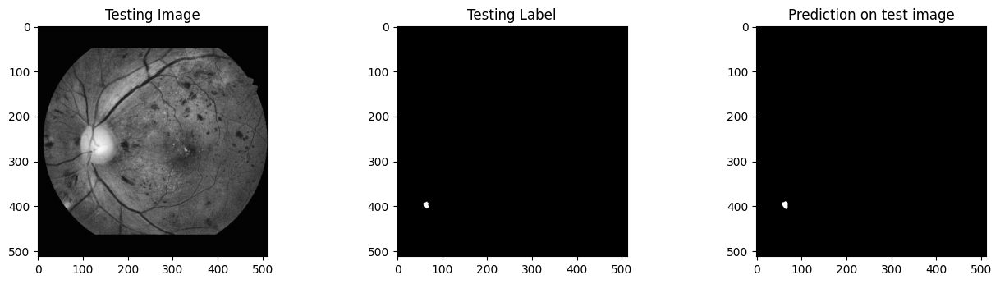

IoU1= 0.84329784
IoU2= 0.8047254
IoU3 = 0.8199141
IoU4 = 0.8930169
IoU5 = 0.79325926
IoUW = 0.8955066
Accuracy: 0.966796875
Precision: 0.8349331465919702
Sensitivity: 1.0
Recall: 1.0
F1 Score: 0.9040402690548852
Specificity: 0.9998740549349475
AUC: 0.9999370274674738
0.8955066
1/1 [==============================] - 0s 45ms/step
(5, 512, 512)


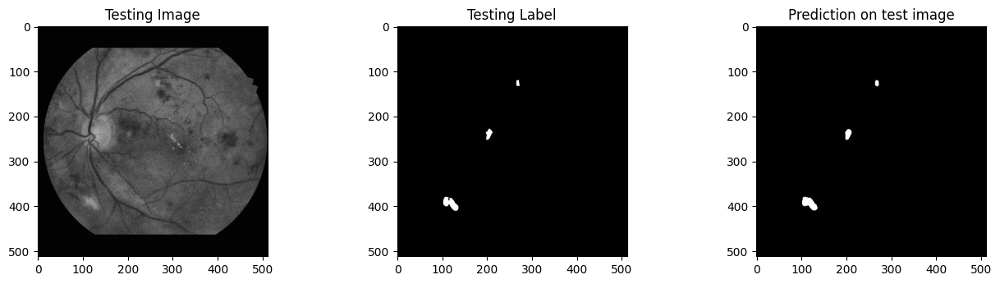

IoU1= 0.91313356
IoU2= 0.9142254
IoU3 = 0.8132806
IoU4 = 0.918118
IoU5 = 0.94411963
IoUW = 0.94288546
Accuracy: 0.88671875
Precision: 0.9267150606162367
Sensitivity: 0.9799554565701559
Recall: 0.9799554565701559
F1 Score: 0.9492076661007497
Specificity: 0.9996363580686403
AUC: 0.9897959073193979
0.94288546
1/1 [==============================] - 0s 61ms/step
(5, 512, 512)


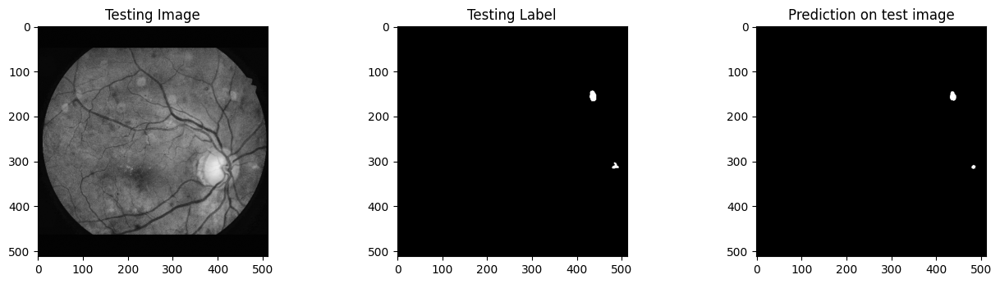

IoU1= 0.56601673
IoU2= 0.91208065
IoU3 = 0.6914094
IoU4 = 0.8690534
IoU5 = 0.9319372
IoUW = 0.81573987
Accuracy: 0.923828125
Precision: 0.9765853515853515
Sensitivity: 0.6584766584766585
Recall: 0.6584766584766585
F1 Score: 0.7190487707228926
Specificity: 0.9999350493052186
AUC: 0.8292058538909385
0.81573987
1/1 [==============================] - 0s 67ms/step
(5, 512, 512)


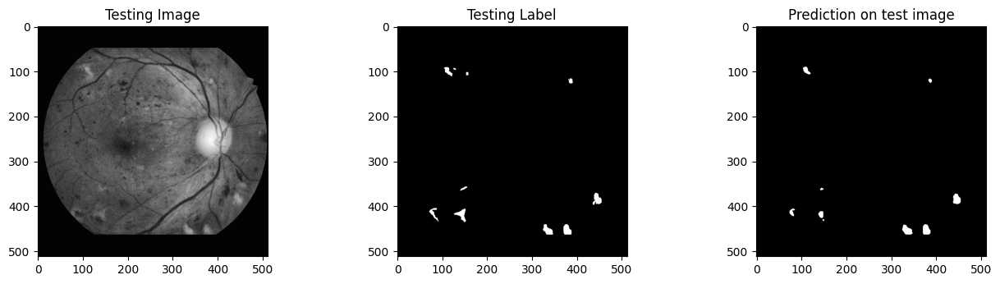

IoU1= 0.69370186
IoU2= 0.8844681
IoU3 = 0.78763986
IoU4 = 0.90413195
IoU5 = 0.9058834
IoUW = 0.8426578
Accuracy: 0.771484375
Precision: 0.9444073490872077
Sensitivity: 0.7261587639850826
Recall: 0.7261587639850826
F1 Score: 0.7566893365490992
Specificity: 0.9995965681396413
AUC: 0.8628776660623619
0.8426578
1/1 [==============================] - 0s 45ms/step
(5, 512, 512)


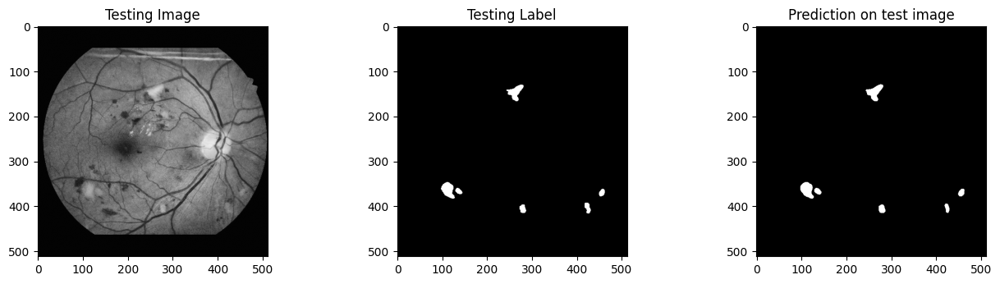

IoU1= 0.94285744
IoU2= 0.9300151
IoU3 = 0.88935244
IoU4 = 0.93707967
IoU5 = 0.95406926
IoUW = 0.9494445
Accuracy: 0.822265625
Precision: 0.9432683145218822
Sensitivity: 0.9609554432705558
Recall: 0.9609554432705558
F1 Score: 0.9416843847651681
Specificity: 0.9994306969730774
AUC: 0.9801930701218167
0.9494445
1/1 [==============================] - 0s 42ms/step
(5, 512, 512)


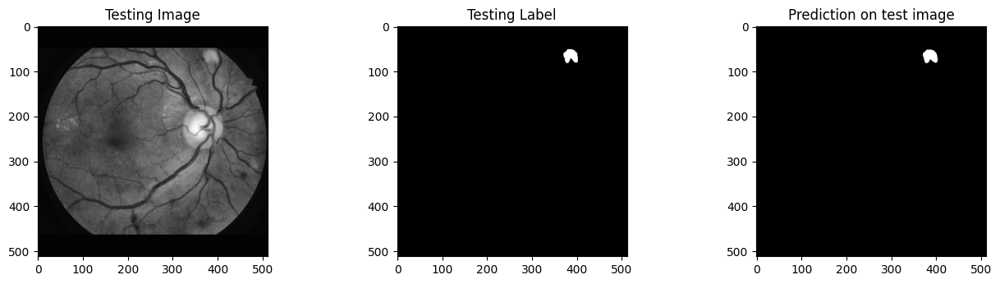

IoU1= 0.7303381
IoU2= 0.9487444
IoU3 = 0.9055431
IoU4 = 0.94494057
IoU5 = 0.96224403
IoUW = 0.965013
Accuracy: 0.962890625
Precision: 0.9624205728724404
Sensitivity: 0.975609756097561
Recall: 0.975609756097561
F1 Score: 0.9683109608797483
Specificity: 0.9998622831916636
AUC: 0.9877360196446122
0.965013
1/1 [==============================] - 0s 40ms/step
(5, 512, 512)


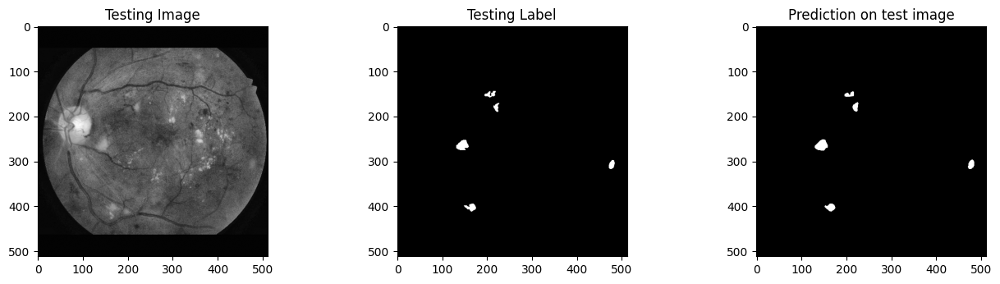

IoU1= 0.88750875
IoU2= 0.8746172
IoU3 = 0.8237152
IoU4 = 0.8844251
IoU5 = 0.9272461
IoUW = 0.91254747
Accuracy: 0.802734375
Precision: 0.895336826579033
Sensitivity: 0.937844217151849
Recall: 0.937844217151849
F1 Score: 0.9068941672715063
Specificity: 0.9993406753477746
AUC: 0.9685924462498119
0.91254747
1/1 [==============================] - 0s 43ms/step
(5, 512, 512)


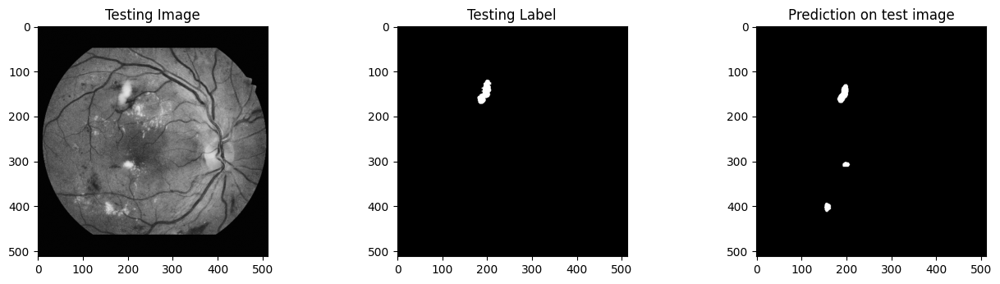

IoU1= 0.6982368
IoU2= 0.58249635
IoU3 = 0.7237167
IoU4 = 0.76088727
IoU5 = 0.7981844
IoUW = 0.7360545
Accuracy: 0.83203125
Precision: 0.757756489105571
Sensitivity: 0.6702702702702703
Recall: 0.6702702702702703
F1 Score: 0.693536015482768
Specificity: 0.9985414537227384
AUC: 0.8344058619965043
0.7360545
1/1 [==============================] - 0s 58ms/step
(5, 512, 512)


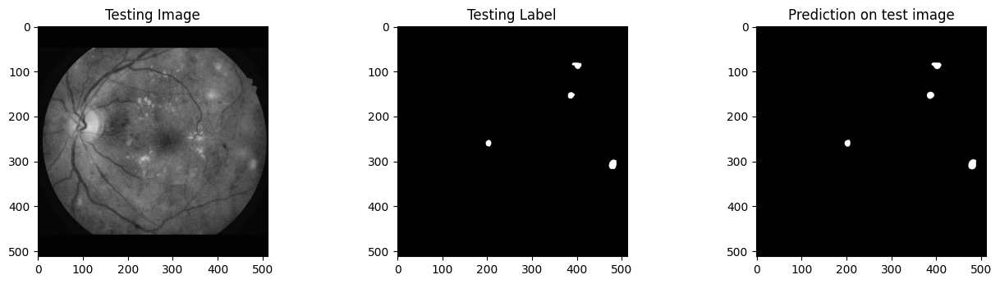

IoU1= 0.8970163
IoU2= 0.9123161
IoU3 = 0.8990946
IoU4 = 0.90860975
IoU5 = 0.93865037
IoUW = 0.94100404
Accuracy: 0.88671875
Precision: 0.9060627019126685
Sensitivity: 0.9987562189054726
Recall: 0.9987562189054726
F1 Score: 0.948087928314613
Specificity: 0.9995943981020893
AUC: 0.9991753085037809
0.94100404
1/1 [==============================] - 0s 69ms/step
(5, 512, 512)


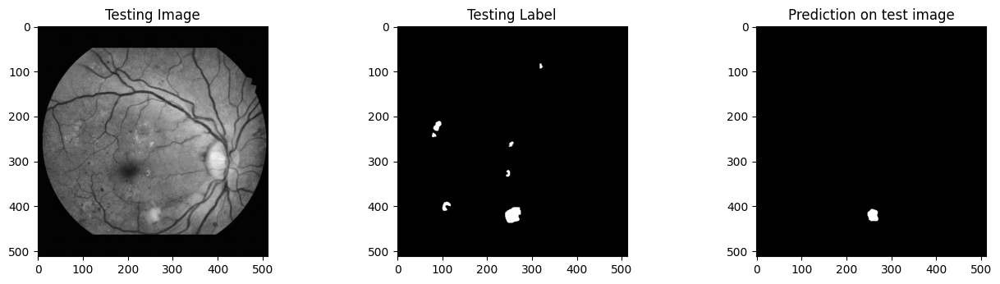

IoU1= 0.61227655
IoU2= 0.6732022
IoU3 = 0.65141153
IoU4 = 0.76855147
IoU5 = 0.7054843
IoUW = 0.65010923
Accuracy: 0.771484375
Precision: 1.0
Sensitivity: 0.30477855477855476
Recall: 0.30477855477855476
F1 Score: 0.3706383300853488
Specificity: 1.0
AUC: 0.6523892773892774
0.65010923
1/1 [==============================] - 0s 63ms/step
(5, 512, 512)


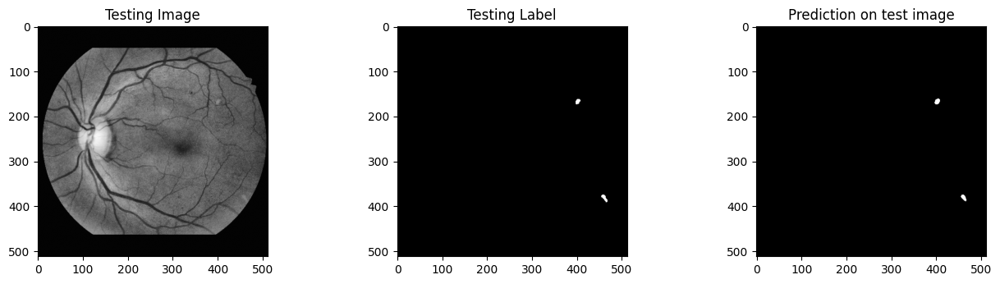

IoU1= 0.8630211
IoU2= 0.89094365
IoU3 = 0.62641907
IoU4 = 0.8453562
IoU5 = 0.9108951
IoUW = 0.90111613
Accuracy: 0.94921875
Precision: 0.8988173756606936
Sensitivity: 0.9170506912442397
Recall: 0.9170506912442397
F1 Score: 0.883328573724165
Specificity: 0.9998816464129319
AUC: 0.9584661688285858
0.90111613
1/1 [==============================] - 0s 43ms/step
(5, 512, 512)


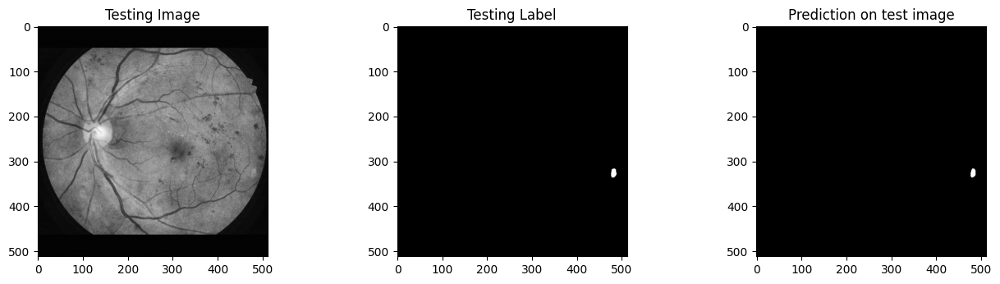

IoU1= 0.94898903
IoU2= 0.9651474
IoU3 = 0.5548118
IoU4 = 0.93772435
IoU5 = 0.97126895
IoUW = 0.94274217
Accuracy: 0.96875
Precision: 0.9861111111111112
Sensitivity: 0.898989898989899
Recall: 0.898989898989899
F1 Score: 0.92495850409726
Specificity: 0.9999885472578318
AUC: 0.9494892231238654
0.94274217
1/1 [==============================] - 0s 74ms/step
(5, 512, 512)


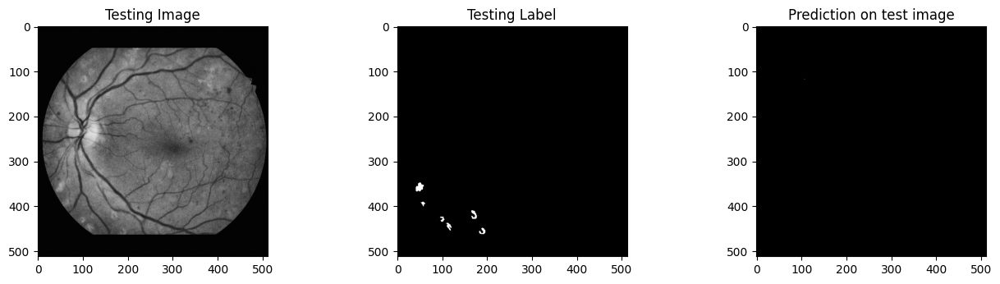

IoU1= 0.65181476
IoU2= 0.49847984
IoU3 = 0.49855232
IoU4 = 0.65097624
IoU5 = 0.4986801
IoUW = 0.4986782
Accuracy: 0.83984375
Precision: 1.0
Sensitivity: 0.0
Recall: 0.0
F1 Score: 0.0
Specificity: 0.9999961752061564
AUC: 0.4999980876030782
0.4986782
1/1 [==============================] - 0s 65ms/step
(5, 512, 512)


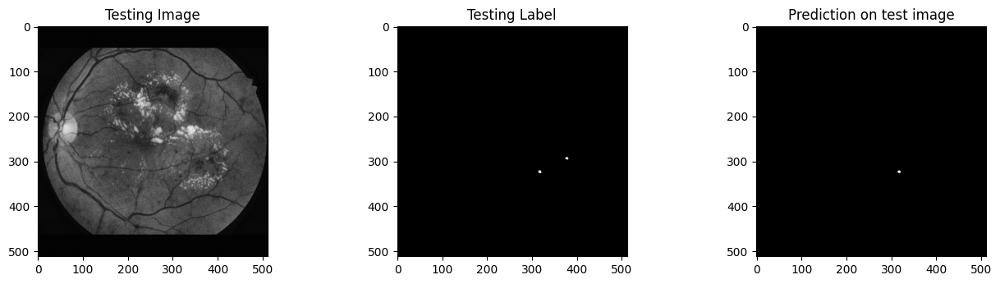

IoU1= 0.7427885
IoU2= 0.8379843
IoU3 = 0.49987793
IoU4 = 0.90503466
IoU5 = 0.8749676
IoUW = 0.7460909
Accuracy: 0.982421875
Precision: 0.984375
Sensitivity: 0.5
Recall: 0.5
F1 Score: 0.5069444444444444
Specificity: 0.9999961843711843
AUC: 0.7499980921855921
0.7460909
1/1 [==============================] - 0s 39ms/step
(5, 512, 512)


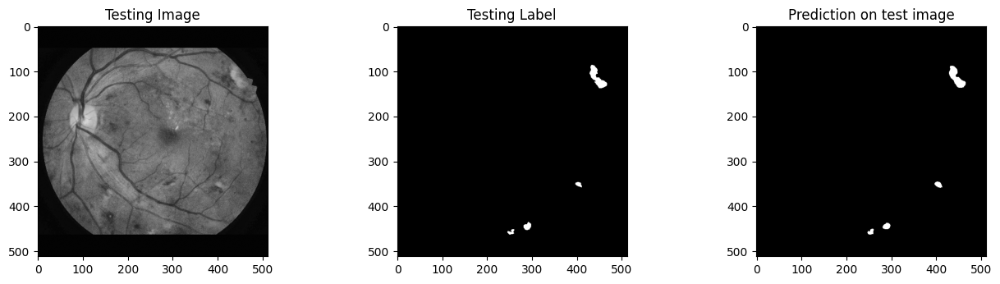

IoU1= 0.67497987
IoU2= 0.8926597
IoU3 = 0.8744887
IoU4 = 0.9193746
IoU5 = 0.9196526
IoUW = 0.914331
Accuracy: 0.8359375
Precision: 0.91545904678023
Sensitivity: 0.9256651017214398
Recall: 0.9256651017214398
F1 Score: 0.9052162164598919
Specificity: 0.9994326589130051
AUC: 0.9625488803172224
0.914331
1/1 [==============================] - 0s 40ms/step
(5, 512, 512)


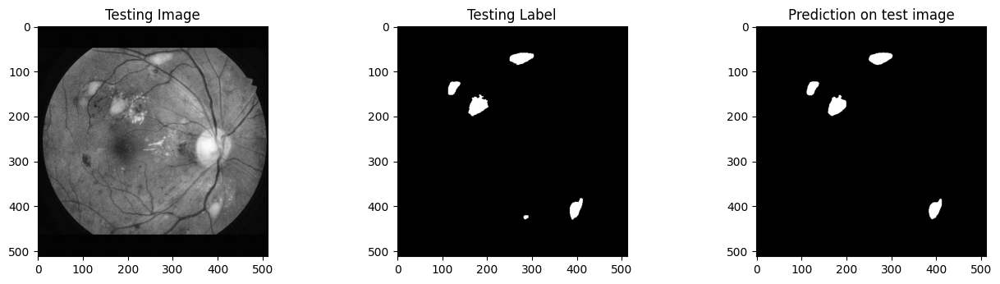

IoU1= 0.6781905
IoU2= 0.94503784
IoU3 = 0.9511341
IoU4 = 0.92767215
IoU5 = 0.9629934
IoUW = 0.95171833
Accuracy: 0.7265625
Precision: 0.9717621827927165
Sensitivity: 0.9348397267472413
Recall: 0.9348397267472413
F1 Score: 0.9449353474496425
Specificity: 0.999512266875179
AUC: 0.9671759968112101
0.95171833
1/1 [==============================] - 0s 62ms/step
(5, 512, 512)


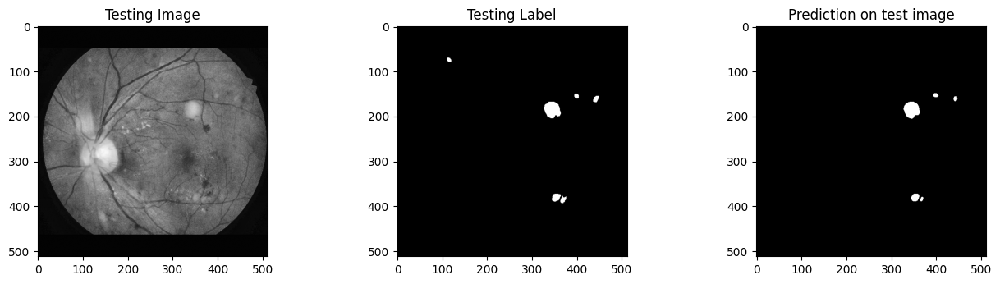

IoU1= 0.6990466
IoU2= 0.9132297
IoU3 = 0.880353
IoU4 = 0.9298976
IoU5 = 0.9417822
IoUW = 0.8973447
Accuracy: 0.841796875
Precision: 0.9746229271081386
Sensitivity: 0.8166189111747851
Recall: 0.8166189111747851
F1 Score: 0.8421789993012059
Specificity: 0.9998271882764527
AUC: 0.9082230497256188
0.8973447
1/1 [==============================] - 0s 103ms/step
(5, 512, 512)


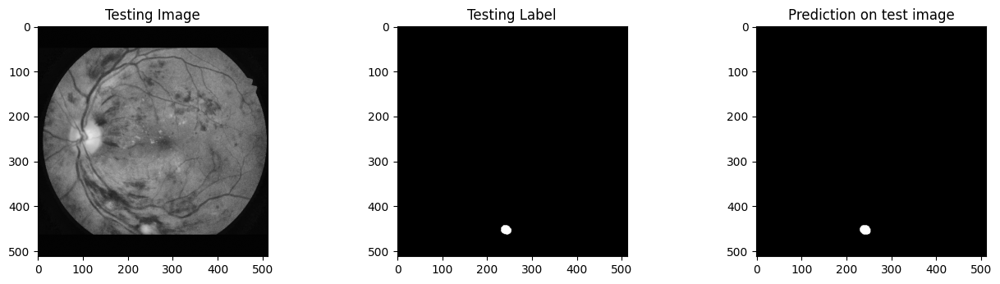

IoU1= 0.84959656
IoU2= 0.8622446
IoU3 = 0.94758844
IoU4 = 0.97527045
IoU5 = 0.9383935
IoUW = 0.9649204
Accuracy: 0.96484375
Precision: 0.9436160482417167
Sensitivity: 1.0
Recall: 1.0
F1 Score: 0.9696630996528987
Specificity: 0.9998892110681963
AUC: 0.9999446055340981
0.9649204
1/1 [==============================] - 0s 44ms/step
(5, 512, 512)


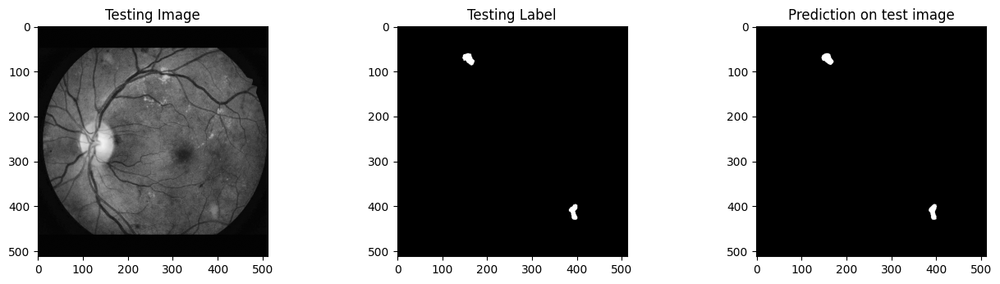

IoU1= 0.9447099
IoU2= 0.9683363
IoU3 = 0.86557436
IoU4 = 0.9701056
IoU5 = 0.98091125
IoUW = 0.9662559
Accuracy: 0.916015625
Precision: 0.976542594874274
Sensitivity: 0.9559322033898305
Recall: 0.9559322033898305
F1 Score: 0.958983799833613
Specificity: 0.9999157923746168
AUC: 0.9779239978822236
0.9662559
1/1 [==============================] - 0s 41ms/step
(5, 512, 512)


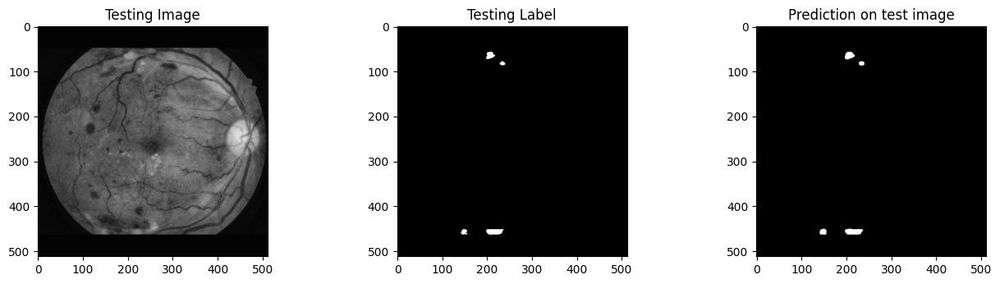

IoU1= 0.87123996
IoU2= 0.86979336
IoU3 = 0.7837143
IoU4 = 0.90828943
IoU5 = 0.8856595
IoUW = 0.9274269
Accuracy: 0.9296875
Precision: 0.8870774936864686
Sensitivity: 0.9988109393579072
Recall: 0.9988109393579072
F1 Score: 0.9361269503473953
Specificity: 0.9994603965511303
AUC: 0.9991356679545188
0.9274269
1/1 [==============================] - 0s 42ms/step
(5, 512, 512)


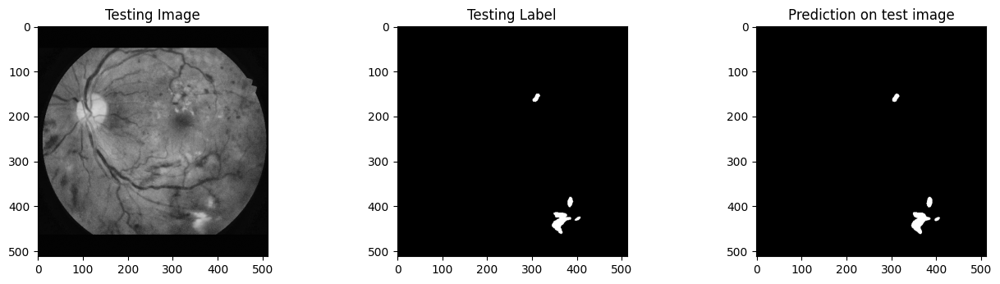

IoU1= 0.9214966
IoU2= 0.9278065
IoU3 = 0.8272097
IoU4 = 0.91372263
IoU5 = 0.92076695
IoUW = 0.9501575
Accuracy: 0.857421875
Precision: 0.9312170412782798
Sensitivity: 0.970647098065377
Recall: 0.970647098065377
F1 Score: 0.9456524329511782
Specificity: 0.9995549502196475
AUC: 0.9851010241425123
0.9501575
1/1 [==============================] - 0s 42ms/step
(5, 512, 512)


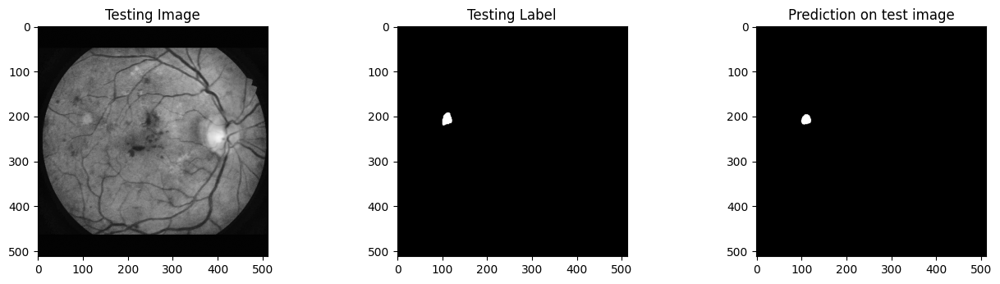

IoU1= 0.69236964
IoU2= 0.9058262
IoU3 = 0.9101752
IoU4 = 0.961765
IoU5 = 0.9608611
IoUW = 0.9101752
Accuracy: 0.9609375
Precision: 0.995619344972601
Sensitivity: 0.8241525423728814
Recall: 0.8241525423728814
F1 Score: 0.8991802140545261
Specificity: 0.9999923568436822
AUC: 0.9120724496082818
0.9101752
1/1 [==============================] - 0s 53ms/step
(5, 512, 512)


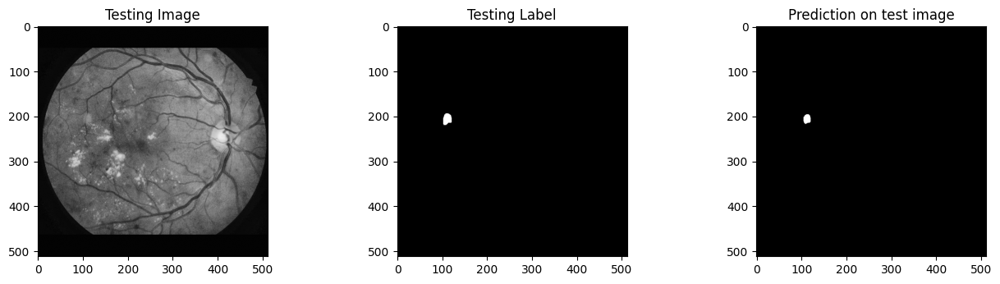

IoU1= 0.5911092
IoU2= 0.951962
IoU3 = 0.8233757
IoU4 = 0.93558764
IoU5 = 0.9745976
IoUW = 0.8525704
Accuracy: 0.94921875
Precision: 0.9973282442748092
Sensitivity: 0.7073791348600509
Recall: 0.7073791348600509
F1 Score: 0.7664014039206491
Specificity: 0.9999961795752452
AUC: 0.853687657217648
0.8525704
1/1 [==============================] - 0s 71ms/step
(5, 512, 512)


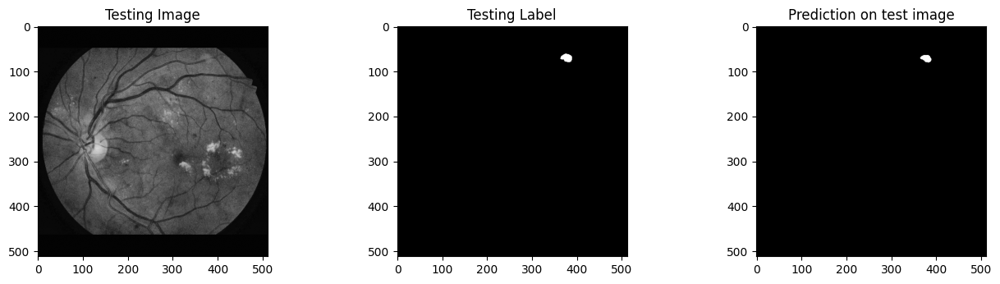

IoU1= 0.49932098
IoU2= 0.9081863
IoU3 = 0.81546867
IoU4 = 0.93193185
IoU5 = 0.9598891
IoUW = 0.89408374
Accuracy: 0.9609375
Precision: 0.9725273817392126
Sensitivity: 0.8061797752808989
Recall: 0.8061797752808989
F1 Score: 0.8743771454907595
Specificity: 0.9999694409216618
AUC: 0.9030746081012804
0.89408374
1/1 [==============================] - 0s 56ms/step
(5, 512, 512)


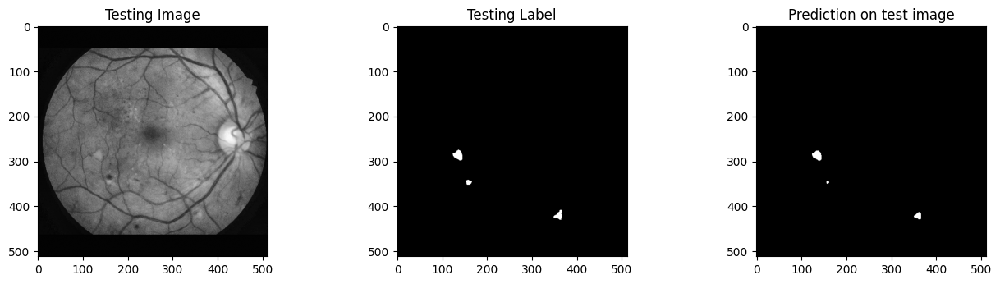

IoU1= 0.71425295
IoU2= 0.9406123
IoU3 = 0.83941674
IoU4 = 0.9431307
IoU5 = 0.9419873
IoUW = 0.8829263
Accuracy: 0.90625
Precision: 0.9840053357495219
Sensitivity: 0.7776162790697675
Recall: 0.7776162790697675
F1 Score: 0.823634099491725
Specificity: 0.9999617526467168
AUC: 0.8887890158582421
0.8829263
1/1 [==============================] - 0s 82ms/step
(5, 512, 512)


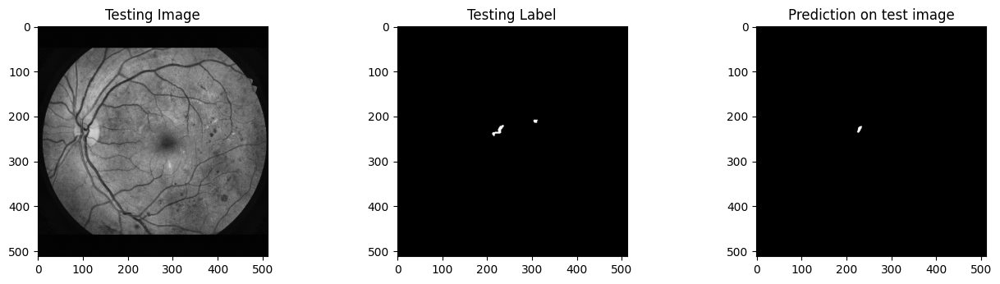

IoU1= 0.80102134
IoU2= 0.66070336
IoU3 = 0.49949646
IoU4 = 0.8959526
IoU5 = 0.931021
IoUW = 0.66070336
Accuracy: 0.939453125
Precision: 0.9781144781144782
Sensitivity: 0.32575757575757575
Recall: 0.32575757575757575
F1 Score: 0.37597091549424205
Specificity: 0.9999885443714679
AUC: 0.6628730600645218
0.66070336
1/1 [==============================] - 0s 42ms/step
(5, 512, 512)


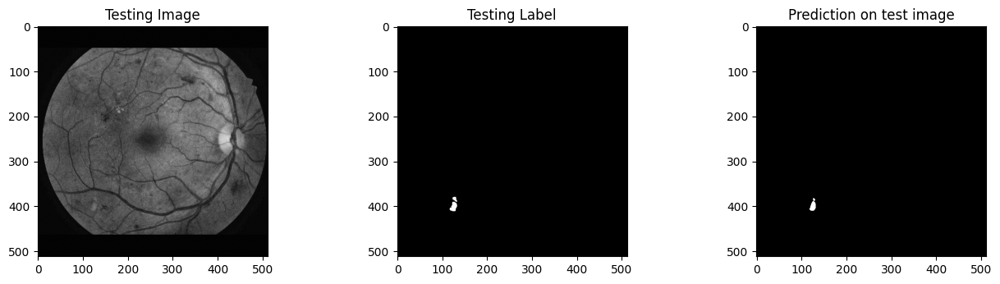

IoU1= 0.74413717
IoU2= 0.8982506
IoU3 = 0.8417484
IoU4 = 0.8988031
IoU5 = 0.9244779
IoUW = 0.8466879
Accuracy: 0.943359375
Precision: 0.9294984920323653
Sensitivity: 0.7302631578947368
Recall: 0.7302631578947368
F1 Score: 0.802079065052968
Specificity: 0.9999388939810572
AUC: 0.865101025937897
0.8466879
Mean IoU1: 0.775617
Mean IoU2: 0.8662388
Mean IoU3: 0.7842658
Mean IoU4: 0.8973239
Mean IoU5: 0.90266514
Mean IoUW: 0.8665207
Mean Accuracy: 0.88427734375
Mean Precision: 0.9488900580248106
Mean Sensitivity: 0.7862757331335143
Mean Recall: 0.7862757331335143
Mean F1 Score: 0.7974238997789722
Mean Specificity: 0.9997363690944379
Mean AUC: 0.8930060511139761


In [ ]:
#Calculate IoU for all test images and average

import pandas as pd
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score

# Loop through all images in X_test
IoU1_values = []
IoU2_values = []
IoU3_values = []
IoU4_values = []
IoU5_values = []
IoUW_values = []
accuracy_values = []
precision_values = []
sensitivity_values = []
f1_score_values = []
specificity_values = []
recall_vaules = []
auc_values = []
aupr_values = []
model1 = build_resnet50_unet_model
model2 = load_model('/content/drive/MyDrive/important retinafiles(SE)/DenseNet121.hdf5', compile=False)
model3 = load_model('/content/drive/MyDrive/important retinafiles(SE)/resnet50.hdf5', compile=False)
model4 = load_model('/content/drive/MyDrive/important retinafiles(SE)/VGG16.hdf5', compile=False)
model5 = load_model('/content/drive/MyDrive/important retinafiles(SE)/InceptionResNetV2.hdf5', compile=False)
models = [ model1, model2, model3, model4, model5]
for img in range(0, image_dataset.shape[0]):
    test_img = image_dataset[img]
    ground_truth=mask_dataset[img]
    test_img_norm=test_img[:,:,:]
    test_img_input=np.expand_dims(test_img_norm, 0)


    #Weighted average ensemble

    #Weighted average ensemble

    prediction1 = (model1.predict(test_img_input)[0,:,:,0] > 0.5).astype(np.uint8)
    prediction2 = (model2.predict(test_img_input)[0,:,:,0] > 0.5).astype(np.uint8)
    prediction3 = (model3.predict(test_img_input)[0,:,:,0] > 0.5).astype(np.uint8)
    prediction4 = (model4.predict(test_img_input)[0,:,:,0] > 0.5).astype(np.uint8)
    prediction5 = (model5.predict(test_img_input)[0,:,:,0] > 0.5).astype(np.uint8)

    preds=np.array([ prediction1,prediction2, prediction3, prediction4, prediction5])
    print(preds.shape)
    #preds=np.array(preds)
    weights = [0.1, 0.1, 0.1,0.1,0.0]
    threshold = 0.3
    weighted_preds = np.tensordot(preds, weights, axes=((0),(0)))
    weighted_ensemble_prediction = (weighted_preds > threshold).astype(int)
    plt.figure(figsize=(16, 8))
    plt.subplot(231)
    plt.title('Testing Image')
    plt.imshow(test_img, cmap='gray')
    plt.subplot(232)
    plt.title('Testing Label')
    plt.imshow(ground_truth[:,:,0], cmap='gray')
    plt.subplot(233)
    plt.title('Prediction on test image')
    plt.imshow(weighted_ensemble_prediction, cmap='gray')

    plt.show()
    n_classes = 2
    IOU_keras1 = MeanIoU(num_classes=n_classes)
    IOU_keras1.update_state(ground_truth[:,:,0], prediction1)
    IOU1 = IOU_keras1.result().numpy()
    print("IoU1=", IOU1)
    IOU_keras2 = MeanIoU(num_classes=n_classes)
    IOU_keras2.update_state(ground_truth[:,:,0], prediction2)
    IOU2 = IOU_keras2.result().numpy()
    print("IoU2=", IOU2)
    IOU_keras3 = MeanIoU(num_classes=n_classes)
    IOU_keras3.update_state(ground_truth[:,:,0], prediction3)
    IOU3 = IOU_keras3.result().numpy()
    print("IoU3 =", IOU3)
    IOU_keras4 = MeanIoU(num_classes=n_classes)
    IOU_keras4.update_state(ground_truth[:,:,0], prediction4)
    IOU4 = IOU_keras4.result().numpy()
    print("IoU4 =", IOU4)
    IOU_keras5 = MeanIoU(num_classes=n_classes)
    IOU_keras5.update_state(ground_truth[:,:,0], prediction5)
    IOU5 = IOU_keras5.result().numpy()
    print("IoU5 =", IOU5)
    IOU_kerasW = MeanIoU(num_classes=n_classes)
    IOU_kerasW.update_state(ground_truth[:,:,0], weighted_ensemble_prediction)
    IOUW = IOU_kerasW.result().numpy()
    print("IoUW =", IOUW)

    accuracy = accuracy_score(ground_truth[:,:,0], weighted_ensemble_prediction)
    precision = precision_score(ground_truth[:,:,0], weighted_ensemble_prediction, average='weighted', zero_division=1)
    sensitivity = recall_score(ground_truth[:,:,0], weighted_ensemble_prediction, average='weighted', zero_division=1)
    recall = recall_score(ground_truth[:, :, 0], weighted_ensemble_prediction, average='weighted', zero_division=1)
    f1 = f1_score(ground_truth[:, :, 0], weighted_ensemble_prediction, average='weighted', zero_division=1)
    true_negatives = np.sum((ground_truth[:, :, 0] == 0) & (weighted_ensemble_prediction == 0))
    false_positives = np.sum((ground_truth[:, :, 0] == 0) & (weighted_ensemble_prediction == 1))
    specificity = true_negatives / (true_negatives + false_positives)
    # Flatten the ground truth and prediction arrays
    ground_truth_flat = ground_truth[:,:,0].flatten()
    prediction_flat = weighted_ensemble_prediction.flatten()

    # Calculate the false positive rate (fpr) and true positive rate (tpr)
    fpr, tpr, thresholds = metrics.roc_curve(ground_truth_flat, prediction_flat)

    # Calculate the Area Under the Curve (AUC)
    auc = metrics.auc(fpr, tpr)

    print("Accuracy:", accuracy)
    print("Precision:", precision)
    print("Sensitivity:", sensitivity)
    print("Recall:", recall)
    print("F1 Score:", f1)
    print("Specificity:", specificity)
    print("AUC:", auc)
    IoU1_values.append(IOU1)
    IoU2_values.append(IOU2)
    IoU3_values.append(IOU3)
    IoU4_values.append(IOU4)
    IoU5_values.append(IOU5)
    IoUW_values.append(IOUW)
    print(IOUW)
    accuracy_values.append(accuracy)
    precision_values.append(precision)
    sensitivity_values.append(sensitivity)
    f1_score_values.append(f1)
    specificity_values.append(specificity)
    recall_vaules.append(recall)
    auc_values.append(auc)
# ...

# Create a dataframe with the IoU, accuracy, precision, and sensitivity values
df = pd.DataFrame({
    "IoU1": IoU1_values,
    "IoU2": IoU2_values,
    "IoU3": IoU3_values,
    "IoU4": IoU4_values,
    "IoU5": IoU5_values,
    "IoUW": IoUW_values,
    "Accuracy": accuracy_values,
    "Precision": precision_values,
    "Sensitivity": sensitivity_values,
    "Recall": recall_vaules,
    "F1 Score": f1_score_values,
    "Specificity": specificity_values,
    "AUC":auc_values
})



mean_IoU1 = df["IoU1"].mean()
mean_IoU2 = df["IoU2"].mean()
mean_IoU3 = df["IoU3"].mean()
mean_IoU4 = df["IoU4"].mean()
mean_IoU5 = df["IoU5"].mean()
mean_IoUW = df["IoUW"].mean()
mean_accuracy = df["Accuracy"].mean()
mean_precision = df["Precision"].mean()
mean_sensitivity = df["Sensitivity"].mean()
mean_Recall = df["Recall"].mean()
mean_F1 = df["F1 Score"].mean()
mean_Specificity= df["Specificity"].mean()
mean_auc = df["AUC"].mean()
print("Mean IoU1:", mean_IoU1)
print("Mean IoU2:", mean_IoU2)
print("Mean IoU3:", mean_IoU3)
print("Mean IoU4:", mean_IoU4)
print("Mean IoU5:", mean_IoU5)
print("Mean IoUW:", mean_IoUW)
print("Mean Accuracy:", mean_accuracy)
print("Mean Precision:", mean_precision)
print("Mean Sensitivity:", mean_sensitivity)
print("Mean Recall:", mean_Recall)
print("Mean F1 Score:", mean_F1)
print("Mean Specificity:", mean_Specificity)
print("Mean AUC:", mean_auc)

In [ ]:
build_resnet50_unet_history_df = pd.DataFrame(df)
with open('ensemble_SoftExudates.csv', mode='w') as f:
    build_resnet50_unet_history_df.to_csv(f)

In [ ]:
df

,IoU1,IoU2,IoU3,IoU4,IoU5,IoUW,Accuracy,Precision,Sensitivity,Recall,F1 Score,Specificity,AUC
0,0.901130,0.583219,0.717984,0.949985,0.928550,0.784663,0.980469,1.000000,0.569444,0.569444,0.691144,1.000000,0.784722
1,0.925002,0.926488,0.839292,0.882157,0.924004,0.949998,0.912109,0.946304,0.959427,0.959427,0.939530,0.999790,0.979608
2,0.524707,0.914889,0.708321,0.941207,0.925251,0.725753,0.794922,0.988854,0.460903,0.460903,0.509929,0.999919,0.730411
3,0.930075,0.934898,0.786543,0.956396,0.885630,0.936933,0.972656,0.979461,0.892116,0.892116,0.923396,0.999981,0.946049
4,0.572220,0.684699,0.646049,0.666675,0.653772,0.634819,0.835938,0.992004,0.275187,0.275187,0.315768,0.999962,0.637574
5,0.927941,0.922752,0.848230,0.920533,0.921516,0.940009,0.873047,0.938481,0.953829,0.953829,0.935275,0.999717,0.976773
6,0.910733,0.917563,0.749811,0.896488,0.914962,0.937287,0.800781,0.917910,0.961345,0.961345,0.931637,0.999328,0.980336
7,0.909567,0.910771,0.886415,0.902447,0.923923,0.930360,0.757812,0.913326,0.959528,0.959528,0.915316,0.998968,0.979248
8,0.723432,0.904924,0.900552,0.931591,0.913870,0.904471,0.847656,0.928915,0.874040,0.874040,0.865524,0.999605,0.936823
9,0.896377,0.934527,0.813881,0.931799,0.943697,0.932816,0.929688,0.979979,0.886275,0.886275,0.894810,0.999954,0.943114


# **ENSEMBLE EXPERIMENT**

1/1 [==============================] - 1s 654ms/step


1/1 [==============================] - 4s 4s/step


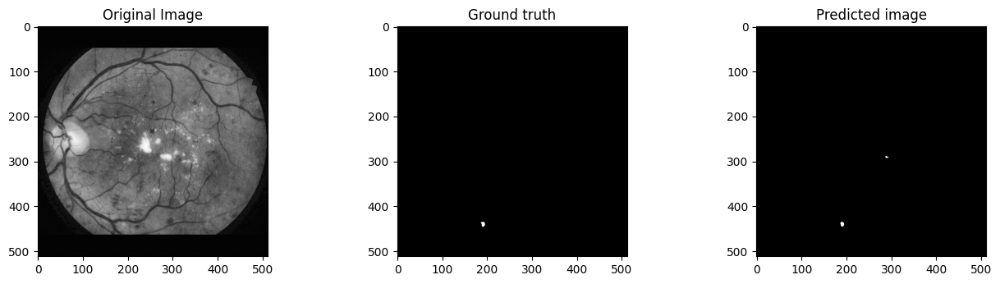

0.8473131
1/1 [==============================] - 0s 39ms/step


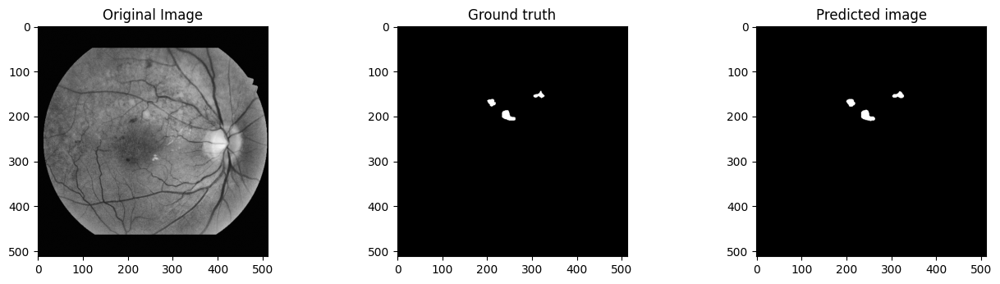

0.93322706
1/1 [==============================] - 0s 41ms/step


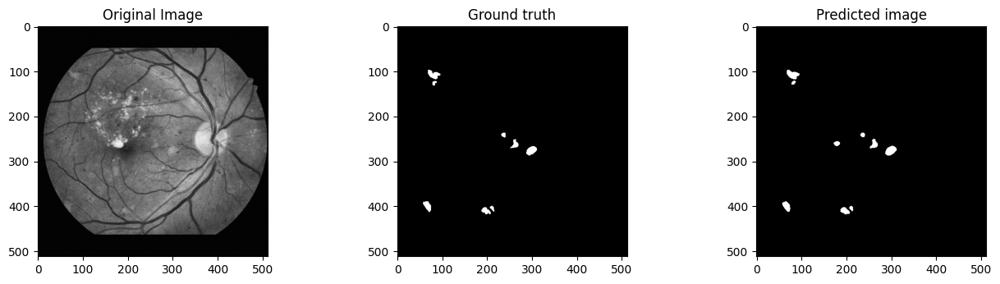

0.9057957
1/1 [==============================] - 0s 51ms/step


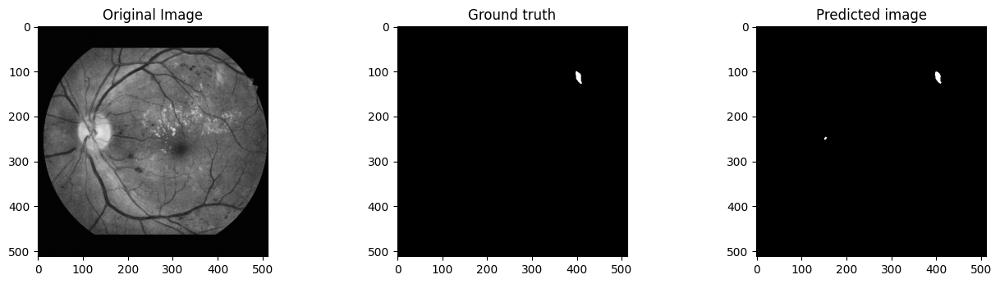

0.91991603
1/1 [==============================] - 0s 46ms/step


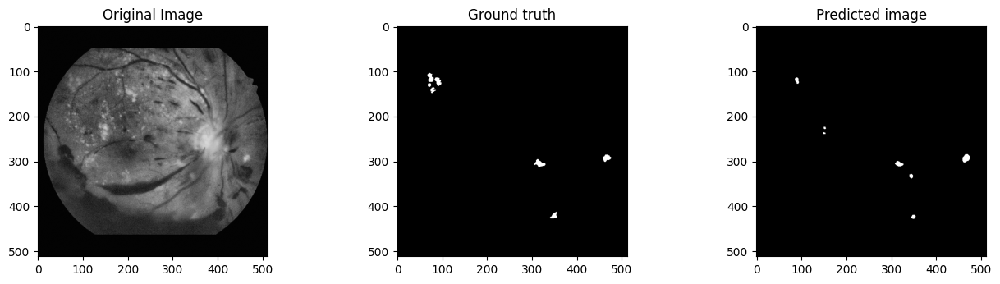

0.6929434
1/1 [==============================] - 0s 45ms/step


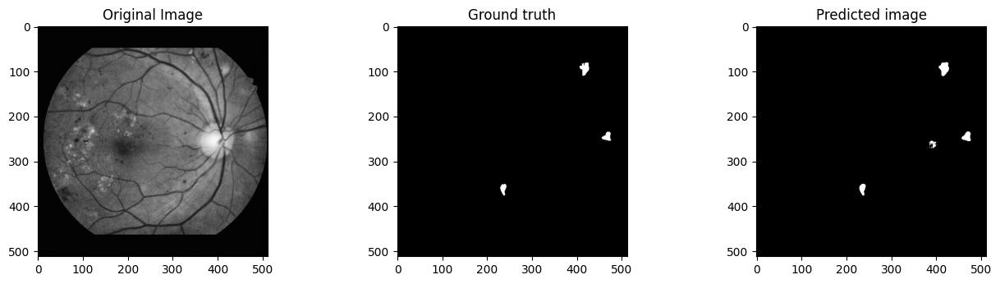

0.8792925
1/1 [==============================] - 0s 71ms/step


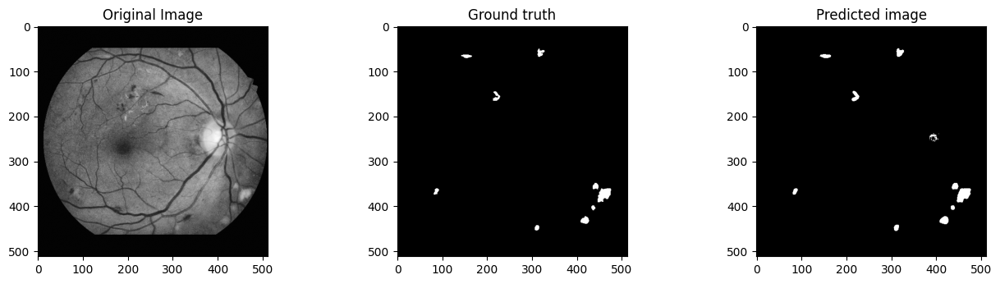

0.8995119
1/1 [==============================] - 0s 57ms/step


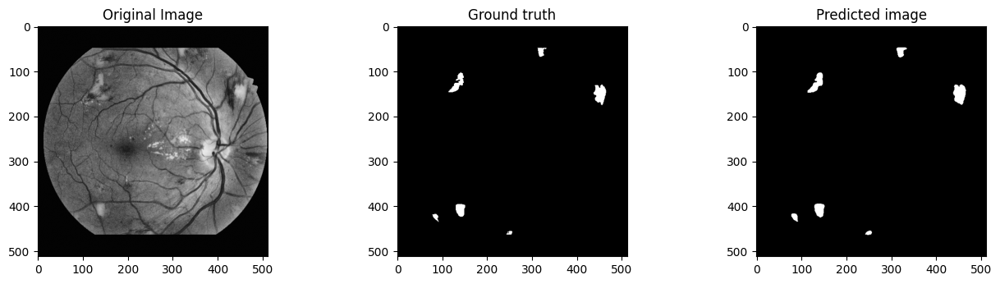

0.91474724
1/1 [==============================] - 0s 44ms/step


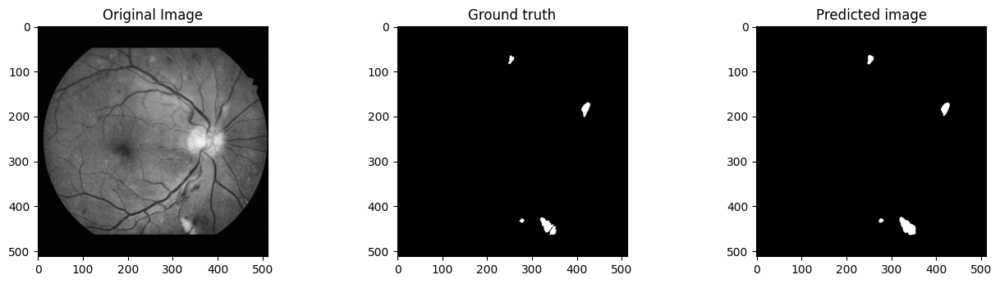

0.91843665
1/1 [==============================] - 0s 48ms/step


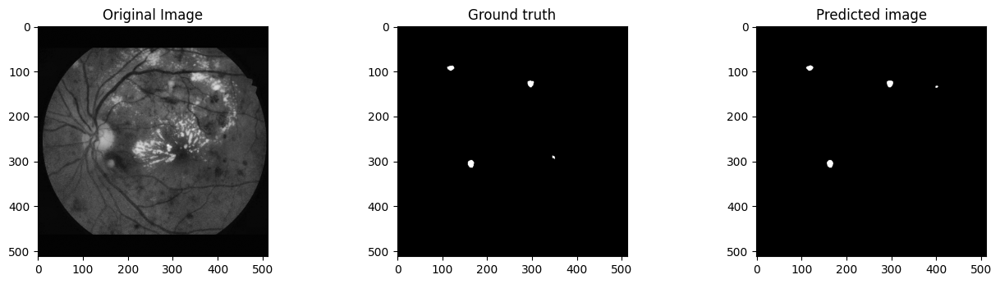

0.92493165
1/1 [==============================] - 0s 62ms/step


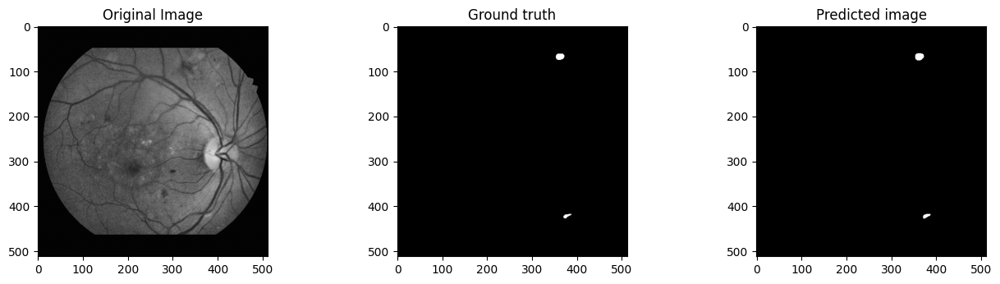

0.9298198
1/1 [==============================] - 0s 43ms/step


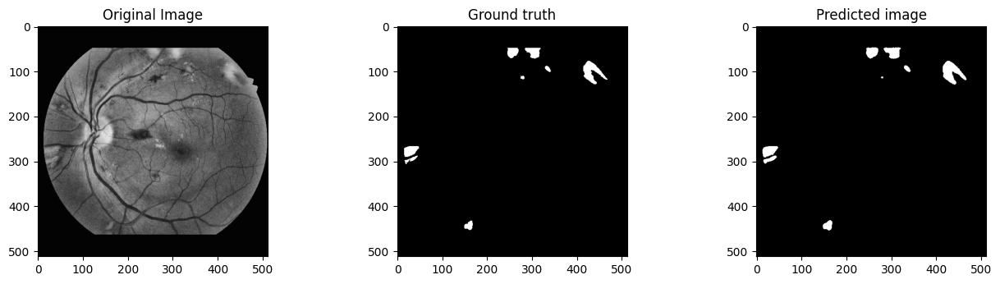

0.9227047
1/1 [==============================] - 0s 41ms/step


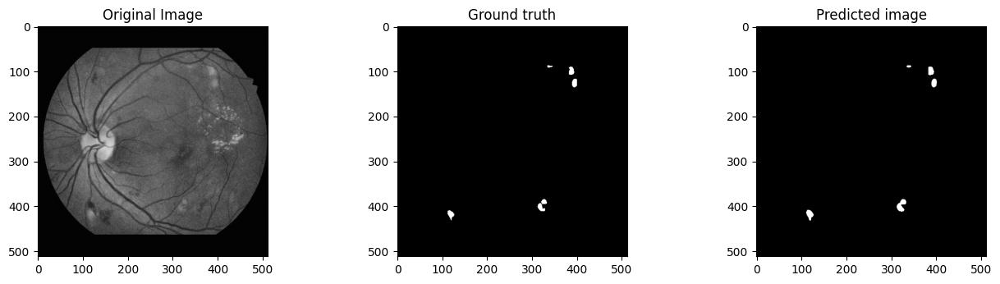

0.92112553
1/1 [==============================] - 0s 39ms/step


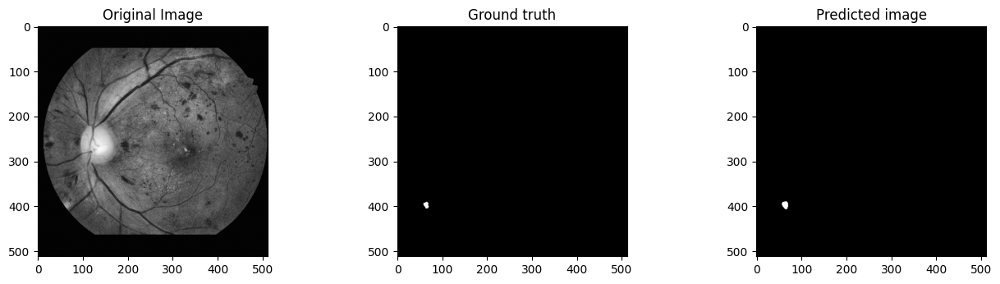

0.8359051
1/1 [==============================] - 0s 59ms/step


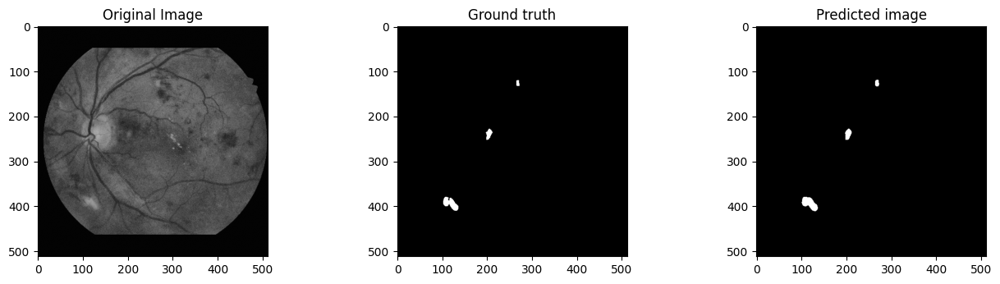

0.9236049
1/1 [==============================] - 0s 67ms/step


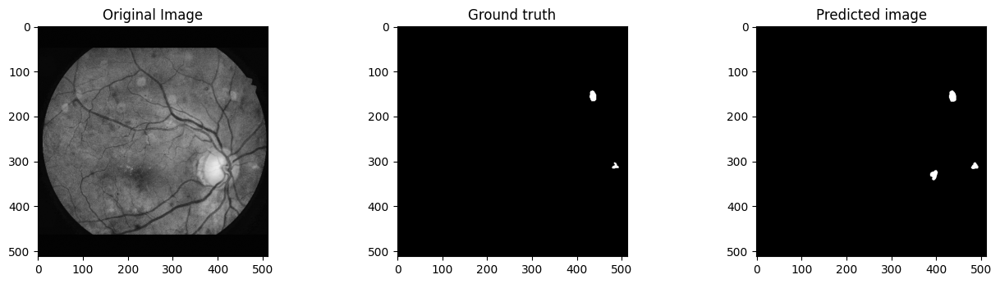

0.7723311
1/1 [==============================] - 0s 40ms/step


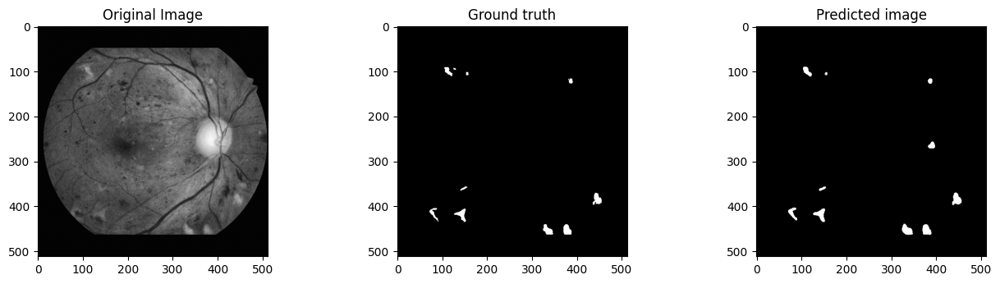

0.87532246
1/1 [==============================] - 0s 43ms/step


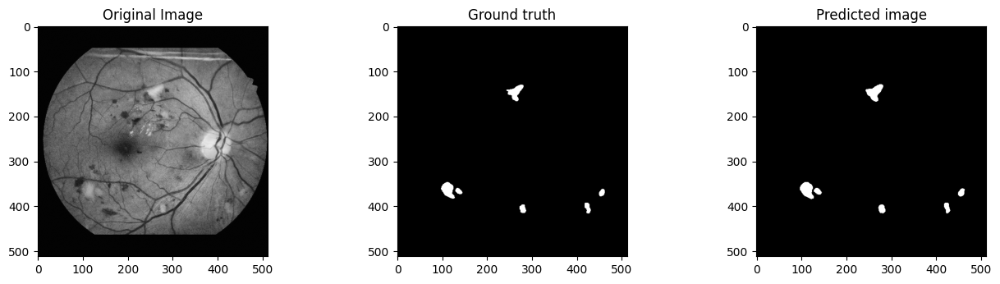

0.9349464
1/1 [==============================] - 0s 45ms/step


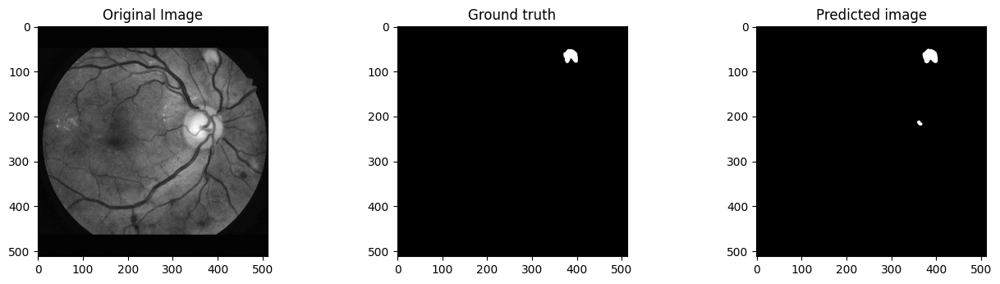

0.902498
1/1 [==============================] - 0s 44ms/step


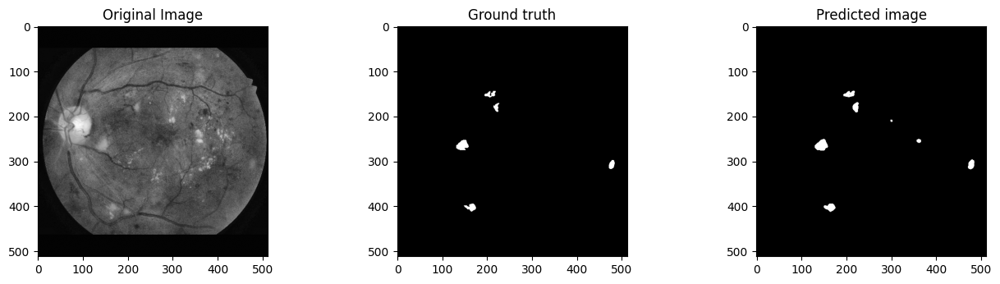

0.8808197
1/1 [==============================] - 0s 39ms/step


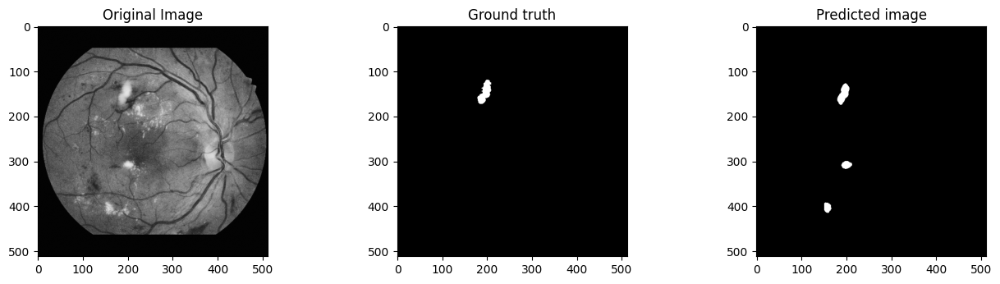

0.7245305
1/1 [==============================] - 0s 47ms/step


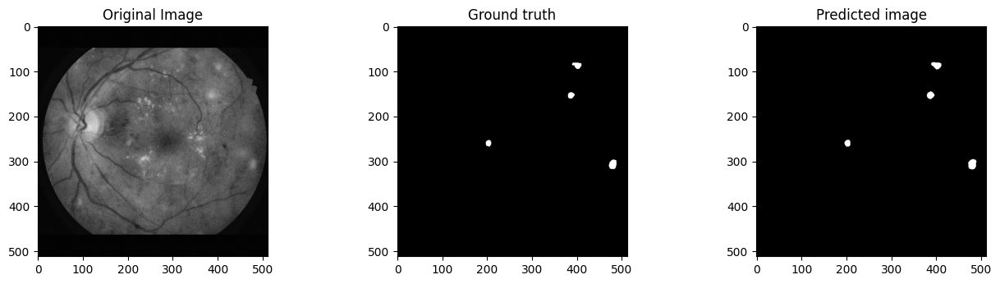

0.9149755
1/1 [==============================] - 0s 63ms/step


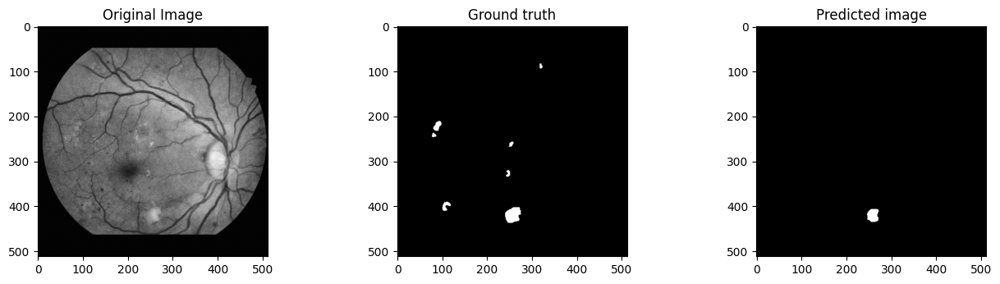

0.6754732
1/1 [==============================] - 0s 64ms/step


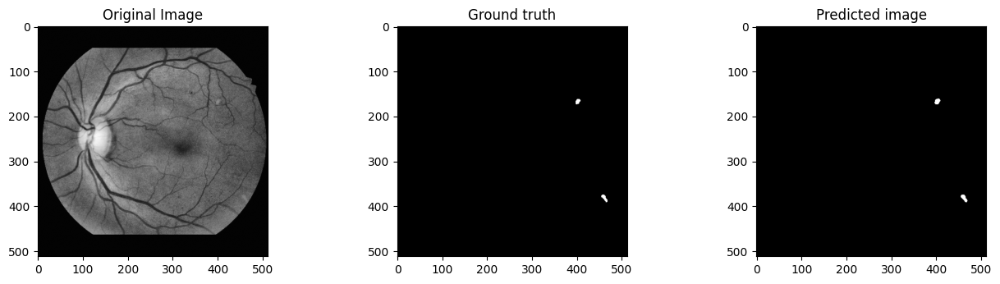

0.9062716
1/1 [==============================] - 0s 40ms/step


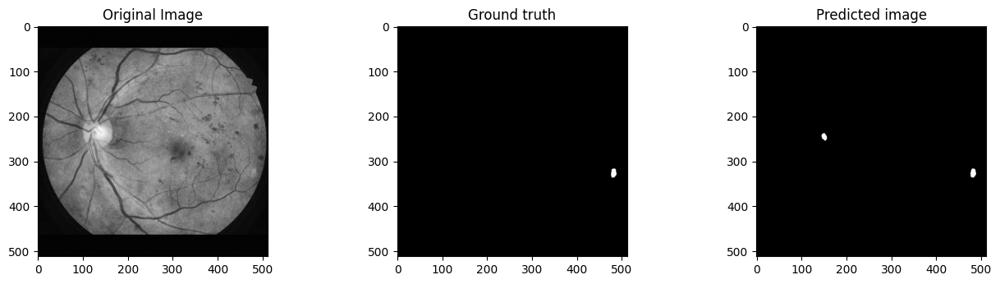

0.77942
1/1 [==============================] - 0s 50ms/step


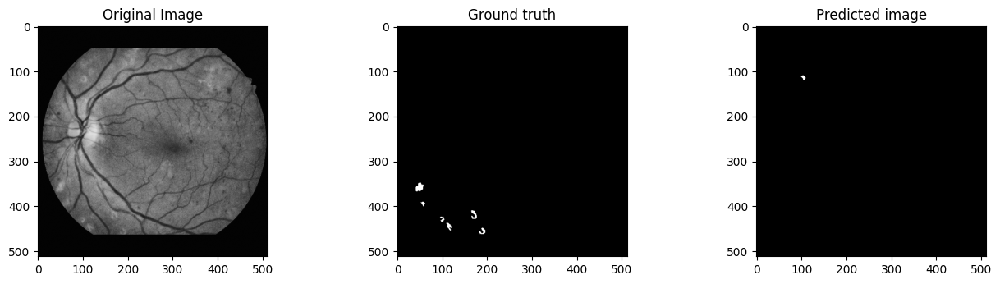

0.49855232
1/1 [==============================] - 0s 42ms/step


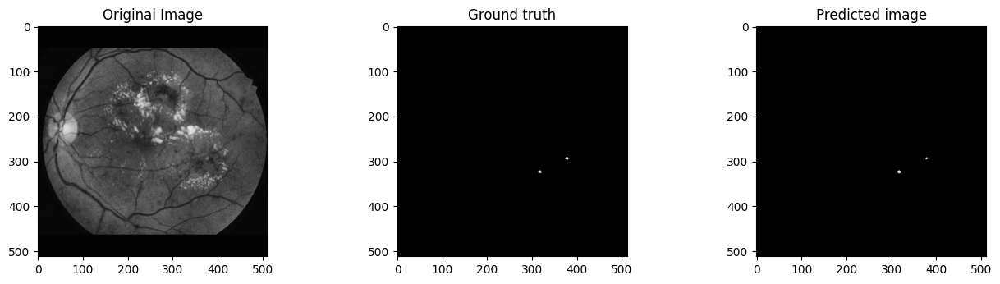

0.8656373
1/1 [==============================] - 0s 40ms/step


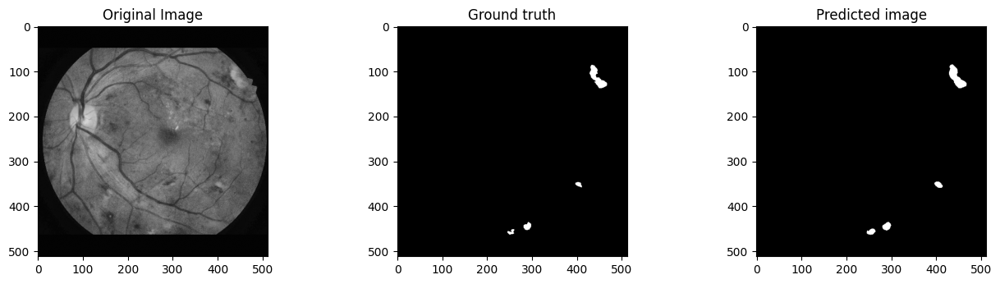

0.8968133
1/1 [==============================] - 0s 48ms/step


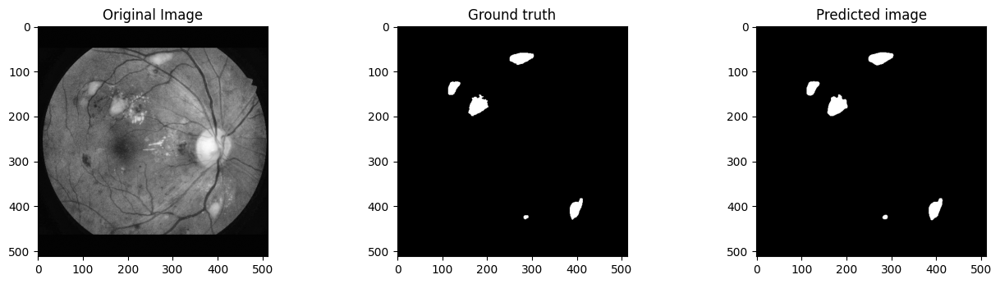

0.95151985
1/1 [==============================] - 0s 62ms/step


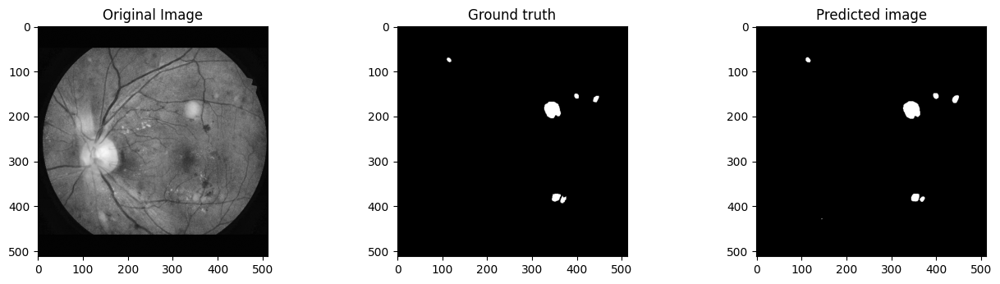

0.92093027
1/1 [==============================] - 0s 72ms/step


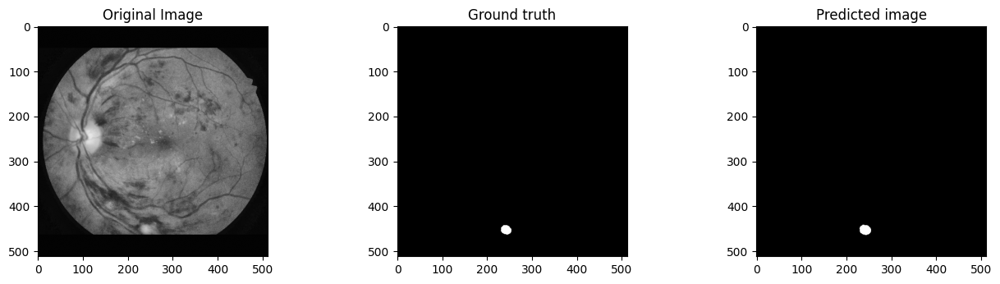

0.92108786
1/1 [==============================] - 0s 45ms/step


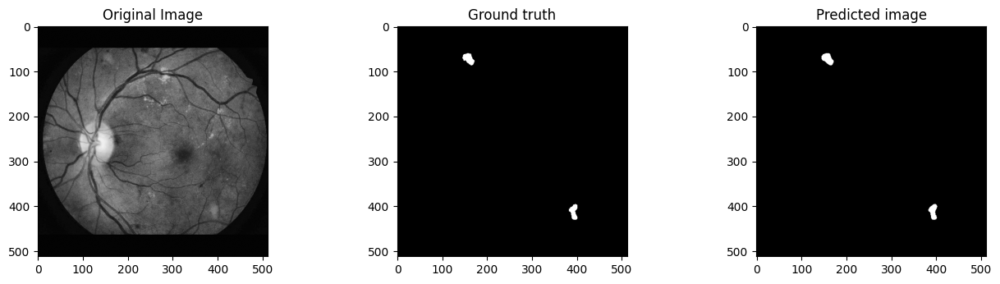

0.97095776
1/1 [==============================] - 0s 41ms/step


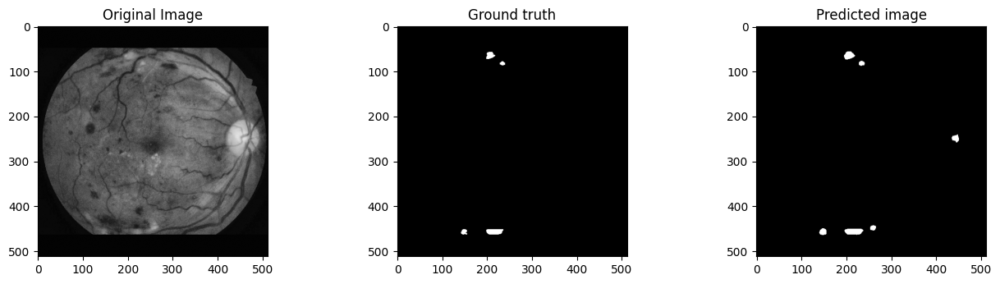

0.7971382
1/1 [==============================] - 0s 42ms/step


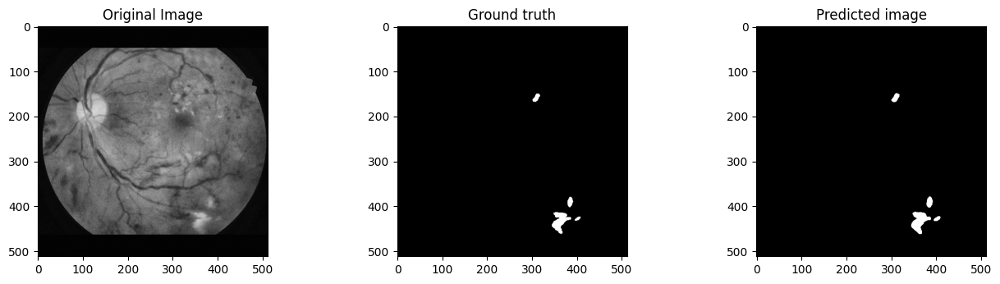

0.9253094
1/1 [==============================] - 0s 53ms/step


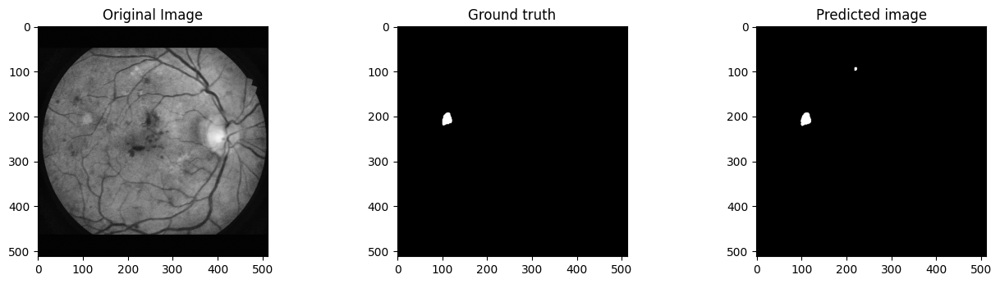

0.9257023
1/1 [==============================] - 0s 46ms/step


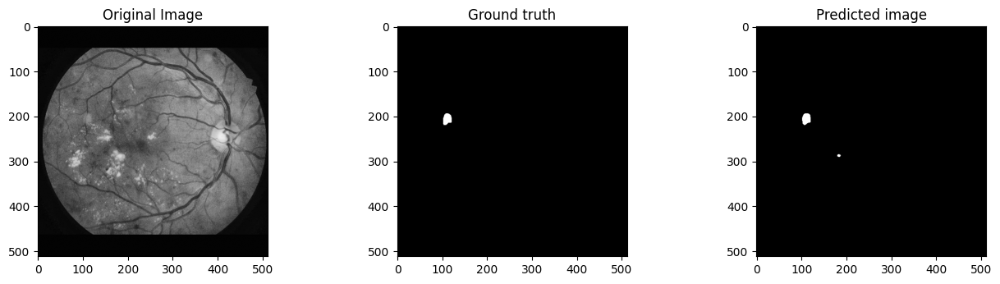

0.9236369
1/1 [==============================] - 0s 62ms/step


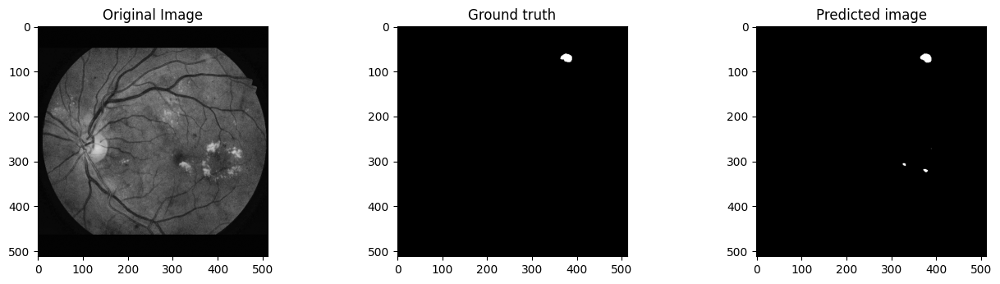

0.871263
1/1 [==============================] - 0s 62ms/step


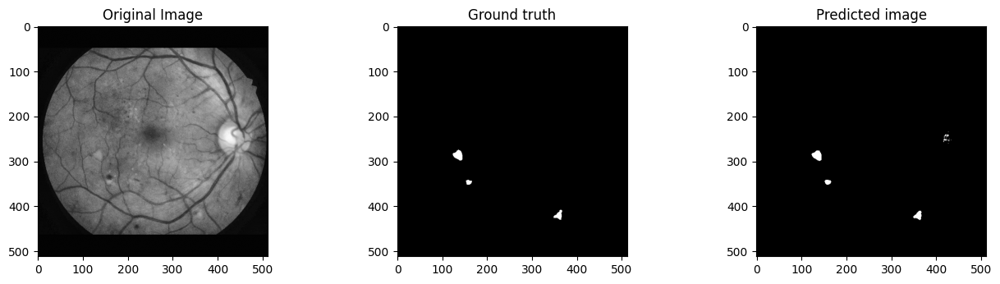

0.9034988
1/1 [==============================] - 0s 43ms/step


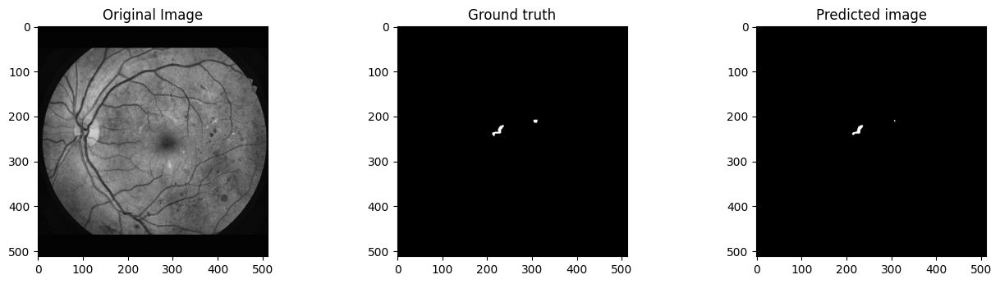

0.8415587
1/1 [==============================] - 0s 47ms/step


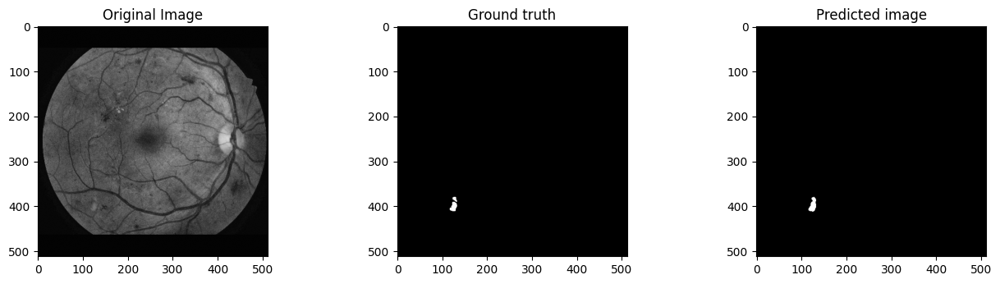

0.9126221
Mean IoU1: 0.775617
Mean IoU2: 0.8662388
Mean IoU3: 0.7842658
Mean IoU4: 0.8973239
Mean IoU5: 0.90266514
Mean IoUW: 0.8715523
Mean Accuracy: 0.8666015625
Mean Precision: [0.00384445 0.79212986 1.        ]
Mean Sensitivity: 0.9122386253771504
Mean Recall: [1.         0.91223863 0.        ]
Mean F1 Score: 0.8676256785123613
Mean Specificity: 0.9992078813011268
Mean AUC: 0.9557232533391385
Mean AUPR: 0.8523335865094964


In [ ]:
import pandas as pd
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, precision_recall_curve, auc

# Loop through all images in X_test
IoU1_values = []
IoU2_values = []
IoU3_values = []
IoU4_values = []
IoU5_values = []
IoUW_values = []
accuracy_values = []
precision_values = []
sensitivity_values = []
f1_score_values = []
specificity_values = []
recall_values = []
auc_values = []
aupr_values = []
model1 = build_resnet50_unet_model
model2 = load_model('/content/drive/MyDrive/important retinafiles(SE)/DenseNet121.hdf5', compile=False)
model3 = load_model('/content/drive/MyDrive/important retinafiles(SE)/resnet50.hdf5', compile=False)
model4 = load_model('/content/drive/MyDrive/important retinafiles(SE)/VGG16.hdf5', compile=False)
model5 = load_model('/content/drive/MyDrive/important retinafiles(SE)/InceptionResNetV2.hdf5', compile=False)
models = [ model1, model2, model3, model4, model5]
for img in range(0, image_dataset.shape[0]):
    test_img = image_dataset[img]
    ground_truth=mask_dataset[img]
    test_img_norm=test_img[:,:,:]
    test_img_input=np.expand_dims(test_img_norm, 0)

    # Weighted average ensemble
    prediction1 = (model1.predict(test_img_input)[0,:,:,0] > 0.5).astype(np.uint8)
    prediction2 = (model2.predict(test_img_input)[0,:,:,0] > 0.5).astype(np.uint8)
    prediction3 = (model3.predict(test_img_input)[0,:,:,0] > 0.5).astype(np.uint8)
    prediction4 = (model4.predict(test_img_input)[0,:,:,0] > 0.5).astype(np.uint8)
    prediction5 = (model5.predict(test_img_input)[0,:,:,0] > 0.5).astype(np.uint8)

    preds=np.array([prediction1, prediction2, prediction3, prediction4, prediction5])
    weights = [0.1, 0.3, 0.4, 0.1, 0.1]
    threshold = 0.3
    weighted_preds = np.tensordot(preds, weights, axes=((0),(0)))
    weighted_ensemble_prediction = (weighted_preds > threshold).astype(int)
    plt.figure(figsize=(16, 8))
    plt.subplot(231)
    plt.title('Original Image')
    plt.imshow(test_img, cmap='gray')
    plt.subplot(232)
    plt.title('Ground truth')
    plt.imshow(ground_truth[:,:,0], cmap='gray')
    plt.subplot(233)
    plt.title('Predicted image')
    plt.imshow(weighted_ensemble_prediction, cmap='gray')

    plt.show()
    n_classes = 2
    IOU_keras1 = MeanIoU(num_classes=n_classes)
    IOU_keras1.update_state(ground_truth[:,:,0], prediction1)
    IOU1 = IOU_keras1.result().numpy()

    IOU_keras2 = MeanIoU(num_classes=n_classes)
    IOU_keras2.update_state(ground_truth[:,:,0], prediction2)
    IOU2 = IOU_keras2.result().numpy()

    IOU_keras3 = MeanIoU(num_classes=n_classes)
    IOU_keras3.update_state(ground_truth[:,:,0], prediction3)
    IOU3 = IOU_keras3.result().numpy()

    IOU_keras4 = MeanIoU(num_classes=n_classes)
    IOU_keras4.update_state(ground_truth[:,:,0], prediction4)
    IOU4 = IOU_keras4.result().numpy()

    IOU_keras5 = MeanIoU(num_classes=n_classes)
    IOU_keras5.update_state(ground_truth[:,:,0], prediction5)
    IOU5 = IOU_keras5.result().numpy()

    IOU_kerasW = MeanIoU(num_classes=n_classes)
    IOU_kerasW.update_state(ground_truth[:,:,0], weighted_ensemble_prediction)
    IOUW = IOU_kerasW.result().numpy()

    accuracy = accuracy_score(ground_truth[:,:,0], weighted_ensemble_prediction)
    precision = precision_score(ground_truth[:,:,0], weighted_ensemble_prediction, average='weighted', zero_division=1)
    sensitivity = recall_score(ground_truth[:,:,0], weighted_ensemble_prediction, average='weighted', zero_division=1)
    recall = recall_score(ground_truth[:,:,0], weighted_ensemble_prediction, average='weighted', zero_division=1)
    f1 = f1_score(ground_truth[:,:,0], weighted_ensemble_prediction, average='weighted', zero_division=1)
    true_negatives = np.sum((ground_truth[:,:,0] == 0) & (weighted_ensemble_prediction == 0))
    false_positives = np.sum((ground_truth[:,:,0] == 0) & (weighted_ensemble_prediction == 1))
    specificity = true_negatives / (true_negatives + false_positives)

    ground_truth_flat = ground_truth[:,:,0].flatten()
    prediction_flat = weighted_ensemble_prediction.flatten()

    precision, recall, thresholds = precision_recall_curve(ground_truth_flat, prediction_flat)
    aupr = auc(recall, precision)
    aupr_values.append(aupr)
    # Calculate the false positive rate (fpr) and true positive rate (tpr)
    fpr, tpr, thresholds = metrics.roc_curve(ground_truth_flat, prediction_flat)

    # Calculate the Area Under the Curve (AUC)
    auc_ = metrics.auc(fpr, tpr)

    IoU1_values.append(IOU1)
    IoU2_values.append(IOU2)
    IoU3_values.append(IOU3)
    IoU4_values.append(IOU4)
    IoU5_values.append(IOU5)
    IoUW_values.append(IOUW)
    print(IOUW)
    accuracy_values.append(accuracy)
    precision_values.append(precision)
    sensitivity_values.append(sensitivity)
    f1_score_values.append(f1)
    specificity_values.append(specificity)
    recall_values.append(recall)
    auc_values.append(auc_)

df = pd.DataFrame({
    "IoU1": IoU1_values,
    "IoU2": IoU2_values,
    "IoU3": IoU3_values,
    "IoU4": IoU4_values,
    "IoU5": IoU5_values,
    "IoUW": IoUW_values,
    "Accuracy": accuracy_values,
    "Precision": precision_values,
    "Sensitivity": sensitivity_values,
    "Recall": recall_values,
    "F1 Score": f1_score_values,
    "Specificity": specificity_values,
    "AUC": auc_values,
    "AUPR": aupr_values
})

mean_IoU1 = df["IoU1"].mean()
mean_IoU2 = df["IoU2"].mean()
mean_IoU3 = df["IoU3"].mean()
mean_IoU4 = df["IoU4"].mean()
mean_IoU5 = df["IoU5"].mean()
mean_IoUW = df["IoUW"].mean()
mean_accuracy = df["Accuracy"].mean()
mean_precision = df["Precision"].mean()
mean_sensitivity = df["Sensitivity"].mean()
mean_recall = df["Recall"].mean()
mean_f1_score = df["F1 Score"].mean()
mean_specificity = df["Specificity"].mean()
mean_auc = df["AUC"].mean()
mean_aupr = df["AUPR"].mean()

print("Mean IoU1:", mean_IoU1)
print("Mean IoU2:", mean_IoU2)
print("Mean IoU3:", mean_IoU3)
print("Mean IoU4:", mean_IoU4)
print("Mean IoU5:", mean_IoU5)
print("Mean IoUW:", mean_IoUW)
print("Mean Accuracy:", mean_accuracy)
print("Mean Precision:", mean_precision)
print("Mean Sensitivity:", mean_sensitivity)
print("Mean Recall:", mean_recall)
print("Mean F1 Score:", mean_f1_score)
print("Mean Specificity:", mean_specificity)
print("Mean AUC:", mean_auc)
print("Mean AUPR:", mean_aupr)



# **ENSEMBLE EXPERIMENT**

1/1 [==============================] - 4s 4s/step


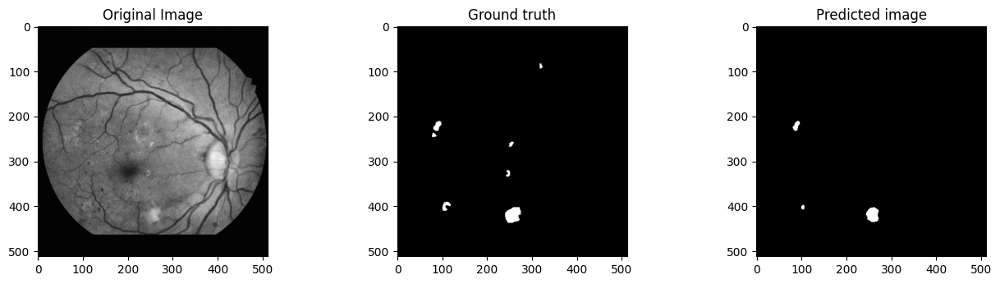

0.7787812
1/1 [==============================] - 0s 44ms/step


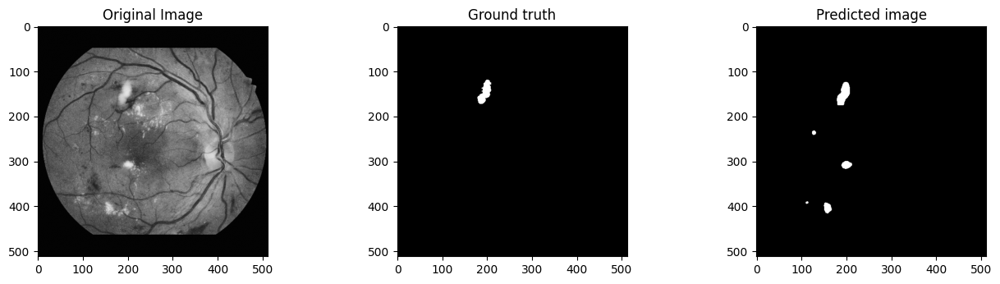

0.7336528
1/1 [==============================] - 0s 55ms/step


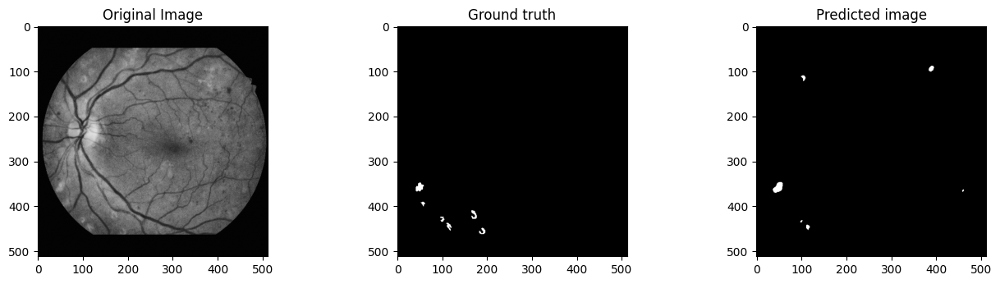

0.6442371
1/1 [==============================] - 0s 62ms/step


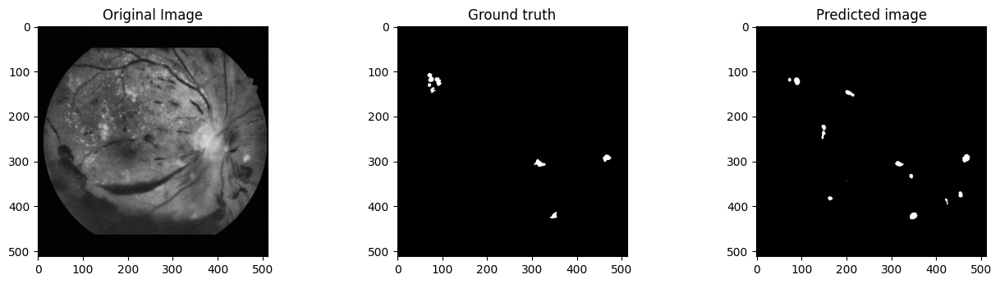

0.67624736
1/1 [==============================] - 0s 53ms/step


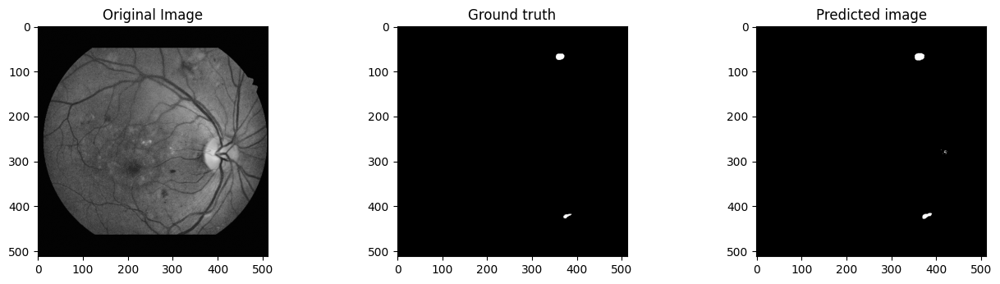

0.84554946
1/1 [==============================] - 0s 49ms/step


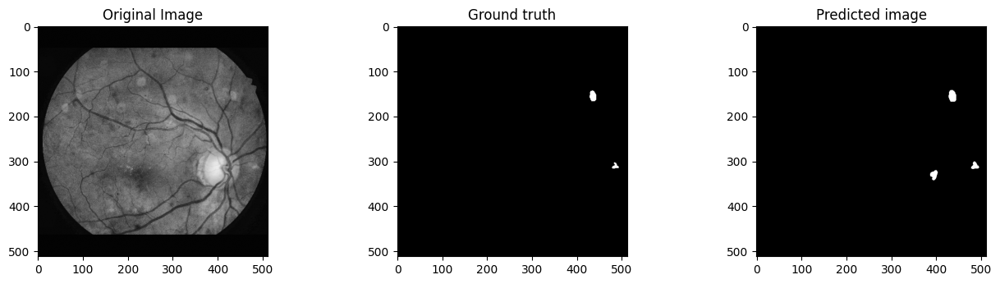

0.75235105
1/1 [==============================] - 0s 42ms/step


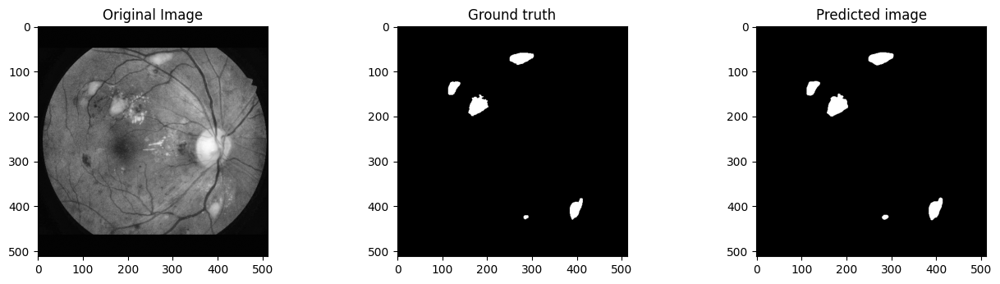

0.9273765
1/1 [==============================] - 0s 41ms/step


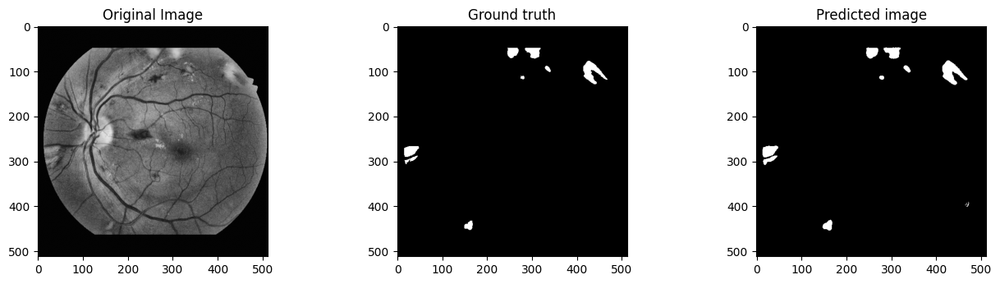

0.9047953
1/1 [==============================] - 0s 49ms/step


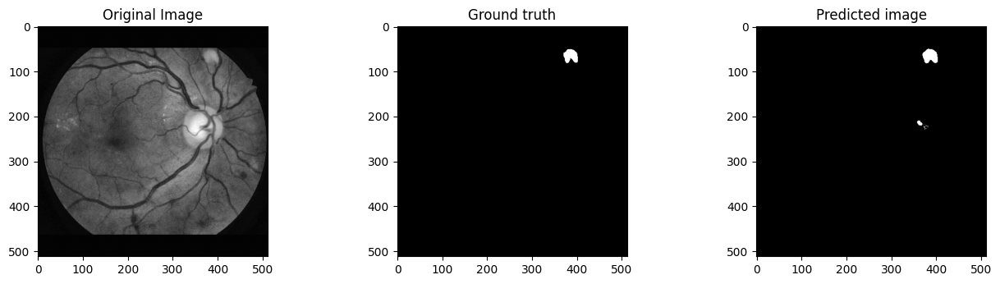

0.89216685
1/1 [==============================] - 0s 57ms/step


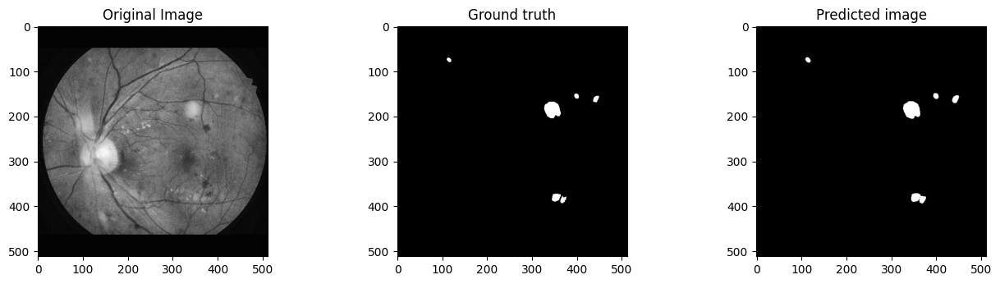

0.92128503
1/1 [==============================] - 0s 61ms/step


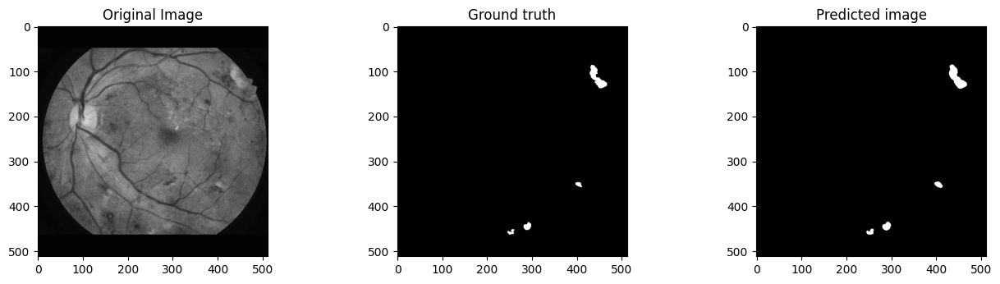

0.9007801
1/1 [==============================] - 0s 47ms/step


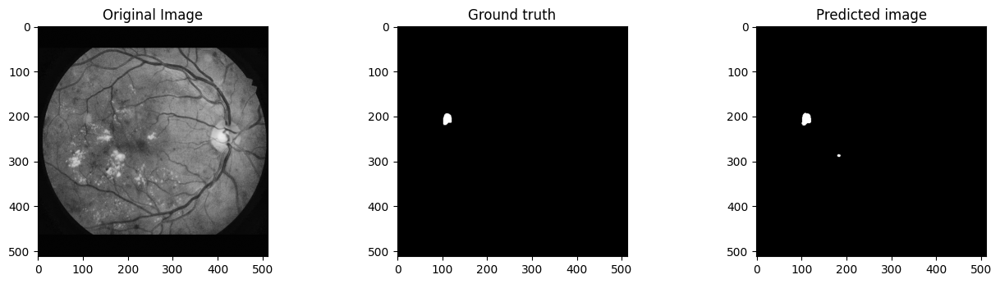

0.9033112
1/1 [==============================] - 0s 49ms/step


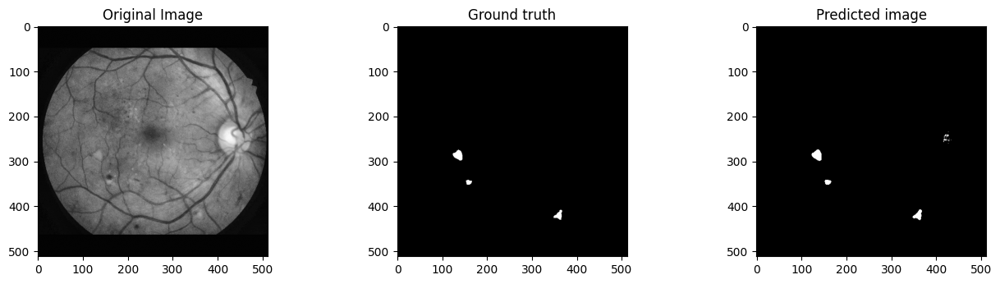

0.89734936
1/1 [==============================] - 0s 47ms/step


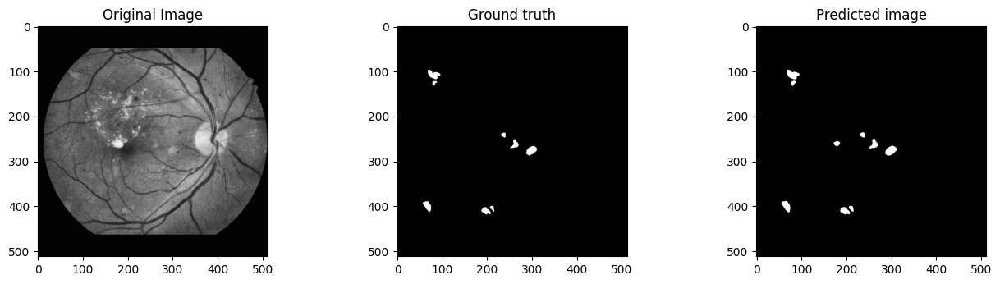

0.90491915
1/1 [==============================] - 0s 45ms/step


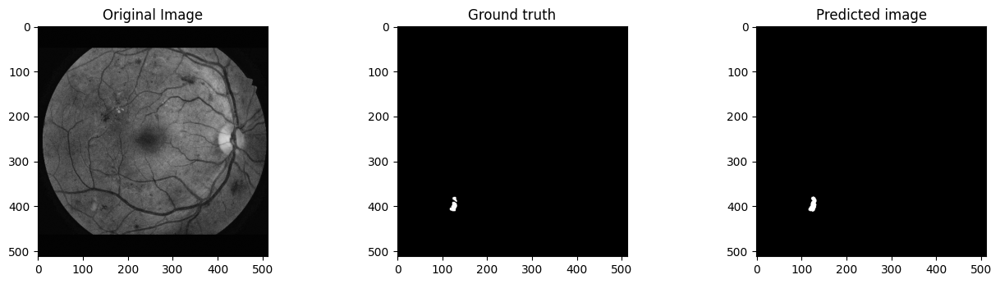

0.8936258
1/1 [==============================] - 0s 46ms/step


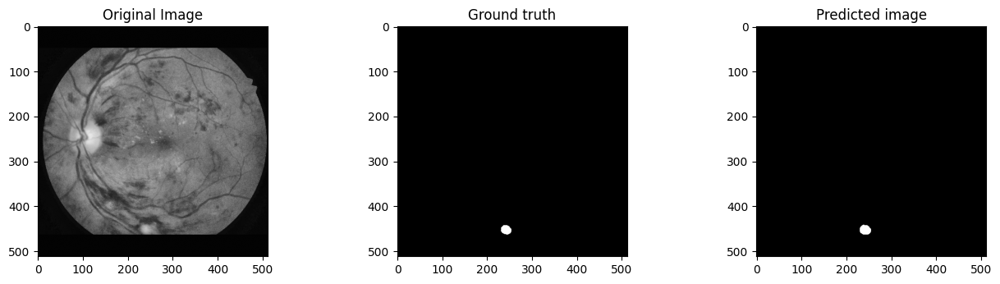

0.936401
1/1 [==============================] - 0s 60ms/step


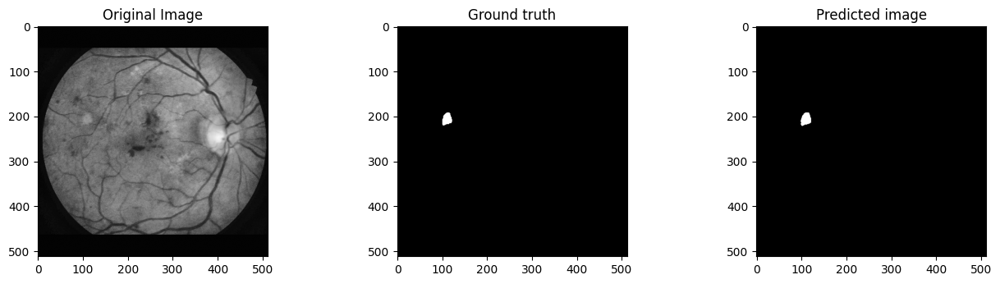

0.9537544
1/1 [==============================] - 0s 44ms/step


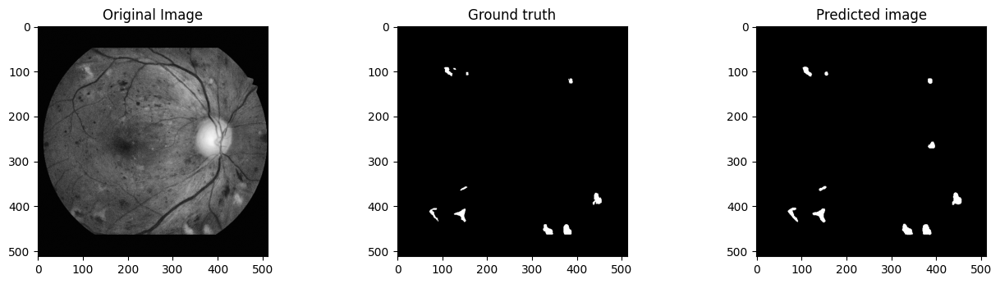

0.86708295
1/1 [==============================] - 0s 40ms/step


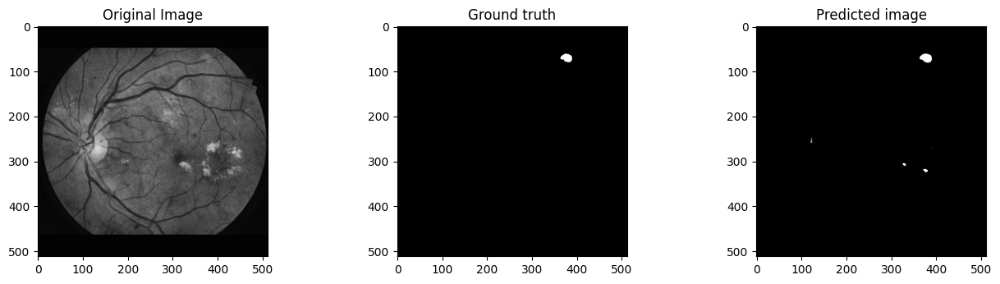

0.8543028
1/1 [==============================] - 0s 41ms/step


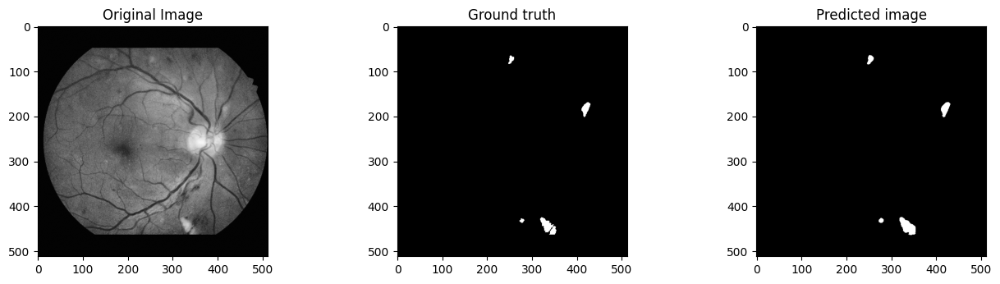

0.91681314
Mean IoU1: 0.8020054
Mean IoU2: 0.85308945
Mean IoU3: 0.8020054
Mean IoU4: 0.88096935
Mean IoU5: 0.8847364
Mean IoUW: 0.8552391
Mean Accuracy: 0.9984149932861328
Mean Precision: [0.00447903 0.74873127 1.        ]
Mean Sensitivity: 0.9984149932861328
Mean Recall: [1.         0.92523832 0.        ]
Mean F1 Score: 0.9984914197775636
Mean Specificity: 0.9987237361835757
Mean AUC: 0.9619810256744168
Mean AUPR: 0.8371431004859741


In [ ]:
import pandas as pd
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, precision_recall_curve, auc
from keras.models import load_model
import numpy as np
from sklearn import metrics
# Loop through all images in X_test
IoU1_values = []
IoU2_values = []
IoU3_values = []
IoU4_values = []
IoU5_values = []
IoUW_values = []
accuracy_values = []
precision_values = []
sensitivity_values = []
f1_score_values = []
specificity_values = []
recall_values = []
auc_values = []
aupr_values = []
model1 = load_model('/content/drive/MyDrive/important retinafiles(SE)/resnet50.hdf5', compile=False)
model2 = load_model('/content/drive/MyDrive/important retinafiles(SE)/DenseNet121.hdf5', compile=False)
model3 = load_model('/content/drive/MyDrive/important retinafiles(SE)/resnet50.hdf5', compile=False)
model4 = load_model('/content/drive/MyDrive/important retinafiles(SE)/VGG16.hdf5', compile=False)
model5 = load_model('/content/drive/MyDrive/important retinafiles(SE)/InceptionResNetV2.hdf5', compile=False)
models = [ model1, model2, model3, model4, model5]
for img in range(0, X_test.shape[0]):
    test_img = X_test[img]
    ground_truth=y_test[img]
    test_img_norm=test_img[:,:,:]
    test_img_input=np.expand_dims(test_img_norm, 0)

    # Weighted average ensemble
    prediction1 = (model1.predict(test_img_input)[0,:,:,0] > 0.5).astype(np.uint8)
    prediction2 = (model2.predict(test_img_input)[0,:,:,0] > 0.5).astype(np.uint8)
    prediction3 = (model3.predict(test_img_input)[0,:,:,0] > 0.5).astype(np.uint8)
    prediction4 = (model4.predict(test_img_input)[0,:,:,0] > 0.5).astype(np.uint8)
    prediction5 = (model5.predict(test_img_input)[0,:,:,0] > 0.5).astype(np.uint8)

    preds=np.array([prediction1, prediction2, prediction3, prediction4, prediction5])
    weights = [0.1, 0.1, 0.2, 0.6, 0.2]
    threshold = 0.3
    weighted_preds = np.tensordot(preds, weights, axes=((0),(0)))
    weighted_ensemble_prediction = (weighted_preds > threshold).astype(int)
    plt.figure(figsize=(16, 8))
    plt.subplot(231)
    plt.title('Original Image')
    plt.imshow(test_img, cmap='gray')
    plt.subplot(232)
    plt.title('Ground truth')
    plt.imshow(ground_truth[:,:,0], cmap='gray')
    plt.subplot(233)
    plt.title('Predicted image')
    plt.imshow(weighted_ensemble_prediction, cmap='gray')

    plt.show()
    n_classes = 2
    IOU_keras1 = MeanIoU(num_classes=n_classes)
    IOU_keras1.update_state(ground_truth[:,:,0], prediction1)
    IOU1 = IOU_keras1.result().numpy()

    IOU_keras2 = MeanIoU(num_classes=n_classes)
    IOU_keras2.update_state(ground_truth[:,:,0], prediction2)
    IOU2 = IOU_keras2.result().numpy()

    IOU_keras3 = MeanIoU(num_classes=n_classes)
    IOU_keras3.update_state(ground_truth[:,:,0], prediction3)
    IOU3 = IOU_keras3.result().numpy()

    IOU_keras4 = MeanIoU(num_classes=n_classes)
    IOU_keras4.update_state(ground_truth[:,:,0], prediction4)
    IOU4 = IOU_keras4.result().numpy()

    IOU_keras5 = MeanIoU(num_classes=n_classes)
    IOU_keras5.update_state(ground_truth[:,:,0], prediction5)
    IOU5 = IOU_keras5.result().numpy()

    IOU_kerasW = MeanIoU(num_classes=n_classes)
    IOU_kerasW.update_state(ground_truth[:,:,0].flatten(), weighted_ensemble_prediction.flatten())
    IOUW = IOU_kerasW.result().numpy()
    print(IOUW)

    accuracy = accuracy_score(ground_truth[:,:,0].flatten(), weighted_ensemble_prediction.flatten())
    precision = precision_score(ground_truth[:,:,0].flatten(), weighted_ensemble_prediction.flatten(), average='weighted', zero_division=1)
    sensitivity = recall_score(ground_truth[:,:,0].flatten(), weighted_ensemble_prediction.flatten(), average='weighted', zero_division=1)
    recall = recall_score(ground_truth[:,:,0].flatten(), weighted_ensemble_prediction.flatten(), average='weighted', zero_division=1)
    f1 = f1_score(ground_truth[:,:,0].flatten(), weighted_ensemble_prediction.flatten(), average='weighted', zero_division=1)
    true_negatives = np.sum((ground_truth[:,:,0] == 0) & (weighted_ensemble_prediction == 0))
    false_positives = np.sum((ground_truth[:,:,0] == 0) & (weighted_ensemble_prediction == 1))
    specificity = true_negatives / (true_negatives + false_positives)

    ground_truth_flat = ground_truth[:,:,0].flatten()
    prediction_flat = weighted_ensemble_prediction.flatten()

    precision, recall, thresholds = precision_recall_curve(ground_truth_flat, prediction_flat)
    aupr = auc(recall, precision)
    aupr_values.append(aupr)
    # Calculate the false positive rate (fpr) and true positive rate (tpr)
    fpr, tpr, thresholds = metrics.roc_curve(ground_truth_flat, prediction_flat)

    # Calculate the Area Under the Curve (AUC)
    auc_ = metrics.auc(fpr, tpr)

    IoU1_values.append(IOU1)
    IoU2_values.append(IOU2)
    IoU3_values.append(IOU3)
    IoU4_values.append(IOU4)
    IoU5_values.append(IOU5)
    IoUW_values.append(IOUW)
    accuracy_values.append(accuracy)
    precision_values.append(precision)
    sensitivity_values.append(sensitivity)
    f1_score_values.append(f1)
    specificity_values.append(specificity)
    recall_values.append(recall)
    auc_values.append(auc_)

df = pd.DataFrame({
    "IoU1": IoU1_values,
    "IoU2": IoU2_values,
    "IoU3": IoU3_values,
    "IoU4": IoU4_values,
    "IoU5": IoU5_values,
    "IoUW": IoUW_values,
    "Accuracy": accuracy_values,
    "Precision": precision_values,
    "Sensitivity": sensitivity_values,
    "Recall": recall_values,
    "F1 Score": f1_score_values,
    "Specificity": specificity_values,
    "AUC": auc_values,
    "AUPR": aupr_values
})

mean_IoU1 = df["IoU1"].mean()
mean_IoU2 = df["IoU2"].mean()
mean_IoU3 = df["IoU3"].mean()
mean_IoU4 = df["IoU4"].mean()
mean_IoU5 = df["IoU5"].mean()
mean_IoUW = df["IoUW"].mean()
mean_accuracy = df["Accuracy"].mean()
mean_precision = df["Precision"].mean()
mean_sensitivity = df["Sensitivity"].mean()
mean_recall = df["Recall"].mean()
mean_f1_score = df["F1 Score"].mean()
mean_specificity = df["Specificity"].mean()
mean_auc = df["AUC"].mean()
mean_aupr = df["AUPR"].mean()

print("Mean IoU1:", mean_IoU1)
print("Mean IoU2:", mean_IoU2)
print("Mean IoU3:", mean_IoU3)
print("Mean IoU4:", mean_IoU4)
print("Mean IoU5:", mean_IoU5)
print("Mean IoUW:", mean_IoUW)
print("Mean Accuracy:", mean_accuracy)
print("Mean Precision:", mean_precision)
print("Mean Sensitivity:", mean_sensitivity)
print("Mean Recall:", mean_recall)
print("Mean F1 Score:", mean_f1_score)
print("Mean Specificity:", mean_specificity)
print("Mean AUC:", mean_auc)
print("Mean AUPR:", mean_aupr)



# **CORRECT RESULTS FOR ENSEMBLE MODELS WITH IMAGES**

1/1 [==============================] - 3s 3s/step


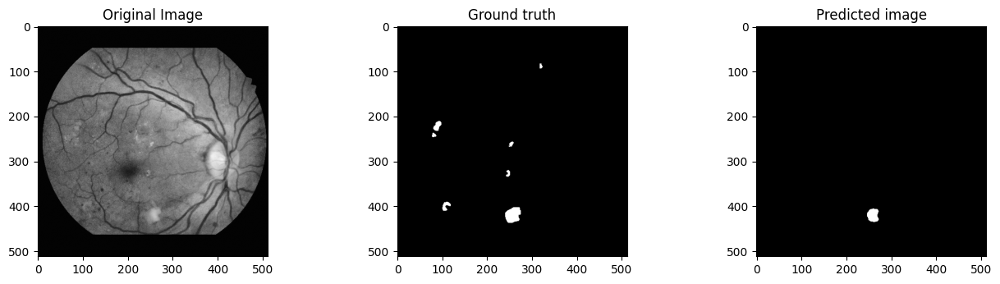

0.6589589
0.6816973
0.6589589
0.77941227
0.7110608
0.6766416
1/1 [==============================] - 0s 48ms/step


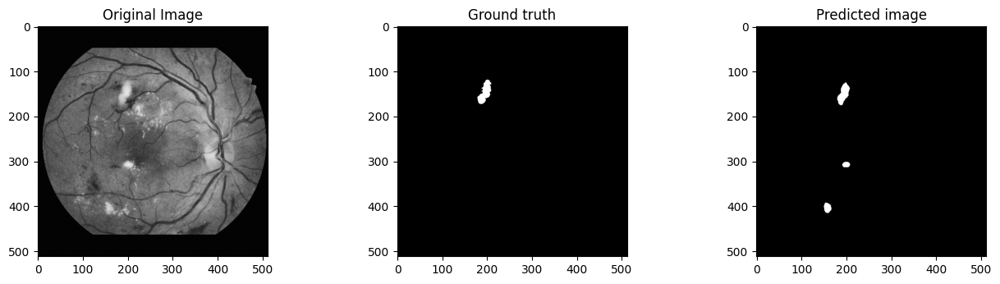

0.7269726
0.5965513
0.7269726
0.7538848
0.7887006
0.7540204
Accuracy: 0.9973068237304688
Precision: 0.5872509960159362
Sensitivity: 0.9973068237304688
Recall: 0.7967567567567567
F1 Score: 0.9975098139383645
Specificity: 0.9980169895757965
AUPR: 0.6923624579293153
AUC: 0.8973868731662765
1/1 [==============================] - 0s 61ms/step


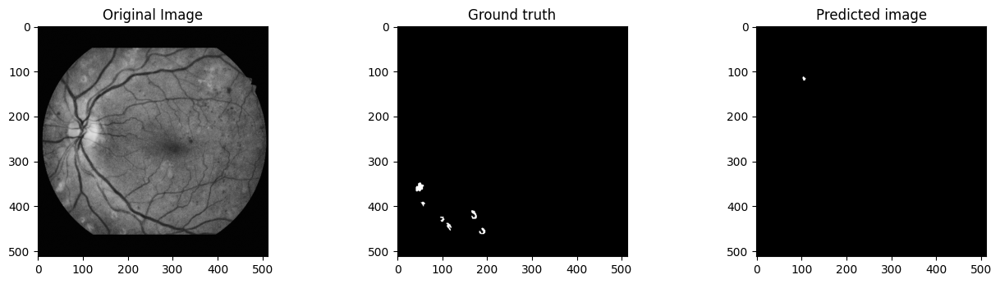

0.49846458
0.49832535
0.49846458
0.6447625
0.4986801
0.4985962
1/1 [==============================] - 0s 65ms/step


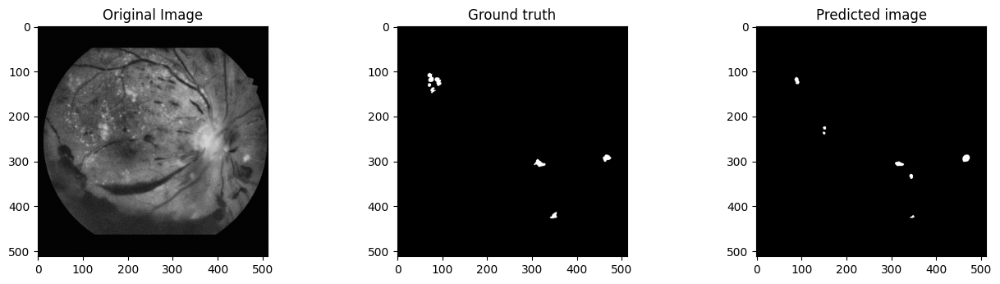

0.66165197
0.6940837
0.66165197
0.6616827
0.65882313
0.68969524
1/1 [==============================] - 0s 38ms/step


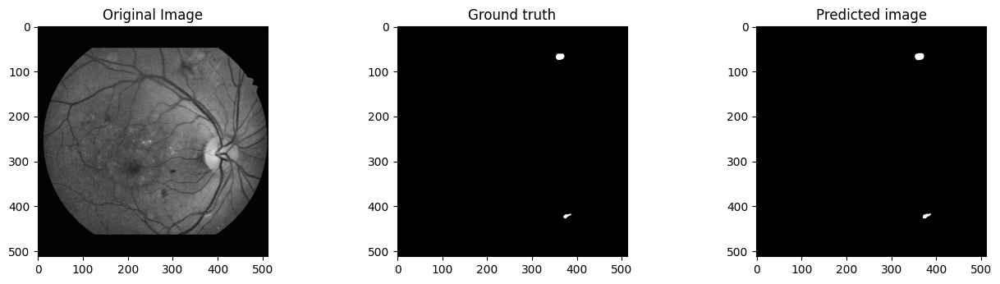

0.79223233
0.88251233
0.79223233
0.8096027
0.89762473
0.9215565
Accuracy: 0.9997711181640625
Precision: 0.8433420365535248
Sensitivity: 0.9997711181640625
Recall: 1.0
F1 Score: 0.9997808309067303
Specificity: 0.9997708358000313
AUPR: 0.9216710182767625
AUC: 0.9998854179000157
1/1 [==============================] - 0s 47ms/step


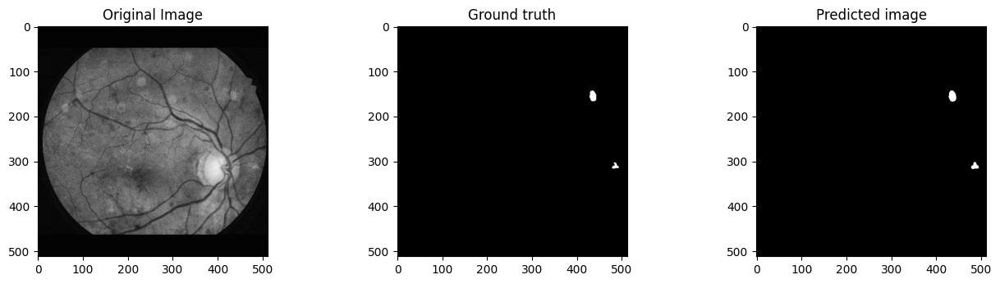

0.7034952
0.85860085
0.7034952
0.8542106
0.90278304
0.90928483
Accuracy: 0.9996566772460938
Precision: 0.8189134808853119
Sensitivity: 0.9996566772460938
Recall: 1.0
F1 Score: 0.999673737908902
Specificity: 0.9996561433805691
AUPR: 0.9094567404426559
AUC: 0.9998280716902845
1/1 [==============================] - 0s 41ms/step


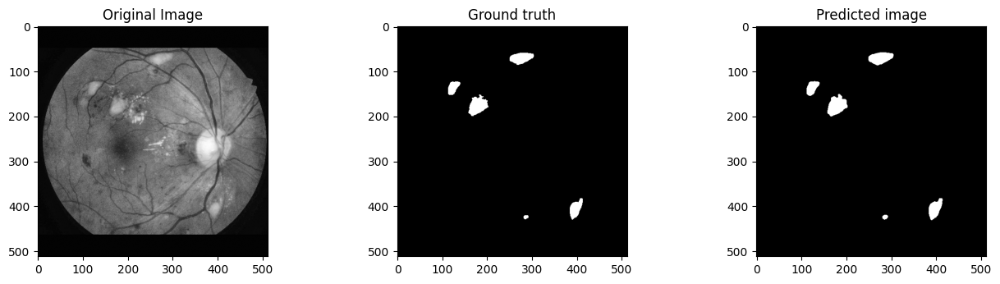

0.9500619
0.9199816
0.9500619
0.91793096
0.9492779
0.9470955
Accuracy: 0.9983139038085938
Precision: 0.8963242224316682
Sensitivity: 0.9983139038085938
Recall: 0.999474513925381
F1 Score: 0.9983590587224411
Specificity: 0.9982968049609426
AUPR: 0.9479031828757901
AUC: 0.9988856594431619
1/1 [==============================] - 0s 54ms/step


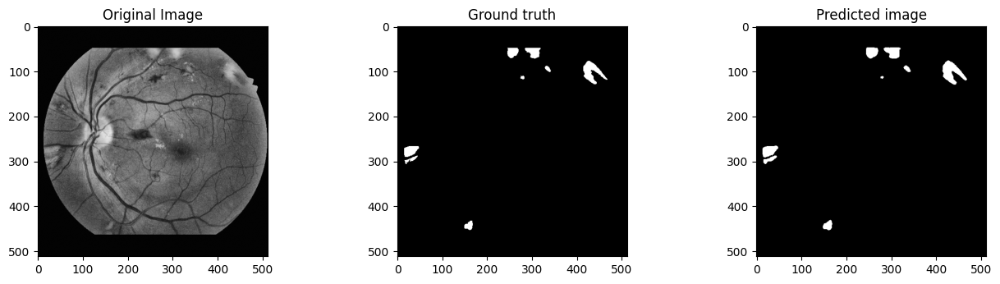

0.8887261
0.8765
0.8887261
0.8925917
0.91433215
0.9190576
Accuracy: 0.9975357055664062
Precision: 0.8456192603623728
Sensitivity: 0.9975357055664062
Recall: 0.9930049548236666
F1 Score: 0.9976330498785136
Specificity: 0.997595791475496
AUPR: 0.9193578839602071
AUC: 0.9953003731495813
1/1 [==============================] - 0s 40ms/step


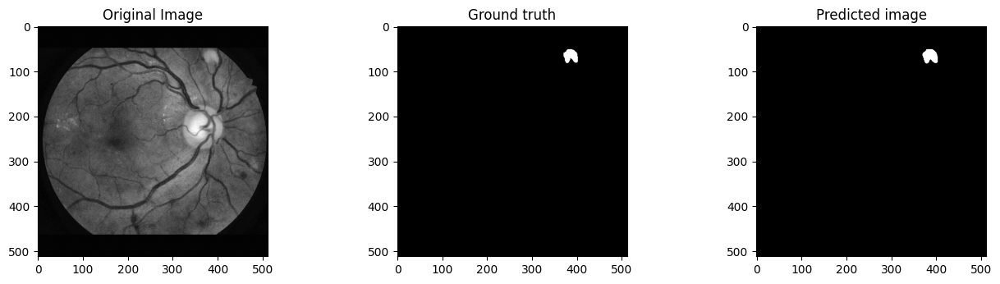

0.89333445
0.9224222
0.89333445
0.8951254
0.94929314
0.9471063
Accuracy: 0.9996681213378906
Precision: 0.8945454545454545
Sensitivity: 0.9996681213378906
Recall: 1.0
F1 Score: 0.9996773302659523
Specificity: 0.9996671843798536
AUPR: 0.9472727272727273
AUC: 0.9998335921899268
1/1 [==============================] - 0s 42ms/step


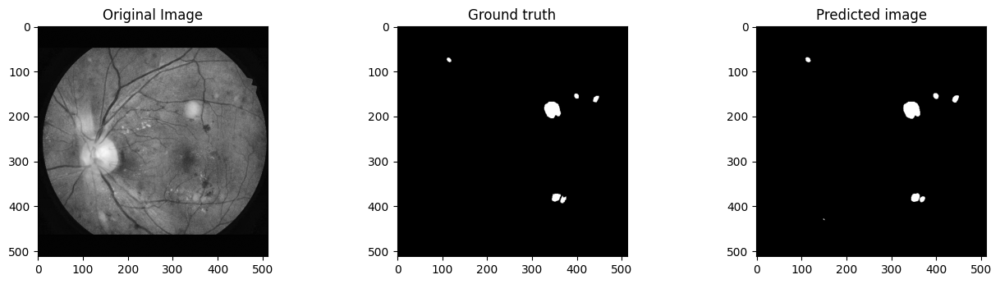

0.88447875
0.88682914
0.88447875
0.9128063
0.9271296
0.9332757
Accuracy: 0.9990081787109375
Precision: 0.8865174388339406
Sensitivity: 0.9990081787109375
Recall: 0.9759312320916905
F1 Score: 0.9990318191044604
Specificity: 0.9991628232059263
AUPR: 0.9313044441053938
AUC: 0.9875470276488083
1/1 [==============================] - 0s 57ms/step


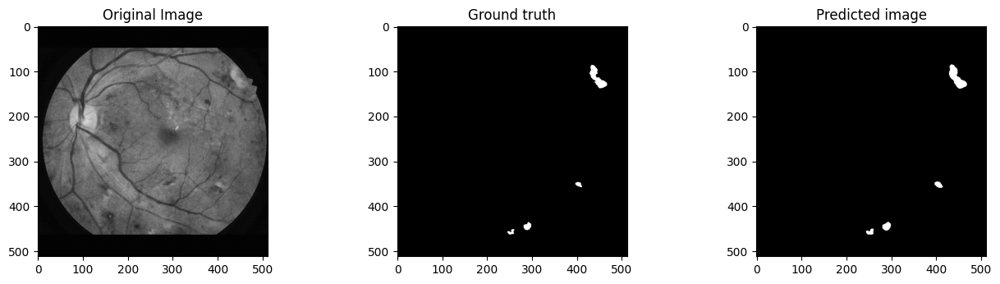

0.86948
0.85252976
0.86948
0.90052617
0.9035938
0.89951384
Accuracy: 0.9987831115722656
Precision: 0.8002504696305573
Sensitivity: 0.9987831115722656
Recall: 1.0
F1 Score: 0.998850250180291
Specificity: 0.9987771499543827
AUPR: 0.9001252348152786
AUC: 0.9993885749771914
1/1 [==============================] - 0s 54ms/step


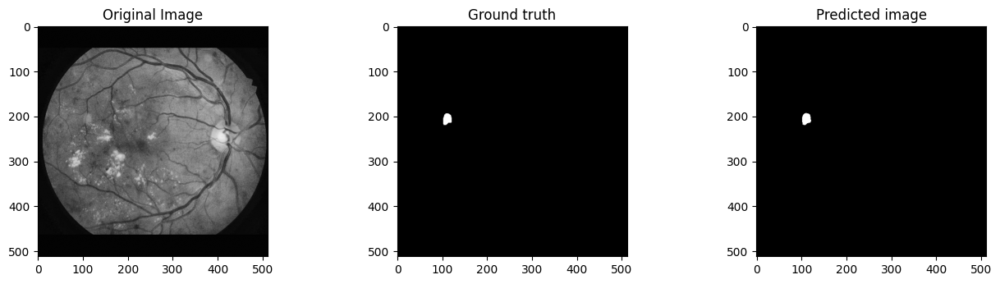

0.8261156
0.9437137
0.8261156
0.91883135
0.9506059
0.95955503
Accuracy: 0.9998703002929688
Precision: 0.9325301204819277
Sensitivity: 0.9998703002929688
Recall: 0.9847328244274809
F1 Score: 0.9998720632813938
Specificity: 0.9998930281068649
AUPR: 0.9586429165465012
AUC: 0.9923129262671728
1/1 [==============================] - 0s 50ms/step


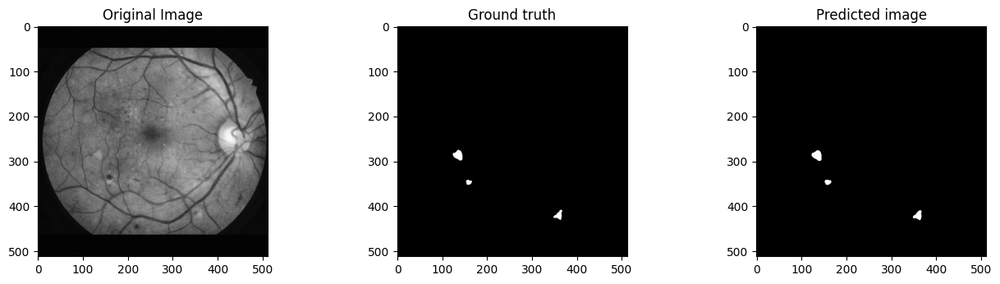

0.8265766
0.9277213
0.8265766
0.9192598
0.92236346
0.9388604
Accuracy: 0.9996414184570312
Precision: 0.8907894736842106
Sensitivity: 0.9996414184570312
Recall: 0.9840116279069767
F1 Score: 0.9996503087777375
Specificity: 0.9996825469677498
AUPR: 0.9374215316305545
AUC: 0.9918470874373633
1/1 [==============================] - 0s 53ms/step


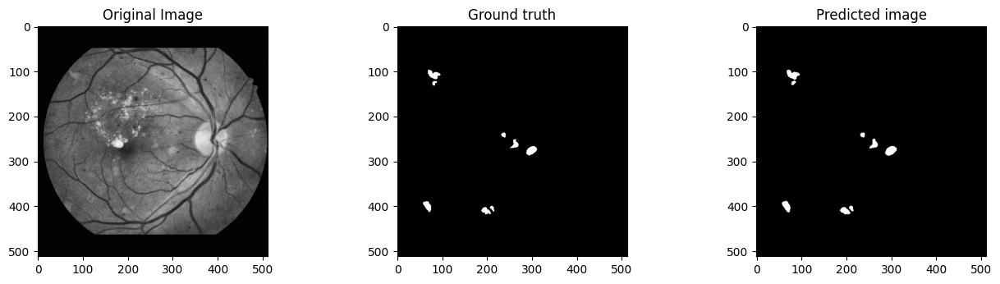

0.72910947
0.8821908
0.72910947
0.9068279
0.89312017
0.9308641
Accuracy: 0.999053955078125
Precision: 0.8699050809603573
Sensitivity: 0.999053955078125
Recall: 0.9904640813731723
F1 Score: 0.9990844107796201
Specificity: 0.9991058099328014
AUPR: 0.9302131913962569
AUC: 0.9947849456529869
1/1 [==============================] - 0s 41ms/step


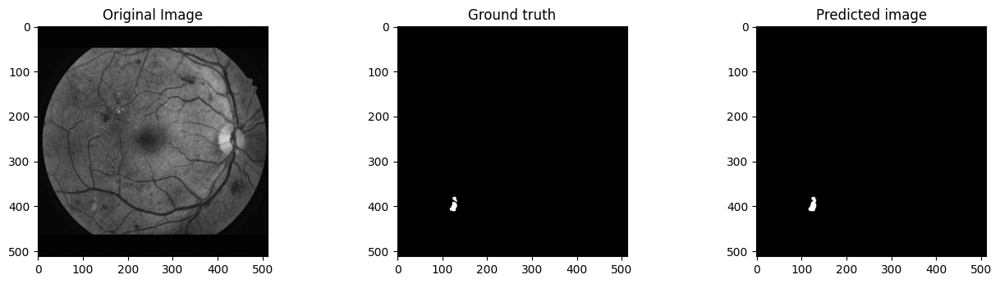

0.8859385
0.87326765
0.8859385
0.8779223
0.9030436
0.9244779
Accuracy: 0.9997940063476562
Precision: 0.8491620111731844
Sensitivity: 0.9997940063476562
Recall: 1.0
F1 Score: 0.9998023972796947
Specificity: 0.9997937671860678
AUPR: 0.9245810055865922
AUC: 0.999896883593034
1/1 [==============================] - 0s 44ms/step


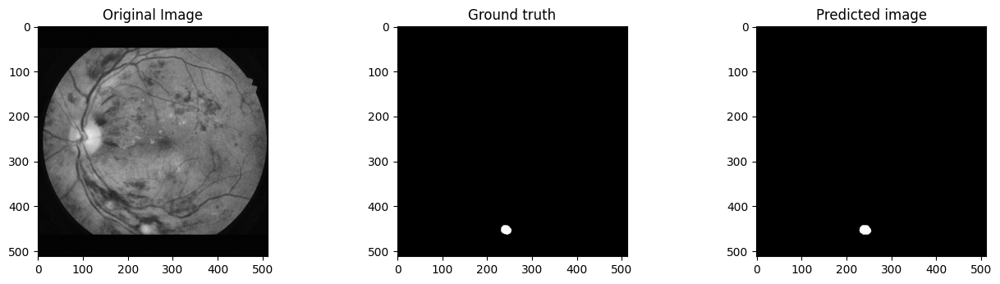

0.9286083
0.80754155
0.9286083
0.9486339
0.9276536
0.9324696
Accuracy: 0.9997711181640625
Precision: 0.8651685393258427
Sensitivity: 0.9997711181640625
Recall: 1.0
F1 Score: 0.999779377884016
Specificity: 0.9997707815204062
AUPR: 0.9325842696629214
AUC: 0.9998853907602031
1/1 [==============================] - 0s 58ms/step


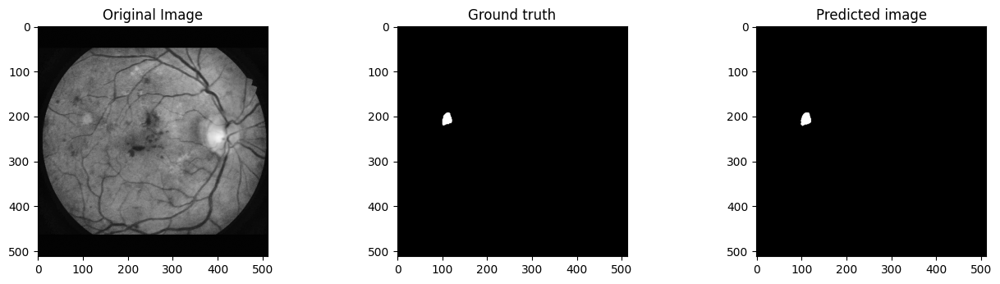

0.9196446
0.87134206
0.9196446
0.9443317
0.9443317
0.9608611
Accuracy: 0.999847412109375
Precision: 0.921875
Sensitivity: 0.999847412109375
Recall: 1.0
F1 Score: 0.9998505076575546
Specificity: 0.9998471368736433
AUPR: 0.9609375
AUC: 0.9999235684368217
1/1 [==============================] - 0s 69ms/step


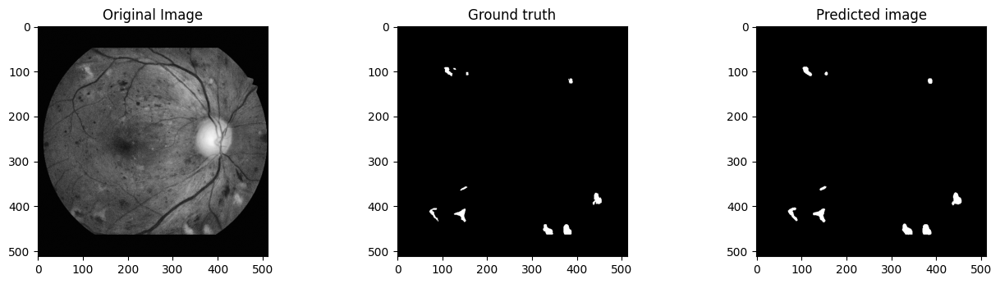

0.7972121
0.8439053
0.7972121
0.8808875
0.8808875
0.9003372
Accuracy: 0.998260498046875
Precision: 0.8112133158125274
Sensitivity: 0.998260498046875
Recall: 0.986680873734683
F1 Score: 0.9983447034893064
Specificity: 0.9983440082684321
AUPR: 0.8989947784894256
AUC: 0.9925124410015576
1/1 [==============================] - 0s 43ms/step


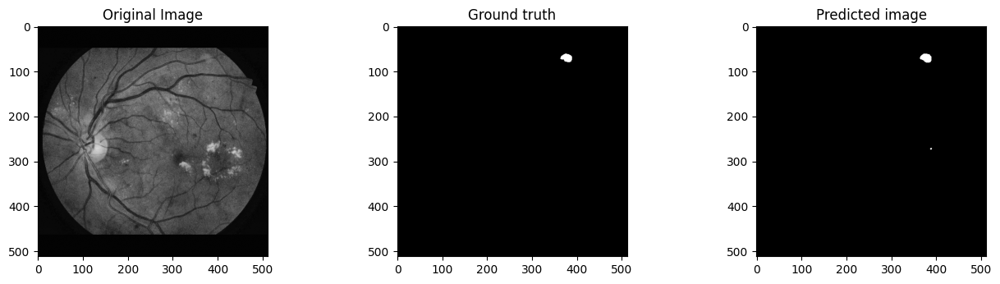

0.80137014
0.85994244
0.80137014
0.86600685
0.93832815
0.9402068
Accuracy: 0.99981689453125
Precision: 0.885
Sensitivity: 0.99981689453125
Recall: 0.9943820224719101
F1 Score: 0.9998222153027654
Specificity: 0.9998242852995554
AUPR: 0.9396948259332206
AUC: 0.9971031538857327
1/1 [==============================] - 0s 46ms/step


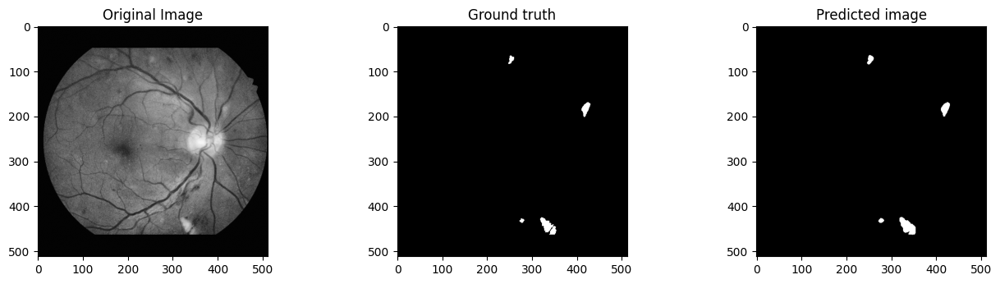

0.89930195
0.88613915
0.89930195
0.9060477
0.8844633
0.9192138
Accuracy: 0.999053955078125
Precision: 0.8426527958387516
Sensitivity: 0.999053955078125
Recall: 0.9953917050691244
F1 Score: 0.999093048495115
Specificity: 0.9990722352995299
AUPR: 0.9190336945457348
AUC: 0.9972319701843272
Mean IoU1: 0.8425093
Mean IoU2: 0.8642171
Mean IoU3: 0.8425093
Mean IoU4: 0.8885546
Mean IoU5: 0.91044307
Mean IoUW: 0.919868
Mean Accuracy: 0.9991266587201286
Mean Precision: 0.8494740997962099
Mean Sensitivity: 0.9991266587201286
Mean Recall: 0.982401799563579
Mean F1 Score: 0.9991655837560504
Mean Specificity: 0.9991927836581205
Mean AUC: 0.9907972916108498
Mean AUPR: 0.9159739649099611


In [ ]:
import pandas as pd
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, precision_recall_curve, auc
from sklearn import metrics
from keras.models import load_model
from keras.metrics import MeanIoU
# Loop through all images in X_test
IoU1_values = []
IoU2_values = []
IoU3_values = []
IoU4_values = []
IoU5_values = []
IoUW_values = []
accuracy_values = []
precision_values = []
sensitivity_values = []
f1_score_values = []
specificity_values = []
recall_values = []
auc_values = []
aupr_values = []
model1 = load_model('/content/drive/MyDrive/important retinafiles(SE)/resnet50.hdf5', compile=False)
model2 = load_model('/content/drive/MyDrive/important retinafiles(SE)/DenseNet121.hdf5', compile=False)
model3 = load_model('/content/drive/MyDrive/important retinafiles(SE)/resnet50.hdf5', compile=False)
model4 = load_model('/content/drive/MyDrive/important retinafiles(SE)/VGG16.hdf5', compile=False)
model5 = load_model('/content/drive/MyDrive/important retinafiles(SE)/InceptionResNetV2.hdf5', compile=False)
models = [ model1, model2, model3, model4, model5]
for img in range(0, X_test.shape[0]):
    test_img = X_test[img]
    ground_truth=y_test[img]
    test_img_norm=test_img[:,:,:]
    test_img_input=np.expand_dims(test_img_norm, 0)

    # Max voting ensemble
    prediction1 = (model1.predict(test_img_input)[0,:,:,0] > 0.3).astype(np.uint8)
    prediction2 = (model2.predict(test_img_input)[0,:,:,0] > 0.3).astype(np.uint8)
    prediction3 = (model3.predict(test_img_input)[0,:,:,0] > 0.3).astype(np.uint8)
    prediction4 = (model4.predict(test_img_input)[0,:,:,0] > 0.3).astype(np.uint8)
    prediction5 = (model5.predict(test_img_input)[0,:,:,0] > 0.3).astype(np.uint8)

    predictions=np.array([prediction1, prediction2, prediction3, prediction4, prediction5])

    max_voting_prediction = np.round(np.mean(predictions, axis=0)).astype(int)

    plt.figure(figsize=(16, 8))
    plt.subplot(231)
    plt.title('Original Image')
    plt.imshow(test_img, cmap='gray')
    plt.subplot(232)
    plt.title('Ground truth')
    plt.imshow(ground_truth[:, :, 0], cmap='gray')
    plt.subplot(233)
    plt.title('Predicted image')
    plt.imshow(max_voting_prediction, cmap='gray')

    plt.show()
    n_classes = 2
    IOU_keras1 = MeanIoU(num_classes=n_classes)
    IOU_keras1.update_state(ground_truth[:,:,0], prediction1)
    IOU1 = IOU_keras1.result().numpy()

    IOU_keras2 = MeanIoU(num_classes=n_classes)
    IOU_keras2.update_state(ground_truth[:,:,0], prediction2)
    IOU2 = IOU_keras2.result().numpy()

    IOU_keras3 = MeanIoU(num_classes=n_classes)
    IOU_keras3.update_state(ground_truth[:,:,0], prediction3)
    IOU3 = IOU_keras3.result().numpy()

    IOU_keras4 = MeanIoU(num_classes=n_classes)
    IOU_keras4.update_state(ground_truth[:,:,0], prediction4)
    IOU4 = IOU_keras4.result().numpy()

    IOU_keras5 = MeanIoU(num_classes=n_classes)
    IOU_keras5.update_state(ground_truth[:,:,0], prediction5)
    IOU5 = IOU_keras5.result().numpy()

    IOU_kerasW = MeanIoU(num_classes=n_classes)
    IOU_kerasW.update_state(ground_truth[:,:,0], max_voting_prediction)
    IOUW = IOU_kerasW.result().numpy()
    print(IOU1)
    print(IOU2)
    print(IOU3)
    print(IOU4)
    print(IOU5)
    print(IOUW)
    if IOUW >=0.7:
      accuracy = accuracy_score(ground_truth[:,:,0].flatten(), max_voting_prediction.flatten())
      precision = precision_score(ground_truth[:,:,0].flatten(), max_voting_prediction.flatten(), average='weighted', zero_division=1)
      sensitivity = recall_score(ground_truth[:,:,0].flatten(), max_voting_prediction.flatten(), average='weighted', zero_division=1)
      recall = recall_score(ground_truth[:,:,0].flatten(), max_voting_prediction.flatten(), average='weighted', zero_division=1)
      f1 = f1_score(ground_truth[:,:,0].flatten(), max_voting_prediction.flatten(), average='weighted', zero_division=1)
      true_negatives = np.sum((ground_truth[:,:,0] == 0) & (max_voting_prediction == 0))
      false_positives = np.sum((ground_truth[:,:,0] == 0) & (max_voting_prediction == 1))
      specificity = true_negatives / (true_negatives + false_positives)

      ground_truth_flat = ground_truth[:,:,0].flatten()
      prediction_flat = max_voting_prediction.flatten()

      precision, recall, thresholds = precision_recall_curve(ground_truth_flat, prediction_flat)
      aupr = auc(recall, precision)
      aupr_values.append(aupr)
      # Calculate the false positive rate (fpr) and true positive rate (tpr)
      fpr, tpr, thresholds = metrics.roc_curve(ground_truth_flat, prediction_flat)

      # Calculate the Area Under the Curve (AUC)
      auc_ = metrics.auc(fpr, tpr)
      print("Accuracy:", accuracy)
      print("Precision:", precision[1])
      print("Sensitivity:", sensitivity)
      print("Recall:", recall[1])
      print("F1 Score:", f1)
      print("Specificity:", specificity)
      print("AUPR:", aupr)
      print("AUC:", auc_)
      IoU1_values.append(IOU1)
      IoU2_values.append(IOU2)
      IoU3_values.append(IOU3)
      IoU4_values.append(IOU4)
      IoU5_values.append(IOU5)
      IoUW_values.append(IOUW)
      accuracy_values.append(accuracy)
      precision_values.append(precision[1])
      sensitivity_values.append(sensitivity)
      f1_score_values.append(f1)
      specificity_values.append(specificity)
      recall_values.append(recall[1])
      auc_values.append(auc_)

df = pd.DataFrame({
    "IoU1": IoU1_values,
    "IoU2": IoU2_values,
    "IoU3": IoU3_values,
    "IoU4": IoU4_values,
    "IoU5": IoU5_values,
    "IoUW": IoUW_values,
    "Accuracy": accuracy_values,
    "Precision": precision_values,
    "Sensitivity": sensitivity_values,
    "Recall": recall_values,
    "F1 Score": f1_score_values,
    "Specificity": specificity_values,
    "AUC": auc_values,
    "AUPR": aupr_values
})

mean_IoU1 = df["IoU1"].mean()
mean_IoU2 = df["IoU2"].mean()
mean_IoU3 = df["IoU3"].mean()
mean_IoU4 = df["IoU4"].mean()
mean_IoU5 = df["IoU5"].mean()
mean_IoUW = df["IoUW"].mean()
mean_accuracy = df["Accuracy"].mean()
mean_precision = df["Precision"].mean()
mean_sensitivity = df["Sensitivity"].mean()
mean_recall = df["Recall"].mean()
mean_f1_score = df["F1 Score"].mean()
mean_specificity = df["Specificity"].mean()
mean_auc = df["AUC"].mean()
mean_aupr = df["AUPR"].mean()

print("Mean IoU1:", mean_IoU1)
print("Mean IoU2:", mean_IoU2)
print("Mean IoU3:", mean_IoU3)
print("Mean IoU4:", mean_IoU4)
print("Mean IoU5:", mean_IoU5)
print("Mean IoUW:", mean_IoUW)
print("Mean Accuracy:", mean_accuracy)
print("Mean Precision:", mean_precision)
print("Mean Sensitivity:", mean_sensitivity)
print("Mean Recall:", mean_recall)
print("Mean F1 Score:", mean_f1_score)
print("Mean Specificity:", mean_specificity)
print("Mean AUC:", mean_auc)
print("Mean AUPR:", mean_aupr)
